## COMP5328 - Advanced Machine Learning
## Assignment 1: Non-negative Matrix Factorization
----------------------------------------------------------------------------------------
### Authors - Pooja Vijay Mahajan(510282930) & Tulika Shrivastava (500657898)

**(Semester 2, 2021)**

In this ipython notebook, we provide some example code for assignment1.
+ Load Data.
    - ORL dataset. 
    - Extended YaleB dataset. 
    - AR dataset (**optional**).
+ Perform Evaluation. 
   - Relative Reconstruction Errors.
   - Accuracy, NMI (**optional**).

Lecturer: Tongliang Liu.

Tutors: Songhua Wu, Yu Yao, Jeremy Gillen, Shijun Cai, Vinoth Nandakumar, Zhen Wang

**Note: All datasets can be used only for this assignment and you are not allowed to distribute these datasets. If you want to use AR dataset, you need to apply it by yourself (we do not provide AR dataset due to the problem of license, please find more details in http://www2.ece.ohio-state.edu/~aleix/ARdatabase.html).**

**Note**: Some of the code given as the template code for Assignment 1 has been rearranged to used it through a class or keep them in a common section. Some of the unused part has been removed.

## 1. Load Dataset

### 1.0 Data Folder

In [5]:
# SET THE ROOT PATH HERE
DATASET_ROOT_PATH_ORL = "../data/ORL"
DATASET_ROOT_PATH_YaleB = "../data/CroppedYaleB"

In [6]:
import matplotlib.pyplot as plt
from numpy import clip
from collections import Counter
from sklearn.cluster import KMeans
from sklearn.metrics import accuracy_score
from sklearn.metrics import normalized_mutual_info_score
import os
import numpy as np
from PIL import Image
from numpy.random import default_rng
import sys
import traceback
import math

### 1.1 Load ORL Dataset and Extended YaleB Dataset.
+ ORL dataset contains ten different images of each of 40 distinct subjects. For some subjects, the images were taken at different times, varying the lighting, facial expressions (open / closed eyes, smiling / not smiling) and facial details (glasses / no glasses). All the images were taken against a dark homogeneous background with the subjects in an upright, frontal position (with tolerance for some side movement). The size of each image is 92x112 pixels, with 256 grey levels per pixel. To further reduce the computation complexity, you can resize all images to 30x37 pixels.

+ Extended YaleB dataset contains 2414 images of 38 human subjects under 9 poses and 64 illumination conditions. All images are manually aligned, cropped, and then resized to 168x192 pixels. To further reduce the computation complexity, you can resize all images to 42x48 pixels.

In [7]:
def load_data(root, reduce, image_size):
    """ 
    Load ORL (or Extended YaleB) dataset to numpy array.
    
    Args:
        root: path to dataset.
        reduce: scale factor for zooming out images.
        image_size: tuple having width and height for image resizing
        
    """ 
    try:
        images, labels = [], []

        for i, person in enumerate(sorted(os.listdir(root))):

            if not os.path.isdir(os.path.join(root, person)):
                continue

            for fname in os.listdir(os.path.join(root, person)):    

                # Remove background images in Extended YaleB dataset.
                if fname.endswith('Ambient.pgm'):
                    continue

                if not fname.endswith('.pgm'):
                    continue

                # load image.
                img = Image.open(os.path.join(root, person, fname))
                img = img.convert('L') # grey image.
                # reduce computation complexity.
                #img = img.resize([s//reduce for s in img.size])
                img = img.resize(image_size)

                # convert image to numpy array.
                img = np.asarray(img).reshape((-1,1))

                # collect data and label.
                images.append(img)

                labels.append(i)

        # concate all images and labels.
        images = np.concatenate(images, axis=1)

        labels = np.array(labels)
        return images, labels
    
    except: 
        traceback.print_exception(*sys.exc_info())
            
# https://www.geeksforgeeks.org/how-to-print-exception-stack-trace-in-python/

In [8]:
REDUCED_IMAGE_SIZE_ORL = (30, 37)
REDUCED_IMAGE_SIZE_YALEB = (42, 48)

COEFFICIENT_SIZE_ORL = (18, 20)
COEFFICIENT_SIZE_YALEB = (41, 53)

In [9]:
# Reduce is set to 1 so that the images can be resized based on the appropriate size passed to the function
# Load ORL dataset. 
X_ORL, Y_ORL = load_data(root=DATASET_ROOT_PATH_ORL, reduce=1, image_size=REDUCED_IMAGE_SIZE_ORL)
print('ORL dataset: X_ORL.shape = {}, Y_ORL.shape = {}'.format(X_ORL.shape, Y_ORL.shape))

ORL dataset: X_ORL.shape = (1110, 400), Y_ORL.shape = (400,)


In [10]:
# Load Extended YaleB dataset.
X_YaleB, Y_YaleB = load_data(root=DATASET_ROOT_PATH_YaleB, reduce=1, image_size=REDUCED_IMAGE_SIZE_YALEB)
print('Extended YalB dataset: X_YaleB.shape = {}, Y_YaleB.shape = {}'.format(X_YaleB.shape, Y_YaleB.shape))

Extended YalB dataset: X_YaleB.shape = (2016, 2414), Y_YaleB.shape = (2414,)


### 1.2 Load AR Dataset (Optional) 
AR dataset contains 2600 images of 100 individuals (50 male and 50 female). All images have been cropped and resized to 120x165 pixels. To further reduce the computation complexity, you can resize all images to 40x55 pixels.

In [11]:
def load_data_AR(root='data/CroppedAR', reduce=3):
    """ 
    Load AR dataset to numpy array.
    
    Args:
        root: path to AR dataset.
        reduce: scale factor for zooming out images.
        
    """ 
    images, labels = [], []
    
    for fname in os.listdir(root):
        
        if not fname.endswith('.bmp'):
            continue
        
        # get label.
        label = int(fname[2:5])
        if fname[0] == 'W': # start from 50
            label += 50
        
        # load image.
        img = Image.open(os.path.join(root, fname))
        img = img.convert('L') # grey
        
        # reduce computation complexity.
        img = img.resize([s//reduce for s in img.size])
   
        # TODO: preprocessing.
        
        # convert image to numpy array.
        img = np.asarray(img).reshape((-1,1))
        
        # collect data and label.
        images.append(img)
        labels.append(label)
        
    # concate all images and labels.
    images = np.concatenate(images, axis=1)
    labels = np.array(labels)
    
    return images, labels

In [12]:
# X, Y = load_data_AR(root='data/CroppedAR', reduce=3)
# print('AR dataset: X.shape = {}, Y.shape = {}'.format(X.shape, Y.shape))

---------------------------


### 1.3 Initial Data Analysis 
Functions for Initial data analysis 

In [13]:
def get_label_count(dataset):
    """
    This method return the unique labels and its count for the dataset passed to it.
    
    param type: array
    param dataset: Dataset containing the labels

    type output: tuple
    output: tuple containing the unique labels and its count (labels, count).
    """
    try:
        (labels, count) = np.unique(dataset, return_counts = True)
        return (labels, count)
        
    except: 
        traceback.print_exception(*sys.exc_info())

#https://numpy.org/doc/stable/reference/generated/numpy.unique.html

In [14]:
def plot_bar_graph(labels, count, x_label, y_label, title, width = 0.65):
    """
    This method plots the bar graph based on the data passed to it. 
    
    param type: array
    param label: Data to plot on X axis
    
    param type: array
    param count: Data to plot on Y axis
    
    param type: string
    param x_label: label for x axis

    param type: string
    param y_label: label for y axis

    param type: decimal
    param y_label: width of the bar

    param type: string
    param title: label for title
    """
    try:
        fig = plt.figure(figsize=(16, 8))
        ax = fig.subplots()
        container = ax.bar(labels, count, width)
        ax.set_xlabel(x_label)
        ax.set_ylabel(y_label)
        ax.set_title(title)
        ax.set_xticks(labels)
        ax.bar_label(container)
        plt.show()
        
    except: 
        traceback.print_exception(*sys.exc_info())

#https://matplotlib.org/stable/gallery/lines_bars_and_markers/bar_label_demo.html

In [15]:
def display_image(plt, data, image_size, title):
    """
    This method plots the image based on the data and title passed to it. 
    
    param type: pyplot
    param plt: pyplot object
    
    param type: array
    param data: Data to plot the image from
    
    param type: tuple
    param image_size: default size of the image

    param type: string
    param title: label for title
    """
    try:
        plt.imshow(data.reshape(image_size[1], image_size[0]), cmap = plt.cm.gray) 
        plt.axis('off')
        plt.title(title)
        
    except: 
        traceback.print_exception(*sys.exc_info())
  

In [16]:
def display_images(dataset, image_index, image_size, title):
    """
    This method plots the image based on the data and index passed to it. 
    
    param type: array
    param dataset: Data to plot the image from
    
    param type: array
    param image_index: Random index of images to be plotted 
    
    param type: tuple
    param image_size: default size of the image

    param type: string
    param title: label for title
    """
    try:
        plt.figure(figsize=(20, 2))
        fig = plt.gcf()
        fig.suptitle(title, y = 1.25)  
        num_of_images = len(image_index) 
        for index in range(num_of_images):
            plt.subplot(1, num_of_images, index + 1)
            display_image(plt, dataset[:,image_index[index]], image_size, "img:" + str(image_index[index]))
        plt.show()
        
    except: 
        traceback.print_exception(*sys.exc_info())
#https://stackoverflow.com/questions/7526625/matplotlib-global-legend-and-title-aside-subplots

In [17]:
def plot_image_comparison(original, noisy, reconstructed, image_size, title, img_name = None, save_image = False):
    """
    This method plots the original, noisy and reconstructed image. 
    
    param type: array
    param original: Array of orignal image pixels for a given image
    
    param type: array
    param noisy: Array of noisy image pixels for a given image
    
    param type: array
    param reconstructed: Array of reconstructed image pixels for a given image

    param type: tuple
    param image_size: default size of the image

    param type: string
    param title: label for title
    
    param type: string
    param img_name: Name of the image to save in a file
    
    param type: boolean
    param save_image: Flag to indicate if the image should be saved in the file
    """
    try:
        if reconstructed is not None:
            plt.figure(figsize = (10, 3))
        else:
            plt.figure(figsize = (10, 2))

        fig = plt.gcf()
        fig.suptitle(title, y = 1.1) 

        plt.subplot(131)
        display_image(plt, original, image_size, "Image(Original)")

        plt.subplot(132)
        display_image(plt, noisy, image_size, "Image(Noisy)")

        if reconstructed is not None:
            plt.subplot(133)
            display_image(plt, reconstructed, image_size, "Image(Reconstructed)")
        
        if save_image == True:
            plt.savefig("result/" + img_name + ".png")
            
        plt.show()
        
    except: 
        traceback.print_exception(*sys.exc_info())
        
    #https://stackoverflow.com/questions/7526625/matplotlib-global-legend-and-title-aside-subplots

In [18]:
def plot_basis_coefficient(D, R, D_image_size, R_image_size, img_name = None, save_image = False):
    """
    This method plots the basis and the coefficient matrix. 
    
    param type: array
    param D: Array containing learned basis
    
    param type: array
    param R: Array containing learned coefficient

    param type: tuple
    param D_image_size: default size of the image for basis matrix
    
    param type: tuple
    param R_image_size: size of the image for coefficient matrix
    
    param type: string
    param img_name: Name of the image to save in a file
    
    param type: boolean
    param save_image: Flag to indicate if the image should be saved in the file
    """
    try:
        subplots_len = D.shape[1]
        if subplots_len > 30:
            subplots_len = 30
        subplots_row = math.ceil(subplots_len / 5)
       
        if subplots_len >= 5:
            subplots_col = 5
        else:
            subplots_col = subplots_len
            
        fig, ax = plt.subplots(subplots_row, subplots_col, figsize = (10, 10),
                               gridspec_kw={"wspace":0, "hspace":0})
        fig.suptitle("Basis matrix", y = 0.94) 
        image_index = 0
        for i in range(subplots_row):
            for j in range(subplots_col):  
                if subplots_row > 1:
                    ax[i, j].imshow(D[:, image_index].reshape(D_image_size[1], D_image_size[0]), 
                                    cmap = plt.cm.gray, aspect = "auto") 
                    ax[i, j].axis('off')
                else:
                    ax[j].imshow(D[:, image_index].reshape(D_image_size[1], D_image_size[0]), cmap = plt.cm.gray) 
                    ax[j].axis('off')
                image_index += 1
                if image_index >= subplots_len:
                    break
            
                #ax[0, index].set_title("Basis:" + str(index + 1))

                #ax[1, index].imshow(R[index, :].reshape(R_image_size[1], R_image_size[0]), cmap = plt.cm.gray) 
                #ax[1, index].axis('off')
                #ax[1, index].set_title("Coefficient:" + str(index + 1))
        if save_image == True:
            plt.savefig("result/" + img_name + ".png")
        plt.show()
    except: 
        traceback.print_exception(*sys.exc_info())
        
# https://stackoverflow.com/questions/37973674/matplotlib-pyplot-imshow-tight-spacing-between-images

#### 1.3.1 Initial Data analysis for ORL dataset

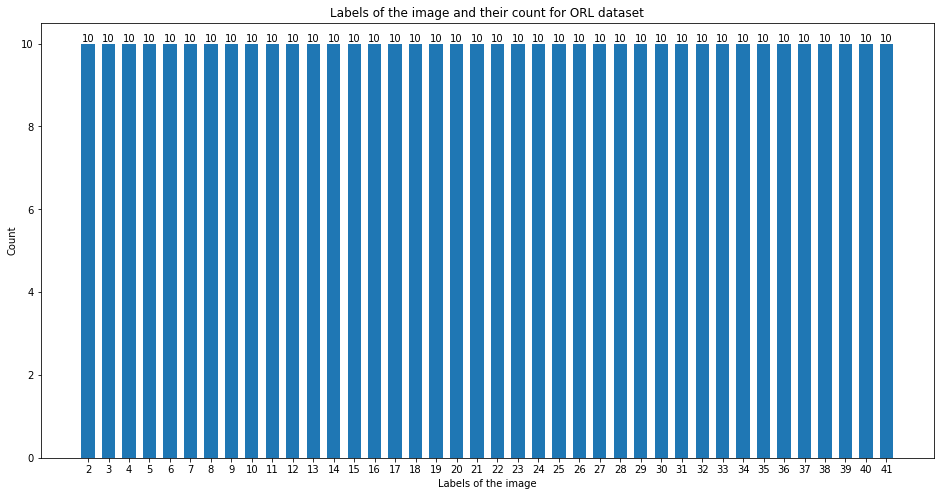

In [19]:
# Understand the distribution of the labels for the images from ORL dataset
labels_ORL, count_ORL = get_label_count(Y_ORL)
plot_bar_graph(labels_ORL, count_ORL, "Labels of the image", "Count", "Labels of the image and their count for ORL dataset")

In [20]:
#Number of labels and images
print("Number of labels:", len(labels_ORL))
print("Number of images:", X_ORL.shape[1])
print("Number of pixels in each image:", X_ORL.shape[0])
print("Shape of ORL dataset:", X_ORL.shape)
print("Shape of ORL labels:", Y_ORL.shape)
print("Minimum pixel value: {0}, Maximum pixel value:{1}".format(X_ORL.min(), X_ORL.max()))


Number of labels: 40
Number of images: 400
Number of pixels in each image: 1110
Shape of ORL dataset: (1110, 400)
Shape of ORL labels: (400,)
Minimum pixel value: 9, Maximum pixel value:228


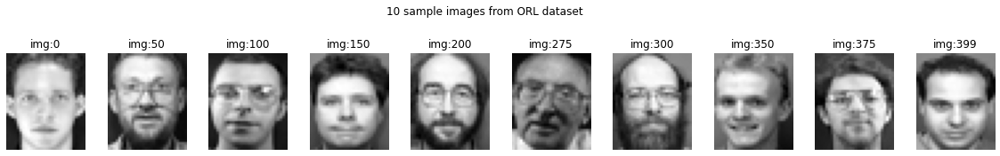

In [21]:
# Explore few sample images 
image_index_ORL = [0, 50, 100, 150, 200, 275, 300, 350, 375, 399]
display_images(X_ORL, image_index_ORL, REDUCED_IMAGE_SIZE_ORL, "10 sample images from ORL dataset")  

#### 1.3.2 Initial Data analysis for YaleB dataset

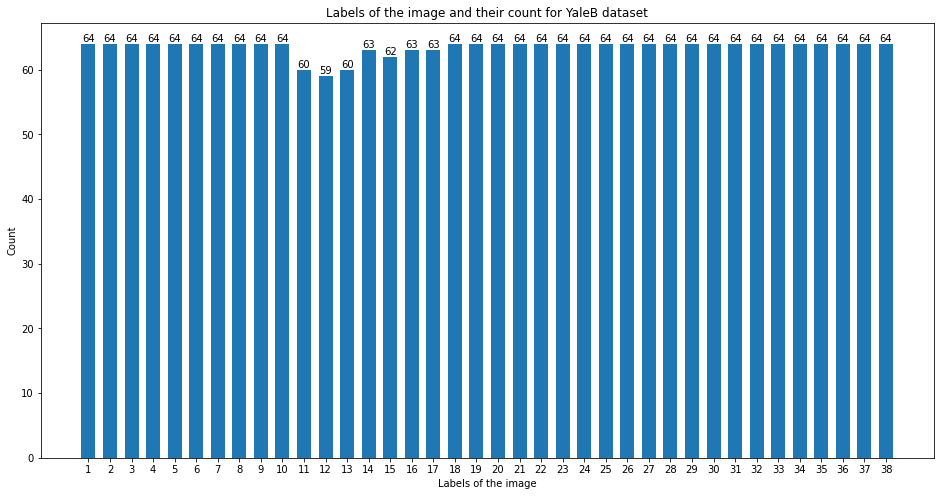

In [22]:
# Understand the distribution of the labels for the images from YaleB dataset
labels_YaleB, count_YaleB = get_label_count(Y_YaleB)
plot_bar_graph(labels_YaleB, count_YaleB, "Labels of the image", "Count", "Labels of the image and their count for YaleB dataset")

In [23]:
#Number of labels and images
print("Number of labels:", len(labels_YaleB))
print("Number of images:", X_YaleB.shape[1])
print("Number of pixels in each image:", X_YaleB.shape[0])
print("Shape of ORL dataset:", X_YaleB.shape)
print("Shape of ORL labels:", Y_YaleB.shape)
print("Minimum pixel value: {0}, Maximum pixel value:{1}".format(X_YaleB.min(), X_YaleB.max()))

Number of labels: 38
Number of images: 2414
Number of pixels in each image: 2016
Shape of ORL dataset: (2016, 2414)
Shape of ORL labels: (2414,)
Minimum pixel value: 0, Maximum pixel value:255


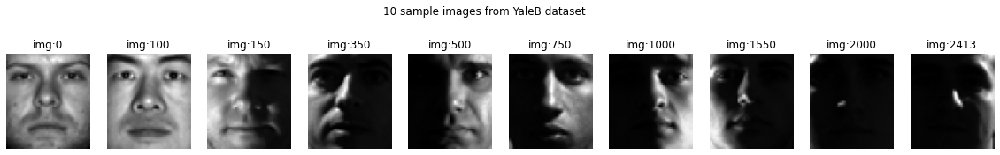

In [24]:
# Explore few sample images 
image_index_YaleB = [0, 100, 150, 350, 500, 750, 1000, 1550, 2000, 2413]
display_images(X_YaleB, image_index_YaleB, REDUCED_IMAGE_SIZE_YALEB, "10 sample images from YaleB dataset")  

### 1.4 Pre-processing

https://machinelearningmastery.com/how-to-manually-scale-image-pixel-data-for-deep-learning/

In [25]:
class ImageScaling:
    """
    This class defines different methods to scale the image pixels based on the scaling 
    type passed to it.
    """
    def standardize_image(self, dataset):
        """
        This method standardizes the image pixels for the given dataset 
        for mean value 0 and standard deviation 1. 

        param type: array
        param dataset: Image dataset to standardize
        
        type output: array
        output: Standardized image pixel's array having datatype changed to float32
        """
        try:
            dataset = dataset.astype('float32')
            mean = dataset.mean(axis = 0)
            std = dataset.std(axis = 0)
            dataset = ((dataset - mean) / std).clip(-1.0, 1.0)
            dataset = (dataset + 1.0) / 2.0
            return dataset            
        except: 
            traceback.print_exception(*sys.exc_info())

    def normalize_image(self, dataset):
        """
        This method normalizes the image pixels for the given dataset between the range of 0 to 1. 

        param type: array
        param dataset: Image dataset to normalize
        
        type output: array
        output: Normalized image pixel's array having datatype changed to float32
        """
        try:
            dataset = dataset.astype('float32')
            dataset /= 255.0
            return dataset            
        except: 
            traceback.print_exception(*sys.exc_info())

    def center_image(self, dataset):
        """
        This method centers the image pixels by subtracting the mean value from it. 

        param type: array
        param dataset: Image dataset to center
        
        type output: array
        output: Centered image pixel's array
        """
        try:
            #global centering
            dataset_centered = dataset - dataset.mean(axis=0, dtype='float64')

            #local centering
            dataset_centered = dataset_centered - dataset_centered.mean(axis=1, dtype='float64').reshape(len(dataset), -1)

            return dataset_centered
            
        except: 
            traceback.print_exception(*sys.exc_info())

    def __init__(self, dataset, scaling_type = "std"):
        """
        This method scales the dataset based on the type passed to it.

        param type: array
        param dataset: Image dataset to center

        param type: string
        param scaling_type: The type based on which the image will be scaled.The possible values are - std, norm and center.
         
        """
        try:
            if scaling_type == "std":
                self.dataset = self.standardize_image(dataset)
            elif scaling_type == "norm":
                self.dataset = self.normalize_image(dataset)
            elif scaling_type == "center":
                self.dataset = self.center_image(dataset)
            else:
                self.dataset = dataset # no scaling
        except: 
            traceback.print_exception(*sys.exc_info())
        
      

#### 1.4.1 Pre-processing for ORL dataset

Minimum pixel value: 0.0, Maximum pixel value:1.0


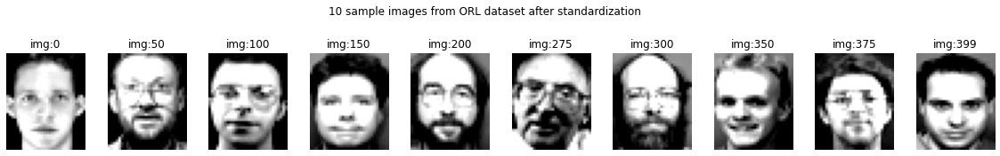

In [26]:
X_ORL_Std = ImageScaling(X_ORL, "std").dataset
print("Minimum pixel value: {0}, Maximum pixel value:{1}".format(X_ORL_Std.min(), X_ORL_Std.max()))

# Explore few sample images after pre-processing
image_index_ORL = [0, 50, 100, 150, 200, 275, 300, 350, 375, 399]
display_images(X_ORL_Std, image_index_ORL, REDUCED_IMAGE_SIZE_ORL, "10 sample images from ORL dataset after standardization") 

Minimum pixel value: 0.03529411926865578, Maximum pixel value:0.8941176533699036


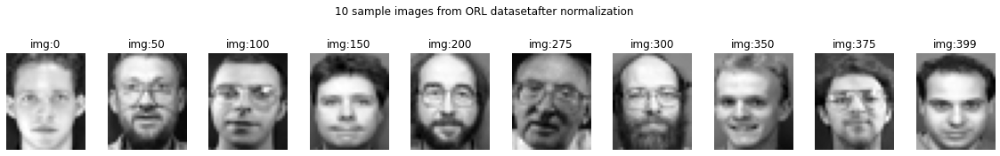

In [27]:
X_ORL_Norm = ImageScaling(X_ORL, "norm").dataset
print("Minimum pixel value: {0}, Maximum pixel value:{1}".format(X_ORL_Norm.min(), X_ORL_Norm.max()))

# Explore few sample images after pre-processing
image_index_ORL = [0, 50, 100, 150, 200, 275, 300, 350, 375, 399]
display_images(X_ORL_Norm, image_index_ORL, REDUCED_IMAGE_SIZE_ORL, "10 sample images from ORL datasetafter normalization") 

Minimum pixel value: 0.0, Maximum pixel value:1.0


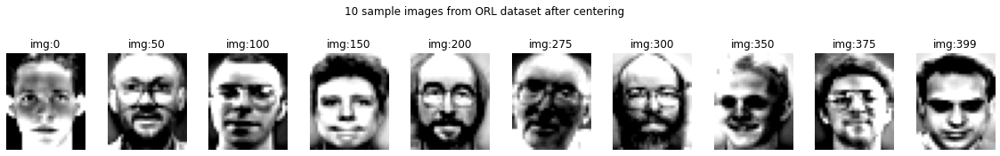

In [28]:
# Standardize the data after centering to make sure the data is positive.
X_ORL_Center = ImageScaling(ImageScaling(X_ORL, "center").dataset, "std").dataset
print("Minimum pixel value: {0}, Maximum pixel value:{1}".format(X_ORL_Center.min(), X_ORL_Center.max()))

# Explore few sample images after pre-processing
image_index_ORL = [0, 50, 100, 150, 200, 275, 300, 350, 375, 399]
display_images(X_ORL_Center, image_index_ORL, REDUCED_IMAGE_SIZE_ORL, "10 sample images from ORL dataset after centering") 

#### 1.4.2 Pre-processing for YaleB dataset

Minimum pixel value: 0.0, Maximum pixel value:1.0


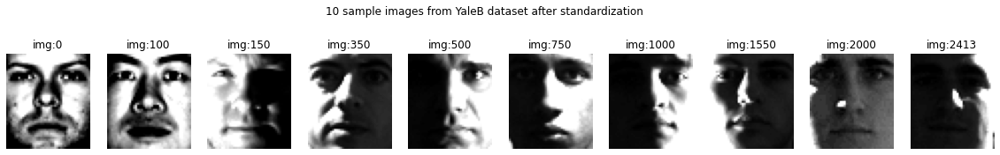

In [29]:
X_YaleB_Std = ImageScaling(X_YaleB, "std").dataset
print("Minimum pixel value: {0}, Maximum pixel value:{1}".format(X_YaleB_Std.min(), X_YaleB_Std.max()))

# Explore few sample images after pre-processing
image_index_YaleB = [0, 100, 150, 350, 500, 750, 1000, 1550, 2000, 2413]
display_images(X_YaleB_Std, image_index_YaleB, REDUCED_IMAGE_SIZE_YALEB, "10 sample images from YaleB dataset after standardization")  

Minimum pixel value: 0.0, Maximum pixel value:1.0


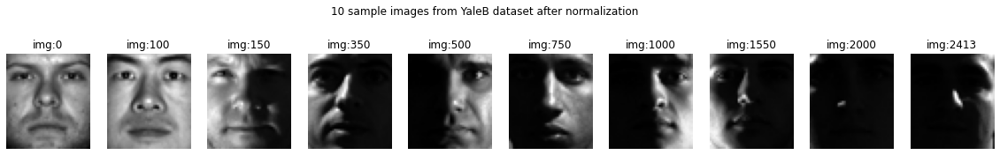

In [30]:
X_YaleB_Norm = ImageScaling(X_YaleB, "norm").dataset
print("Minimum pixel value: {0}, Maximum pixel value:{1}".format(X_YaleB_Norm.min(), X_YaleB_Norm.max()))

# Explore few sample images after pre-processing
image_index_YaleB = [0, 100, 150, 350, 500, 750, 1000, 1550, 2000, 2413]
display_images(X_YaleB_Norm, image_index_YaleB, REDUCED_IMAGE_SIZE_YALEB, "10 sample images from YaleB dataset after normalization")  

Minimum pixel value: 0.0, Maximum pixel value:1.0


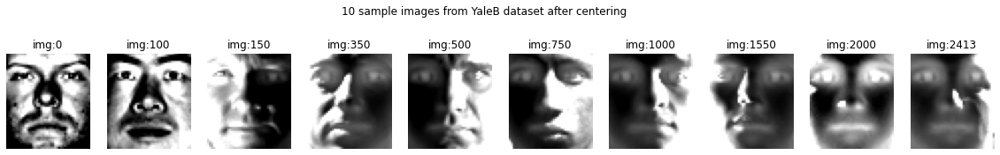

In [31]:
# Standardize the data after centering to make sure the data is positive.
X_YaleB_Center = ImageScaling(ImageScaling(X_YaleB, "center").dataset, "std").dataset
print("Minimum pixel value: {0}, Maximum pixel value:{1}".format(X_YaleB_Center.min(), X_YaleB_Center.max()))

# Explore few sample images after pre-processing
image_index_YaleB = [0, 100, 150, 350, 500, 750, 1000, 1550, 2000, 2413]
display_images(X_YaleB_Center, image_index_YaleB, REDUCED_IMAGE_SIZE_YALEB, "10 sample images from YaleB dataset after centering")  

## 2. NMF Algorithm

### 2.1 Random Sampling


In [32]:
def random_sampling(X, Y, sample_percentage):
    """
    This method returns randomly sampled data based on the percentage passed to it.
    
    param type: array
    param X: Dataset containing image pixels

    param type: array
    param Y: Dataset containing image labels.
    
    param type: decimal
    param sample_percentage: Percentage of sampled data.  

    type output: tuple
    output: Tuple of image pixels and labels matrices after sampling 
    """
    try:
        number_of_elements = X.shape[1]
        indexes_array = np.arange(number_of_elements)
        data_size = round(number_of_elements * sample_percentage)

        # replace is set to false to avoid duplicate indexes to be selected.
        shuffled_indexes = np.random.choice(indexes_array, data_size, replace = False)

        X_sampled = X[:, shuffled_indexes]
        Y_sampled = Y[shuffled_indexes]
        return X_sampled, Y_sampled
    
    except: 
        traceback.print_exception(*sys.exc_info())        

#https://numpy.org/doc/stable/reference/random/generated/numpy.random.choice.html

#### 2.1.1 Random sampling of ORL dataset

In [33]:
X_ORL_Sampled, Y_ORL_Sampled = random_sampling(X_ORL_Std, Y_ORL, 0.9)
print("Before Sampling: X_ORL.shape = {0}, Y_ORL.shape = {1}".format(X_ORL_Std.shape, Y_ORL.shape))
print("After Sampling: X_ORL_Sampled.shape = {0}, Y_ORL_Sampled.shape = {1}".format(X_ORL_Sampled.shape, Y_ORL_Sampled.shape))

Before Sampling: X_ORL.shape = (1110, 400), Y_ORL.shape = (400,)
After Sampling: X_ORL_Sampled.shape = (1110, 360), Y_ORL_Sampled.shape = (360,)


#### 2.1.2 Random sampling of YaleB dataset

In [34]:
X_YaleB_Sampled, Y_YaleB_Sampled = random_sampling(X_YaleB_Std, Y_YaleB, 0.9)
print("Before Sampling: X_YaleB.shape = {0}, Y_YaleB.shape = {1}".format(X_YaleB_Std.shape, Y_YaleB.shape))
print("After Sampling: X_YaleB_Sampled.shape = {0}, Y_YaleB_Sampled.shape = {1}".format(X_YaleB_Sampled.shape, Y_YaleB_Sampled.shape))

Before Sampling: X_YaleB.shape = (2016, 2414), Y_YaleB.shape = (2414,)
After Sampling: X_YaleB_Sampled.shape = (2016, 2173), Y_YaleB_Sampled.shape = (2173,)


### 2.2 Noise Addition

In [35]:
def add_noise(X, noise_type, noise_percentage, scaling = "no-scaling"):
    """
    This method returns image data after adding noise to it. 
    The noise is added based on the noise type
    and noise percentage passed to it.
    
    param type: array
    param X: Dataset containing image pixels

    param type: string
    param noise_type: Type of noise. Possible values are "gaussian", "laplace", "impulse".
    
    param type: decimal
    param noise_percentage: Percentage of noise to be added to the dataset.  

    param type: string
    param scaling: Type of image scaling. Possible values are "no-scaling", "std", "norm", "center".

    type output: array
    output: Array of image pixels after adding noise to it.
    """
    try:
        rng = default_rng(100)
        mean = np.mean(X, axis = (0))
        X_noisy = np.copy(X)

        if noise_type == "gaussian":       
            std = np.std(X, axis = (0)) 
            noise = rng.normal(mean, std, size = (X.shape)) * noise_percentage  
            # Clipping the value to keep the matrix positive
            X_noisy = (X + noise).clip(0)  

        elif noise_type == "laplace":
            exp_decay = 10
            if scaling == "std":
                exp_decay = 0.25
            elif scaling == "norm":
                exp_decay = 0.05
            elif scaling == "center":
                exp_decay = 1
            else:
                exp_decay = 10

            noise = rng.laplace(mean, exp_decay, size = X.shape) * noise_percentage
            # Clipping the value to keep the matrix positive
            X_noisy = (X + noise).clip(0)  

        elif noise_type == "impulse":
            # Better to use this noise type with original image
            num_of_pixels_per_image = X.shape[0]
            num_of_noisy_pixels = round(num_of_pixels_per_image * noise_percentage)
            noise_indexes = rng.integers(low = 0, high = num_of_pixels_per_image, size = num_of_noisy_pixels) 
            mid_index = round(num_of_noisy_pixels/2)
            salt_index = noise_indexes[:mid_index]
            pepper_index = noise_indexes[mid_index:]            
            X_noisy[salt_index] = 255            
            X_noisy[pepper_index] = 0
        else:
            print("Please pass a valid noise type")

        return X_noisy
    
    except: 
        traceback.print_exception(*sys.exc_info())        

#https://arxiv.org/ftp/arxiv/papers/1505/1505.03489.pdf
#https://numpy.org/doc/stable/reference/random/generated/numpy.random.Generator.normal.html#numpy.random.Generator.normal
#https://numpy.org/doc/stable/reference/random/generated/numpy.random.Generator.laplace.html#numpy.random.Generator.laplace
#https://numpy.org/doc/stable/reference/random/generator.html#numpy.random.default_rng
#https://stackoverflow.com/questions/64074698/how-to-add-5-gaussian-noise-to-the-signal-data

#### 2.2.1 Test noise on ORL dataset

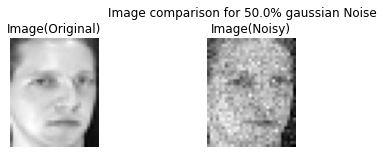

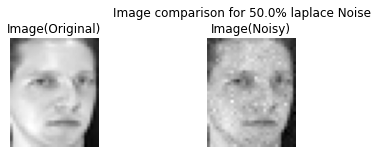

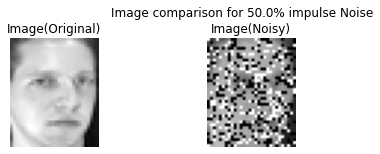

In [36]:
noise_types_ORL = ["gaussian", "laplace", "impulse"]
noise_percentage_orl = 0.5

for noise_type in noise_types_ORL:
    X_ORL_Noisy = add_noise(X_ORL, noise_type, noise_percentage_orl, "no-scaling")

    # index of test image.
    test_img_index = 2 
    plot_image_comparison(X_ORL[:,test_img_index], 
                          X_ORL_Noisy[:,test_img_index], 
                          None, 
                          REDUCED_IMAGE_SIZE_ORL, 
                          "Image comparison for {}% {} Noise".format(noise_percentage_orl * 100, noise_type))

##### 2.2.2 Test noise on YaleB dataset

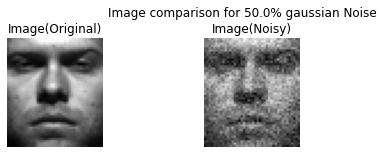

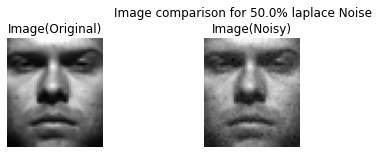

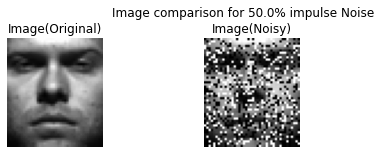

In [37]:
noise_types_yaleB = ["gaussian", "laplace", "impulse"]
noise_percentage_yaleB = 0.5

for noise_type in noise_types_yaleB:
    X_YaleB_Noisy = add_noise(X_YaleB, noise_type, noise_percentage_yaleB)

    # index of test image.
    test_img_index = 2 
    plot_image_comparison(X_YaleB[:,test_img_index], 
                          X_YaleB_Noisy[:,test_img_index], 
                          None, 
                          REDUCED_IMAGE_SIZE_YALEB, 
                          "Image comparison for {}% {} Noise".format(noise_percentage_orl * 100, noise_type))

### 2.3 Initialization of D and R

In [38]:
def initialize_factors(basis, coefficient, init_type = "uniform"):
    """
    This method initializes the basis and coefficient matrices on the basis 
    of the initialization type passed to it.  

    param type: array
    param basis: Basis vector used in NMF

    param type: array
    param coefficient: Coefficient vector used in NMF
    
    param type: string
    param init_type: The type based on which the matrices will be initialized. 
    The possible values are - "uniform", "gaussian".

    type output: tuple
    output: Tuple of basis and coefficient matrices after initialization         
    """
    try:
        if init_type == "uniform":
            np.random.seed(100)
            basis = np.random.uniform(0, 1, basis.shape)
            coefficient = np.random.uniform(0, 1, coefficient.shape)

        elif init_type == "gaussian":
            rng = default_rng(100)
            basis = rng.normal(size = (basis.shape)).clip(0)
            coefficient = rng.normal(size = (coefficient.shape)).clip(0)      

        else:
            print("Please pass a valid initialization type")

        return basis, coefficient
    
    except: 
        traceback.print_exception(*sys.exc_info())        

#https://arxiv.org/pdf/1711.02037.pdf

### 2.4 Evaluation Metrics

1. Relative Reconstruction Errors (RRE)

    To compare the robustness of different NMF algorithms, you can use the ```relative reconstruction errors```. Let $V$ denote the contaminated dataset (by adding noise), and $\hat{V}$
    denote the clean dataset. Let $W$ and $H$ denote the factorization results on $V$, the ``relative reconstruction errors`` then can be defined as follows:


 \begin{equation}
    RRE = \frac{ \| \hat{V} - WH \|_F }{ \| \hat{V} \|_F}.
\end{equation}

The RE for L2,1 norm will be calculated using the below equation
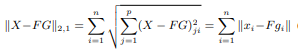

https://dl-acm-org.ezproxy.library.sydney.edu.au/doi/pdf/10.1145/2063576.2063676

2. Accuracy.
    
    $$ Acc(Y, Y_{pred}) = \frac{1}{n}\sum\limits_{i=1}^n 1\{Y_{pred}(i) == Y(i)\}$$
        
3. Normalized Mutual Information (NMI).

    $$ NMI(Y, Y_{pred}) = \frac{2 * I(Y, Y_{pred})}{H(Y) + H(Y_{pred})} $$
    
   where $ I(\cdot,\cdot) $ is mutual information and $ H(\cdot) $ is entropy.

In [39]:
class EvaluationMetrics:
    """
    This class has functions to implement evaluation metrics for NMF algorithms.
    """

    def assign_cluster_label(self, X, Y):
        """
        This method assigns the labels to the dataset X using KMeans clustering.

        param type: array
        param X: Dataset containing the image data

        param type: array
        param Y: Dataset containing the labels

        type output: array
        output: An array of predicted labels
        """
        try:
            kmeans = KMeans(n_clusters = len(set(Y))).fit(X)
            Y_pred = np.zeros(Y.shape)
            for i in set(kmeans.labels_):
                ind = (kmeans.labels_ == i)
                Y_pred[ind] = Counter(Y[ind]).most_common(1)[0][0] # assign label.
            return Y_pred
        except: 
            traceback.print_exception(*sys.exc_info())        

    def calculate_rre_frobenius(self, X, D, R):
        """
        This method calculates the evaluation metric based on relative reconstruction error based on 
        Frobenius norm.

        param type: array
        param X: The original dataset of the image

        param type: array
        param D: Basis vector used in NMF

        param type: array
        param R: Coefficient vector used in NMF

        type output: decimal
        output: Relative reconstruction error   
        """
        try:
            rre = np.linalg.norm(X - D.dot(R)) / np.linalg.norm(X)
            return round(rre, 4)
        except: 
            traceback.print_exception(*sys.exc_info())     
            
            
    def calculate_rre_l_2_1(self, X, D, R):
        """
        This method calculates the evaluation metric based on relative reconstruction error
        for l21 norm.

        param type: array
        param X: The original dataset of the image

        param type: array
        param D: Basis vector used in NMF

        param type: array
        param R: Coefficient vector used in NMF

        type output: decimal
        output: Relative reconstruction error   
        """
        try:
            l21_norm_X_DR = np.sum(np.sqrt(np.sum(np.square(X - D.dot(R)), axis = (0))))
            l21_norm_X = np.sum(np.sqrt(np.sum(np.square(X), axis = (0))))            
            rre = l21_norm_X_DR / l21_norm_X
            return round(rre, 4)
        except: 
            traceback.print_exception(*sys.exc_info())   
            

    def calculate_avg_accuracy(self, Y, D, R):
        """     
        This method calculates the evaluation metric based on average accuracy.

        param type: array
        param Y: The original dataset of the image labels

        param type: array
        param D: Basis vector used in NMF

        param type: array
        param R: Coefficient vector used in NMF

        type output: decimal
        output: Normalized Mutual Information   
        """
        try:
            Y_pred = self.assign_cluster_label(R.T, Y)
            avg_accuracy = accuracy_score(Y, Y_pred)
            return round(avg_accuracy, 4) 
        except: 
            traceback.print_exception(*sys.exc_info())        

    def calculate_nmi(self, Y, D, R):
        """     
        This method calculates the evaluation metric based on normalized mutual information.

        param type: array
        param Y: The original dataset of the image labels

        param type: array
        param D: Basis vector used in NMF

        param type: array
        param R: Coefficient vector used in NMF

        type output: decimal
        output: Normalized Mutual Information   
        """
        try:
            Y_pred = self.assign_cluster_label(R.T, Y)
            nmi = normalized_mutual_info_score(Y, Y_pred)
            return round(nmi, 4)  
        except: 
            traceback.print_exception(*sys.exc_info())        


### 2.5 Algorithm Implementation

In [40]:
class NonNegativeMatrixFactorization:
    """
    This class implements different NMF algorithms based on te NMF type passsed to it.
    """
    def __init__(self, nmf_type, rank, dataset, labels, factors_init_type, max_iteration):
        """
        This method initializes the variables for Frobenius NMF algorithm.

        param type: string
        param nmf_type: The type  of nmf algorithm. Alloowed types are "frobenius", "l21".

        param type: int
        param rank: rank used to create the factors basis and coefficient matrices.

        param type: array
        param dataset: Dataset containing the image data

        param type: array
        param dataset: Dataset containing the image labels
        
        param type: string
        param factors_init_type: The type based on which basis and coefficient matrices will be initialized. 

        param type: int
        param max_iteration: The maximum number iteration to update the factors.
        """
        try:
            self.nmf_type = nmf_type
            self.nmf_optimizations = {'frobenius': self.multiplicative_update_frobenius_norm,
                                      'l21': self.multiplicative_update_l_2_1_norm}
            self.nmf_optimization = self.nmf_optimizations[self.nmf_type]
            self.eval_metric = EvaluationMetrics()
            self.rre_metrics = {'frobenius': self.eval_metric.calculate_rre_frobenius,
                                      'l21': self.eval_metric.calculate_rre_l_2_1}
            self.rre_metric = self.rre_metrics[self.nmf_type]
            self.dataset = dataset
            self.Y = labels
            self.D = np.zeros((dataset.shape[0], rank))
            self.R = np.zeros((rank, dataset.shape[1]))
            self.D, self.R = initialize_factors(self.D, self.R, factors_init_type)
            self.max_iteration = max_iteration
        except: 
            traceback.print_exception(*sys.exc_info())        
       
    def multiplicative_update_frobenius_norm(self, X, D, R):
        """
        This method implements multiplicative update for Frobenius norm based NMF.
        
        param type: array
        param X: The dataset for which the factors will be created.
       
        param type: array
        param D: Basis vector used in NMF

        param type: array
        param R: Coefficient vector used in NMF
        
        type output: tuple
        output: Updated Basis and Coefficient vectors  
        """
        try:
            #Epsilon is added for mathematically stable equation to avoid divide by zero error.
            epsilon = 1e-7

            R_k1 = R * (D.T.dot(X))/(D.T.dot(D.dot(R)) + epsilon)
            D_k1 = D * (X.dot(R_k1.T))/(D.dot(R_k1.dot(R_k1.T)) + epsilon)

            return D_k1, R_k1
        except: 
            traceback.print_exception(*sys.exc_info())        

    def multiplicative_update_l_2_1_norm(self, X, D, R):
        """
        This method implements multiplicative update for L2,1 norm based NMF.
        #https://dl-acm-org.ezproxy.library.sydney.edu.au/doi/pdf/10.1145/2063576.2063676

        param type: array
        param X: The dataset for which the factors will be created.
       
        param type: array
        param D: Basis vector used in NMF

        param type: array
        param R: Coefficient vector used in NMF
        
        type output: tuple
        output: Updated Basis and Coefficient vectors 
        """
        try:
            #Epsilon is added for mathematically stable equation to avoid divide by zero error.
            epsilon = 1e-7

            diagonal = np.zeros((X.shape[1], X.shape[1]))
            row_wise_sum = np.sum(np.square(X - D.dot(R)), axis = (0))
            diagonal = np.diag(1/(np.sqrt(row_wise_sum)))

            D_k1 = D * (X.dot(diagonal.dot(R.T)))/(D.dot(R.dot(diagonal.dot(R.T)) + epsilon)) 
            R_k1 = R * (D.T.dot(X.dot(diagonal)))/(D.T.dot(D.dot(R.dot(diagonal)) + epsilon)) 

            return D_k1, R_k1
        except: 
            traceback.print_exception(*sys.exc_info())     
            
    def check_negative_number(self):
        """
        This methods validates that none of the numbers in X, D or R 
        are negative.
        """
        if np.any(self.dataset < 0):
                raise Exception("Negative value in X")
            
        if np.any(self.D < 0):
            raise Exception("Negative value in D")

        if np.any(self.R < 0):
            raise Exception("Negative value in R")
            
            
    def fit(self, print_result = False):
        """
        This method implements the NMF algorithm using the specified nmf type .

        param type: boolean
        param print_result: Flag to determine if the result should be printed or not

        type output: tuple
        output: Factors of the image dataset
        """
        try:
            
            # Validate that none of the numbers in X, D or R are negative
            self.check_negative_number()
                
            
            rre = np.zeros(self.max_iteration)
            avg_acc = np.zeros(self.max_iteration)
            nmi = np.zeros(self.max_iteration)
            ERROR_THRESHOLD = 0.001
            STOP_CRITERIA_MET = False
            
            for iteration in range(self.max_iteration):                
                D_k = np.copy(self.D)
                R_k = np.copy(self.R)
                
                # Calculate NMF
                D_k1, R_k1 = self.nmf_optimization(self.dataset, D_k, R_k)
                
                # Check for error threshold
                D_err = np.sqrt(np.sum((D_k1 - D_k)**2, axis = (0, 1)))/D_k.size
                R_err = np.sqrt(np.sum((R_k1 - R_k)**2, axis = (0, 1)))/R_k.size
                
                # Stop iteration if both D and R have very low error
                # The calcualtion is not stopped after the stop criteria as 
                # the average calculation will be impacted for the repeat runs
                # since each run will have a different number of iteration
                # based on error threshold as stop criteria. 
                # Based on exhaustive run, we have selected the max_iteration value close 
                # to the number which was most frequest with stop criteris based on error
                # threshold. The graph for iteration vs average evaluation metric will also 
                # show that information.
                if (STOP_CRITERIA_MET == False and D_err < ERROR_THRESHOLD and R_err < ERROR_THRESHOLD):      
                    STOP_CRITERIA_MET = True
                    if print_result == True:
                        print("Stopping criteria met at step", (iteration + 1))
    
                self.D = D_k1
                self.R = R_k1

                # Calculate evaluation metric             
                rre[iteration] = self.rre_metric(self.dataset, self.D, self.R)
                avg_acc[iteration] = self.eval_metric.calculate_avg_accuracy(self.Y, self.D, self.R)
                nmi[iteration] = self.eval_metric.calculate_nmi(self.Y, self.D, self.R)
                
                # Print result based on the flag passed to the method
                if print_result == True:
                    print("Run({}/{}): rre {}, avg_acc {}, nmi {}".format(iteration + 1,
                                                                          self.max_iteration,
                                                                          rre[iteration],
                                                                          avg_acc[iteration],
                                                                          nmi[iteration] ))

            self.eval_metrics = rre, avg_acc, nmi
            return self.D, self.R
        except: 
            traceback.print_exception(*sys.exc_info())        


## 3. Experiment Setup

In [41]:
def execute_experiment(X, Y, repeat, exp_params, eval_metrics):
    """
    This method executes each experiment for 5 times (passed using repeat variable) 
    by random sampling 90% of the data. The result is averaged over these 5 runs and 
    standard deviation is also calculated.
    
    param type: array
    param X: The dataset of the image

    param type: array
    param Y: The dataset of the image labels
    
    param type: int
    param repeat: The number of times the experiment should be executed
    
    param type: dictionary
    param exp_params: Dictionary containing the parameters needed for the
    experiment.
    
    param type: dictionary
    param eval_metrics: Dictionary containing the evaluation metrics for the experiment.

    type output: tuple
    output: Basis and coefficient matrix, Average and standard deviation of evaluation metrics   
    """
    try:
        all_rre = np.zeros((repeat, exp_params["max_iteration"]))
        all_avg_acc = np.zeros((repeat, exp_params["max_iteration"]))
        all_nmi = np.zeros((repeat, exp_params["max_iteration"]))

        for exp_index in range(0, repeat):
            # Randomlysample 90% of the data
            X_ORL_Sampled, Y_ORL_Sampled = random_sampling(X, Y, 0.9)

            # Add noise to the data based on the noise type and noise percentage
            X_ORL_Noisy = add_noise(X_ORL_Sampled, 
                                    exp_params["noise_type"], 
                                    exp_params["noise"], 
                                    scaling = exp_params["scaling_type"])

            # Invoke NMF on the data based on NMF type, rank and pther parameters
            nmf = NonNegativeMatrixFactorization(exp_params["nmf_type"], 
                                                 exp_params["rank"],
                                                 X_ORL_Noisy, 
                                                 Y_ORL_Sampled, 
                                                 exp_params["factors_init_type"], 
                                                 exp_params["max_iteration"])            
            D, R = nmf.fit(False)        
            rre, avg_acc, nmi = nmf.eval_metrics
            print("\n")

            # Store the evaluation metrics data for each experiment run
            all_rre[exp_index] = rre
            all_avg_acc[exp_index] = avg_acc
            all_nmi[exp_index] = nmi           

        key = exp_params["key"]
        eval_metrics[key + "_mean_rre"] = np.mean(all_rre, axis = 0)
        eval_metrics[key + "_mean_avg_acc"] = np.mean(all_avg_acc, axis = 0)
        eval_metrics[key + "_mean_nmi"] = np.mean(all_nmi, axis = 0)
        eval_metrics[key + "_std_rre"] = np.std(all_rre, axis = 0)
        eval_metrics[key + "_std_avg_acc"] = np.std(all_avg_acc, axis = 0)
        eval_metrics[key + "_std_nmi"] = np.std(all_nmi, axis = 0)

        # Display image for the experiment.
        SAMPLE_IMG_INDEX = 2 
        plot_image_comparison(X_ORL_Sampled[:,SAMPLE_IMG_INDEX], 
                              X_ORL_Noisy[:,SAMPLE_IMG_INDEX], 
                              D.dot(R)[:,SAMPLE_IMG_INDEX], 
                              exp_params["reduced_image_size"], 
                              exp_params["image_title"])  

        plot_basis_coefficient(D, R, exp_params["reduced_image_size"], exp_params["coeff_image_size"])

        return D, R, eval_metrics
    
    except: 
        traceback.print_exception(*sys.exc_info())        

In [42]:
def plot_result(eval_metrics, plot_param, img_name = None, save_image = False):
    """
    This method plots the average and standard deviation of the evaluation metrics.
    
    param type: dictionary
    param eval_metrics: Dictionary containing the evaluation metrics for the experiment.
    
    param type: string
    param plot_param: Name of the parameter is compared in the combined graph.
    
    param type: string
    param img_name: Name of the image with which it will be saved to the file.
    
    param type: boolean
    param save_image: Flag to indicate of the image should be saved to the file or not.
    """
    try:
        fig, ax = plt.subplots(2, 3, figsize=(24, 12))
        i= 0
        j = 0
        for key, value in eval_metrics.items(): 
            label_text = key.split("_")[0]
            if key.endswith("_mean_rre"):
                i = 0
                j = 0
                title = "Average RRE for different " + plot_param
                y_label = "Average RRE"
            elif key.endswith("_mean_avg_acc"):
                i = 0
                j = 1
                title = "Average Accuracy for different " + plot_param
                y_label = "Average Accuracy"
            elif key.endswith("_mean_nmi"):
                i = 0
                j = 2
                title = "Average NMI for different " + plot_param
                y_label = "Average NMI"
            elif key.endswith("_std_rre"):
                i = 1
                j = 0
                title = "Standard Deviation of RRE for different " + plot_param
                y_label = "Standard Deviation of RRE"
            elif key.endswith("_std_avg_acc"):
                i = 1
                j = 1
                title = "Standard Deviation of Accuracy for different " + plot_param
                y_label = "Standard Deviation of Accuracy"
            elif key.endswith("_std_nmi"):
                i = 1
                j = 2
                title = "Standard Deviation of NMI for different " + plot_param
                y_label = "Standard Deviation of NMI"            
        
            ax[i, j].plot(value, label = label_text)
            ax[i, j].set_title(title)
            ax[i, j].set_xlabel("Iteration")
            ax[i, j].set_ylabel(y_label)
            ax[i, j].legend()
        if save_image == True:
            plt.savefig("result/" + img_name + ".png")
        plt.show()
    except: 
        traceback.print_exception(*sys.exc_info())        

In [43]:
def save_result(file_name, result):
    """
    This method saves the result to a file for future reference.
    
    param type: string
    param file_name: Name of the file
    
    param type: dictionary
    param result: Result in dictionary format
    """
    np.save(file_name, result) 
    
    
def load_result(file_name):
    """
    This method loads the result from a file to a dictionary.
    
    param type: string
    param file_name: Name of the file
    """
    return np.load(file_name, allow_pickle = True).item() 

#https://stackoverflow.com/questions/19201290/how-to-save-a-dictionary-to-a-file/32216025

### 3.1 ORL Dataset

#### 3.1.1 Frobenius Norm NMF

##### 3.1.1.1 Rank Variation
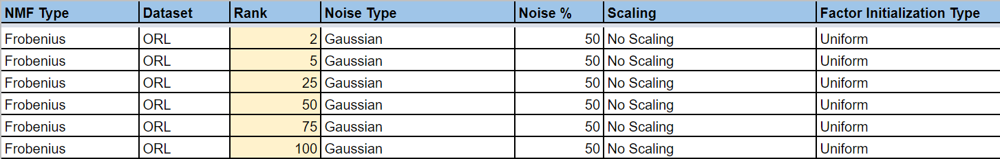

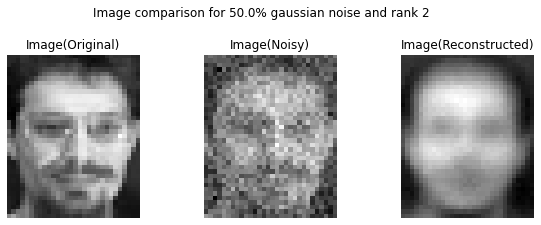

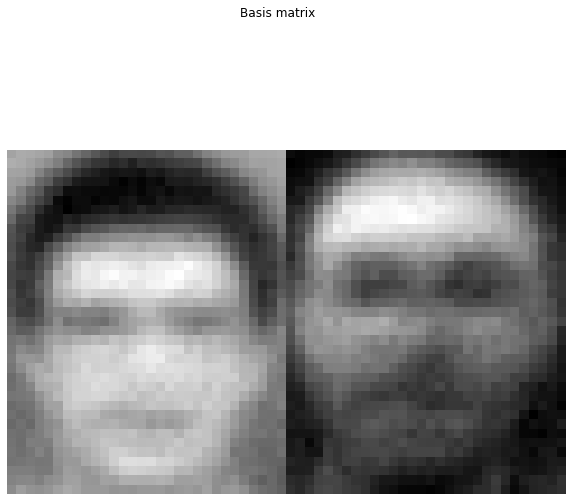

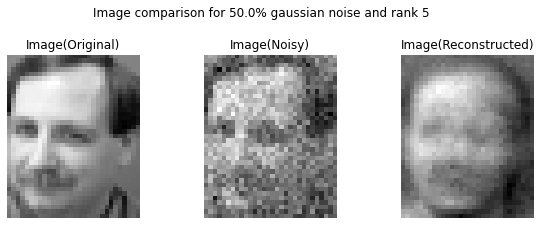

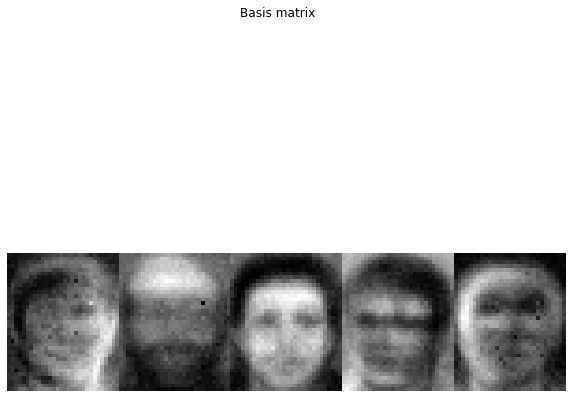

...

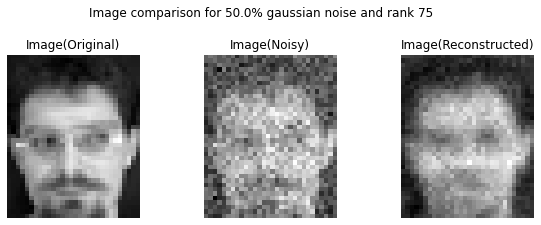

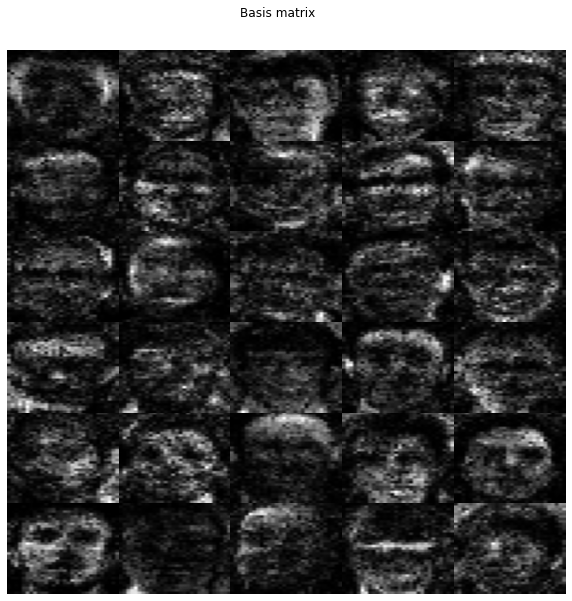

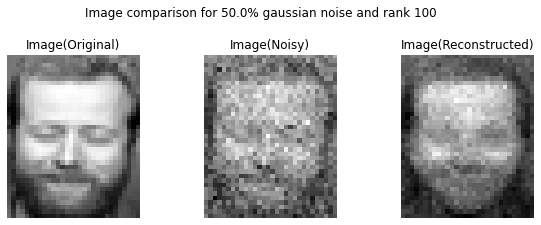

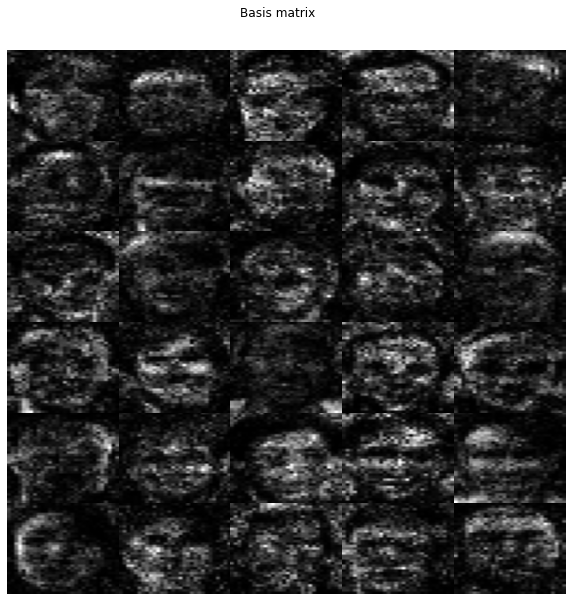

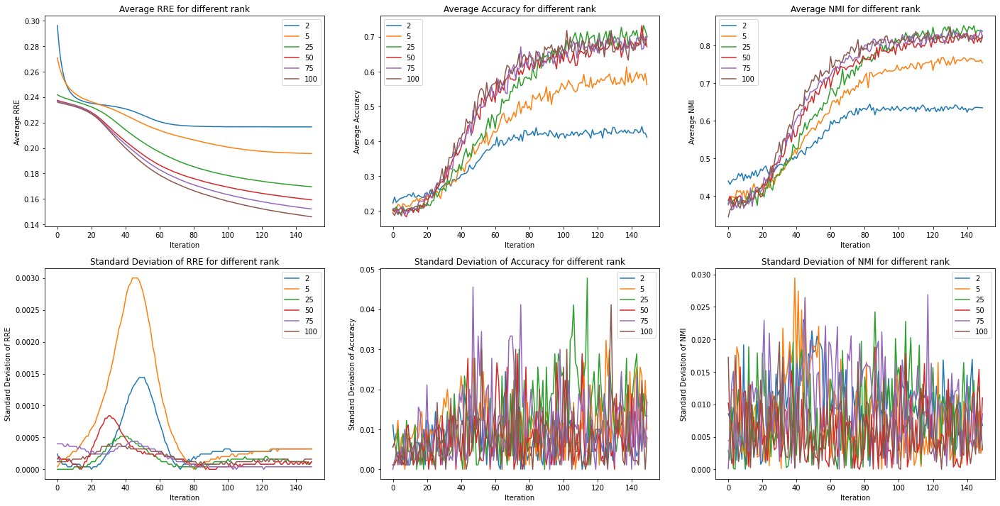

In [383]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "no-scaling"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = [2, 5, 25, 50, 75, 100]
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL
for index, rank in enumerate(RANK): 
    exp_params["key"] = str(rank)
    exp_params["rank"] = rank
    exp_params["image_title"] = "Image comparison for {}% {} noise and rank {}".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["rank"])
    D, R, eval_metrics = execute_experiment(X_ORL, Y_ORL, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/orl_fro_rank_variation.npy", eval_metrics)

plot_result(eval_metrics, "rank")

##### 3.1.1.2 Factor Initialization Variation
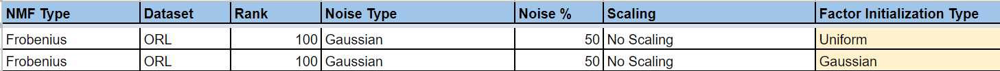

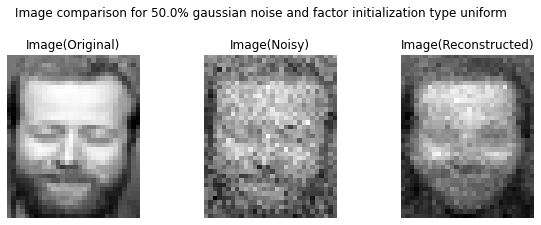

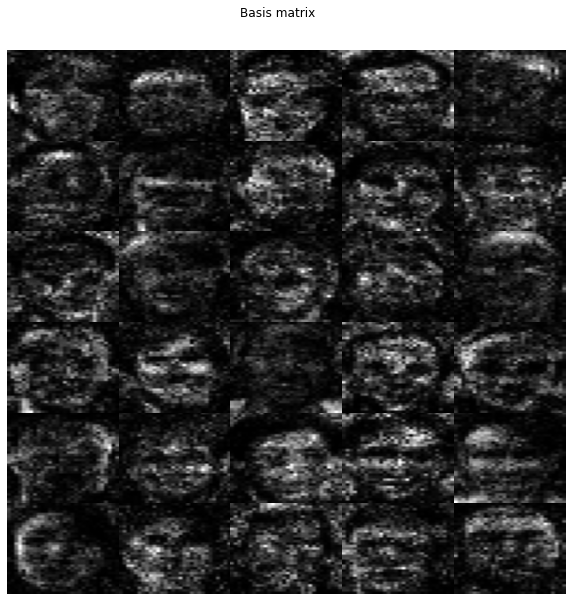

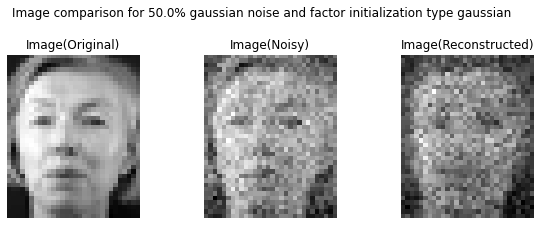

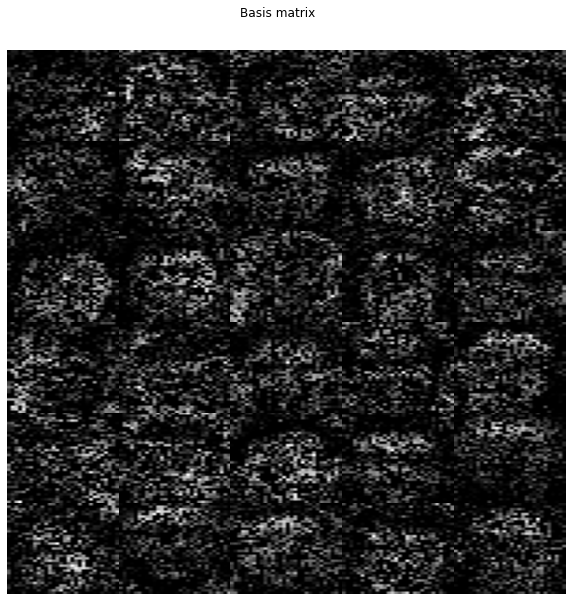

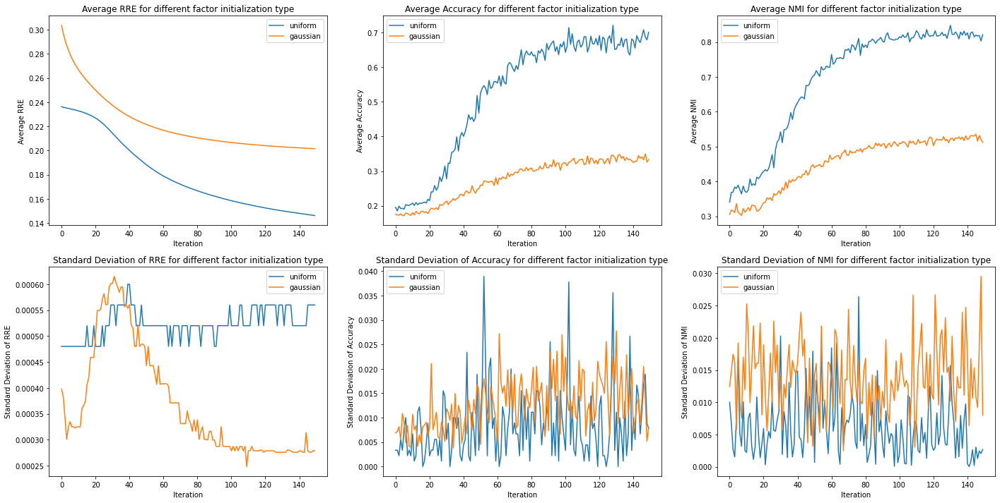

In [387]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = ["uniform", "gaussian"]

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "no-scaling"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 100
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["rank"] = RANK
exp_params["scaling_type"] = SCALING_TYPE
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL

for index, init_type in enumerate(FACTORS_INIT_TYPE): 
    exp_params["key"] = str(init_type)
    exp_params["factors_init_type"] = init_type
    exp_params["image_title"] = "Image comparison for {}% {} noise and factor initialization type {}".format(
                                                                     exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["factors_init_type"])
        
    D, R, eval_metrics = execute_experiment(X_ORL, Y_ORL, REPEAT, exp_params, eval_metrics)    
    
# Save result for future reference
save_result("result/orl_fro_factor_init.npy", eval_metrics)
plot_result(eval_metrics, "factor initialization type")

##### 3.1.1.3 Scaling Variation
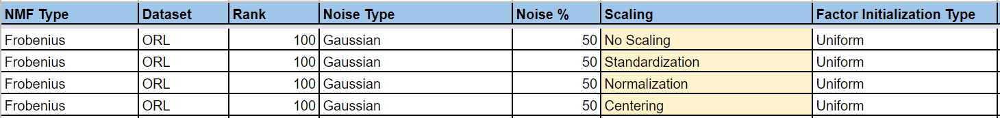

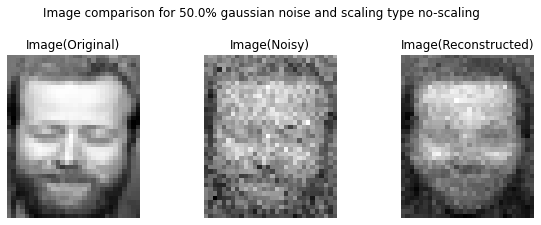

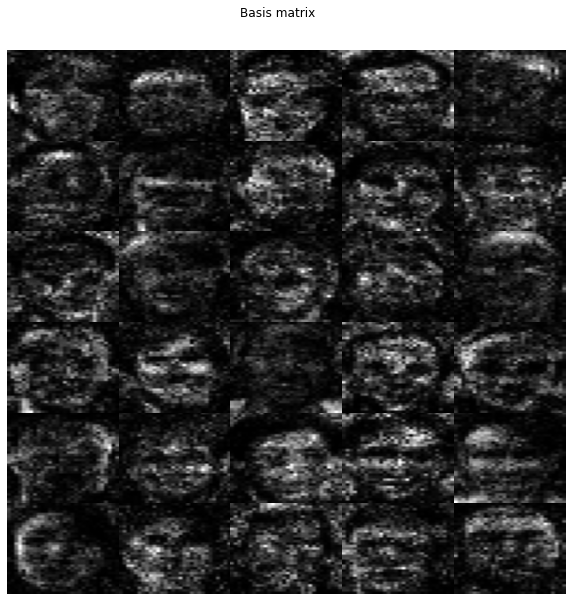

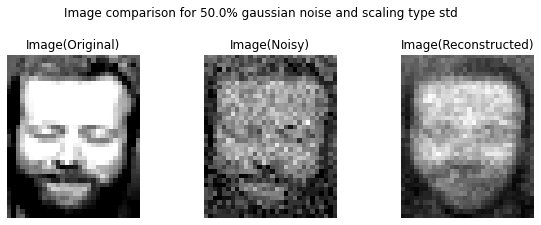

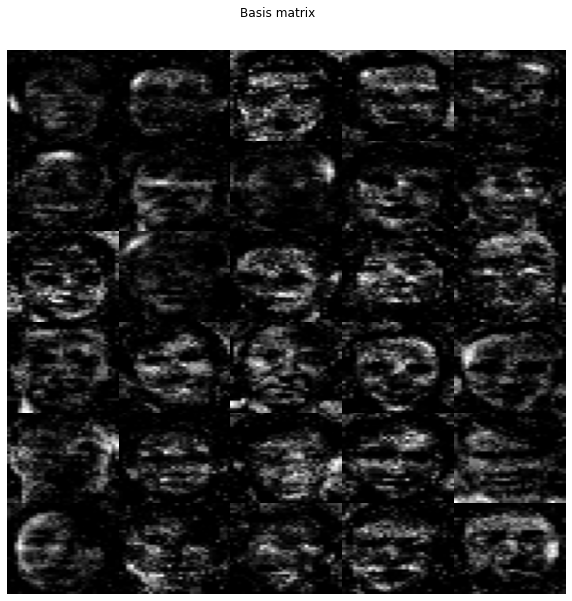

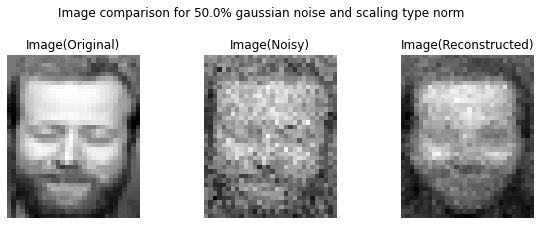

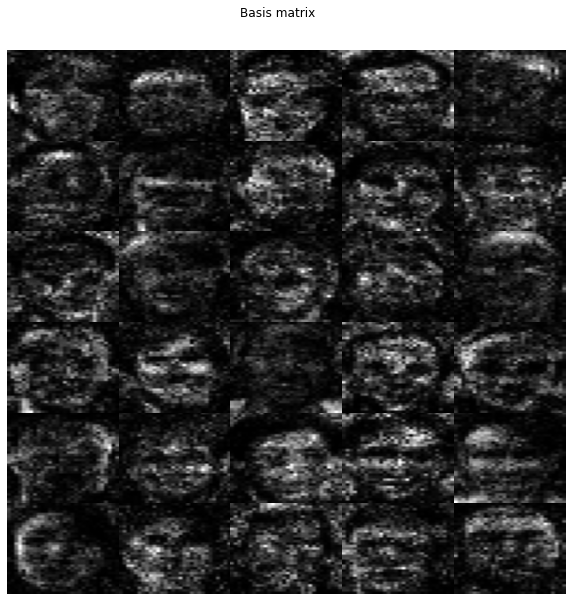

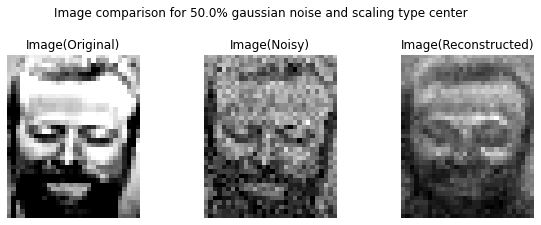

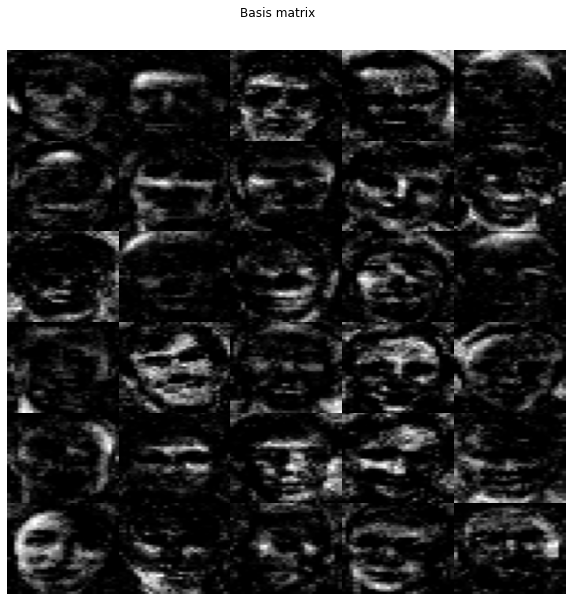

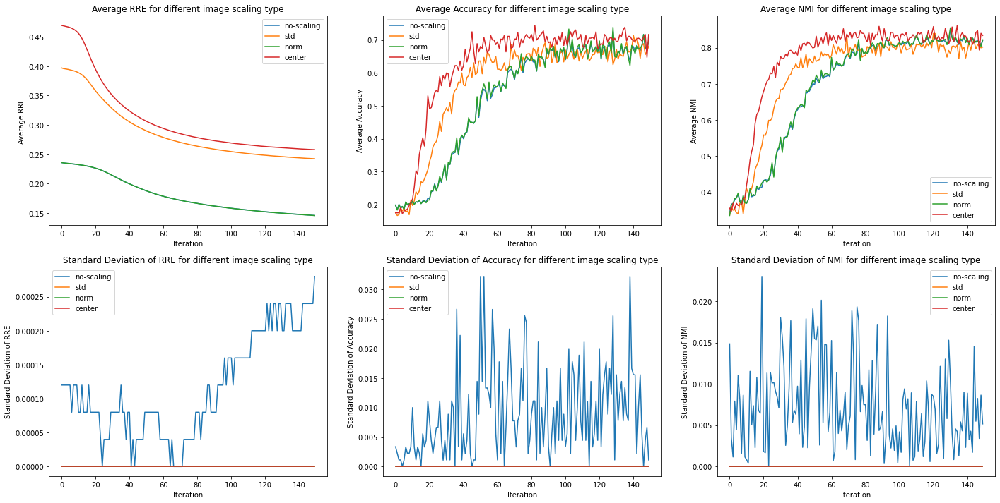

In [388]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = ["no-scaling", "std", "norm", "center"]

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 100
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["rank"] = RANK
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL
for index, scaling_type in enumerate(SCALING_TYPE): 
    exp_params["key"] = str(scaling_type)
    exp_params["scaling_type"] = scaling_type
    exp_params["image_title"] = "Image comparison for {}% {} noise and scaling type {}".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["scaling_type"])
    if scaling_type == "std":
        D, R, eval_metrics = execute_experiment(X_ORL_Std, Y_ORL, REPEAT, exp_params, eval_metrics)   
    elif scaling_type == "norm":
        D, R, eval_metrics = execute_experiment(X_ORL_Norm, Y_ORL, REPEAT, exp_params, eval_metrics)    
    elif scaling_type == "center":
        D, R, eval_metrics = execute_experiment(X_ORL_Center, Y_ORL, REPEAT, exp_params, eval_metrics)    
    else:
        D, R, eval_metrics = execute_experiment(X_ORL, Y_ORL, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/orl_fro_scaling_type.npy", eval_metrics)

plot_result(eval_metrics, "image scaling type")

##### 3.1.1.4 Noise Type Variation
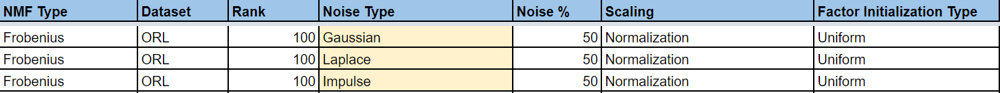

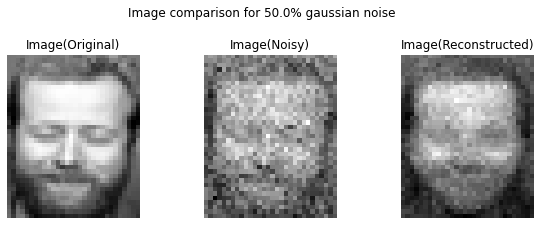

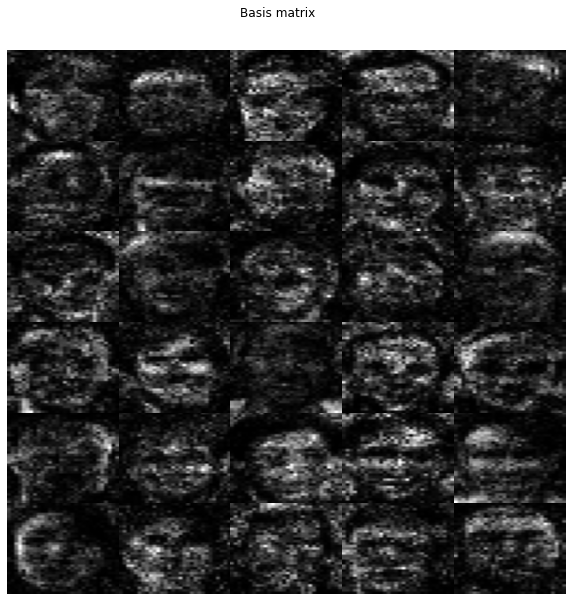

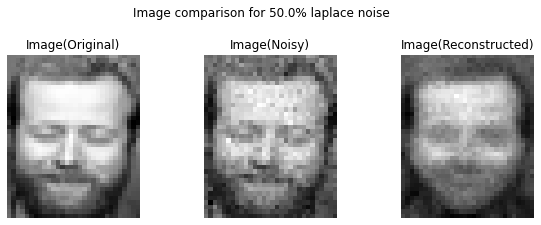

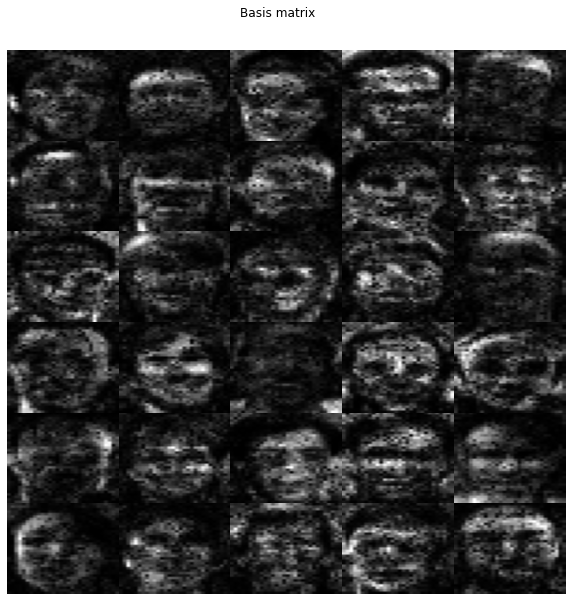

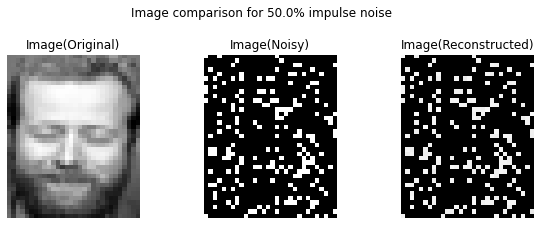

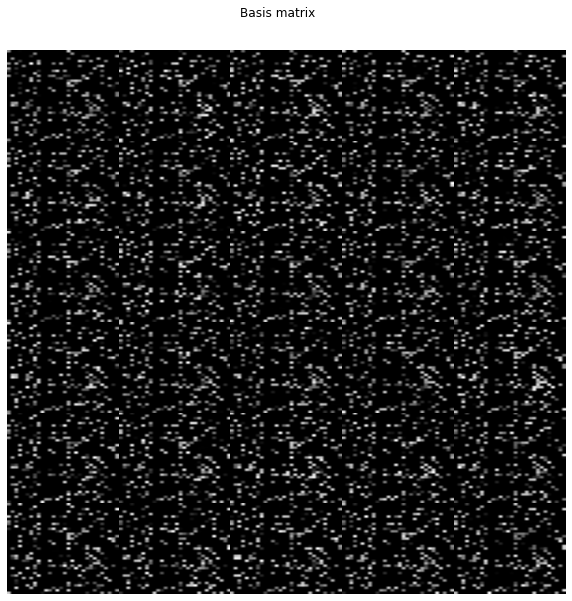

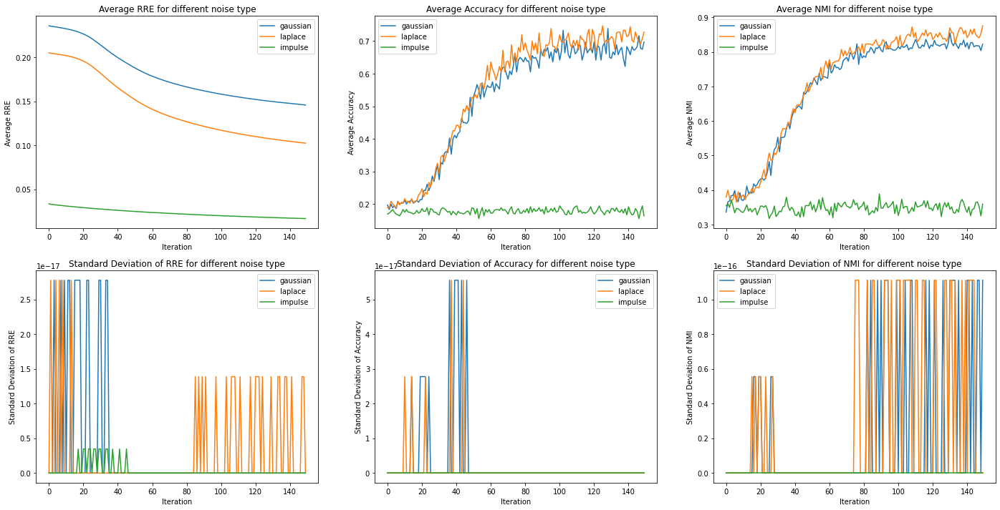

In [389]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = ["gaussian", "laplace", "impulse"]

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "norm"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 100
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["rank"] = RANK
exp_params["scaling_type"] = SCALING_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL

for index, noise_type in enumerate(NOISE_TYPE): 
    exp_params["key"] = str(noise_type)
    exp_params["noise_type"] = noise_type
    exp_params["image_title"] = "Image comparison for {}% {} noise".format(
                                                                     exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"])
        
    D, R, eval_metrics = execute_experiment(X_ORL_Norm, Y_ORL, REPEAT, exp_params, eval_metrics)   
    
# Save result for future reference
save_result("result/orl_fro_noise_type.npy", eval_metrics)
plot_result(eval_metrics, "noise type")

##### 3.1.1.5 Noise Variation
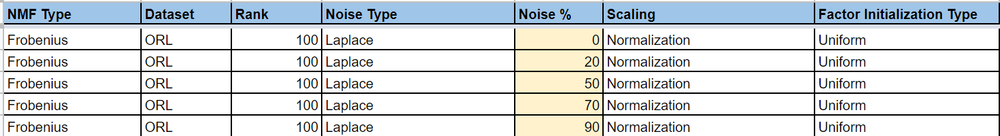

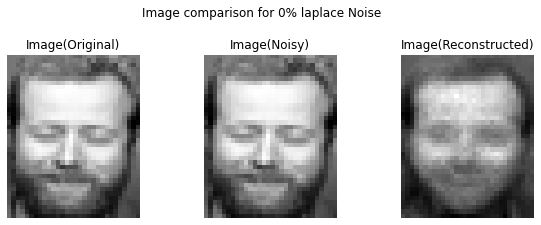

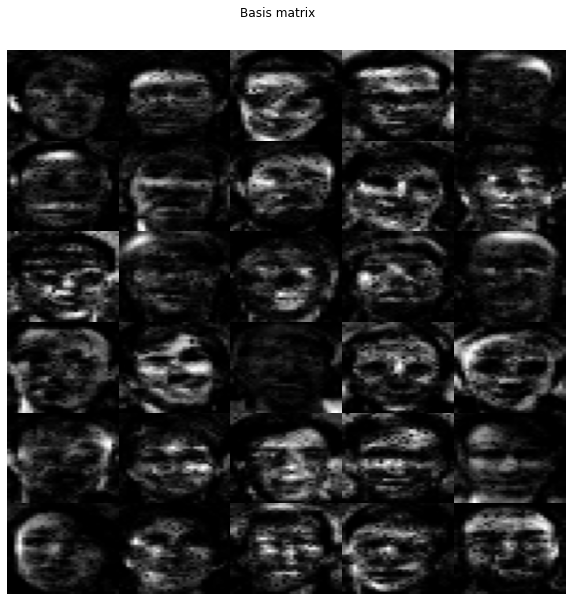

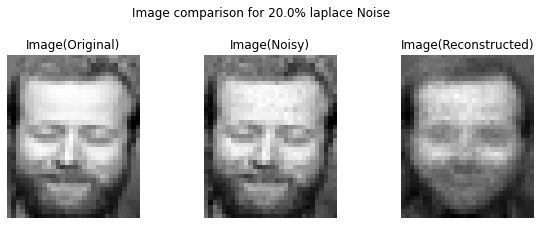

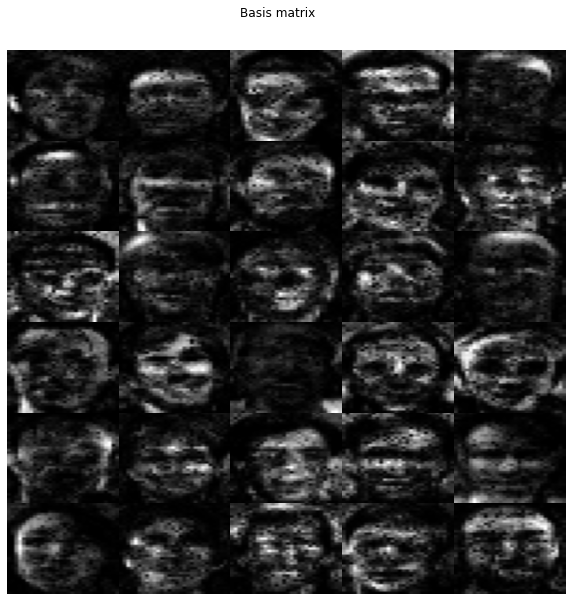

...

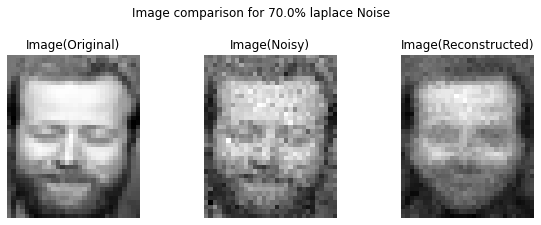

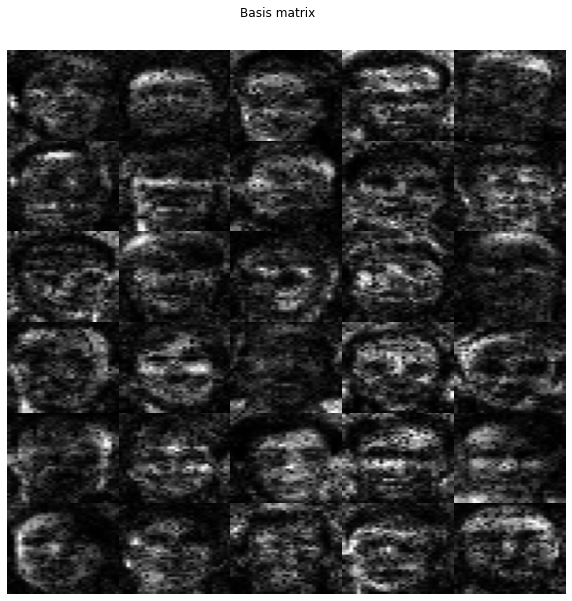

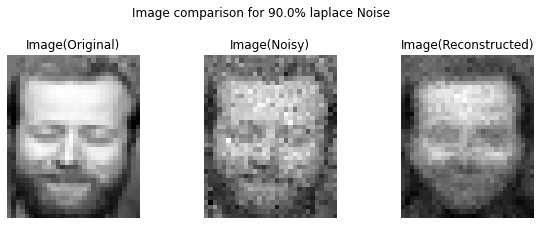

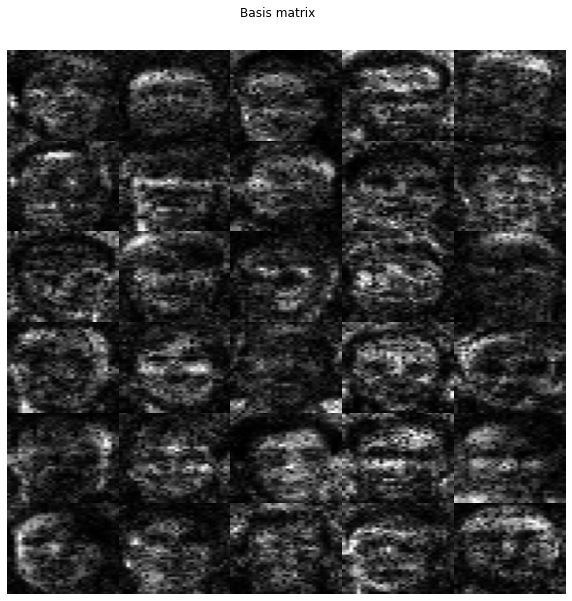

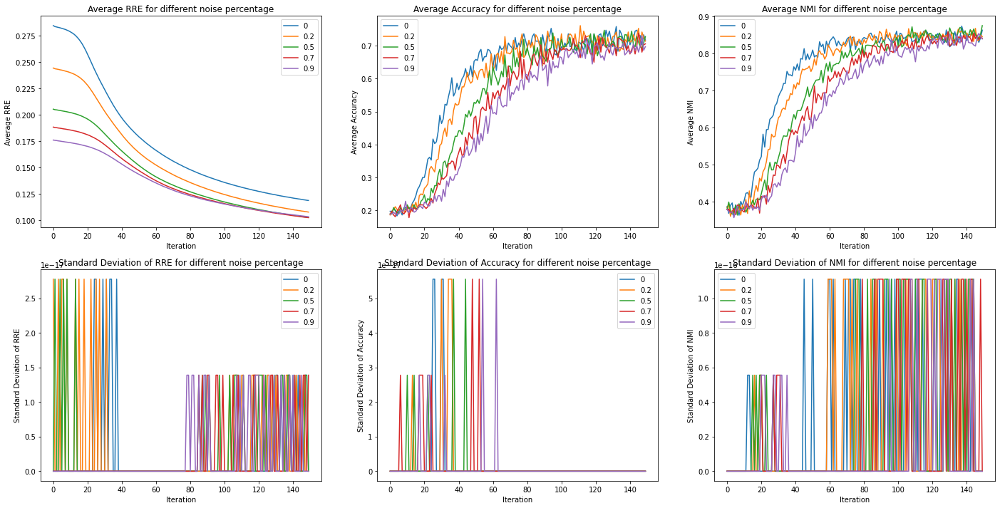

In [390]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "laplace"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "norm"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
#NOISE_PERCENTAGE = [0]
NOISE_PERCENTAGE = [0, 0.20, 0.50, 0.70, 0.90]
RANK = 100
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["rank"] = RANK
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL
for index, noise in enumerate(NOISE_PERCENTAGE):  
    exp_params["key"] = str(noise)
    exp_params["noise"] = noise
    exp_params["image_title"] = "Image comparison for {}% {} Noise".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"])
    D, R, eval_metrics = execute_experiment(X_ORL_Norm, Y_ORL, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/orl_fro_noise.npy", eval_metrics)
plot_result(eval_metrics, "noise percentage")

#### 3.1.2 L2,1 Norm NMF

##### 3.1.2.1 Rank Variation
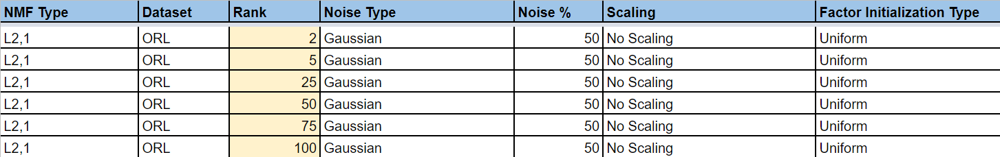

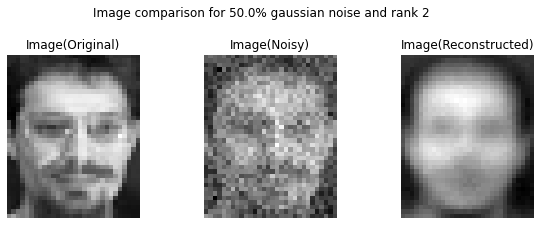

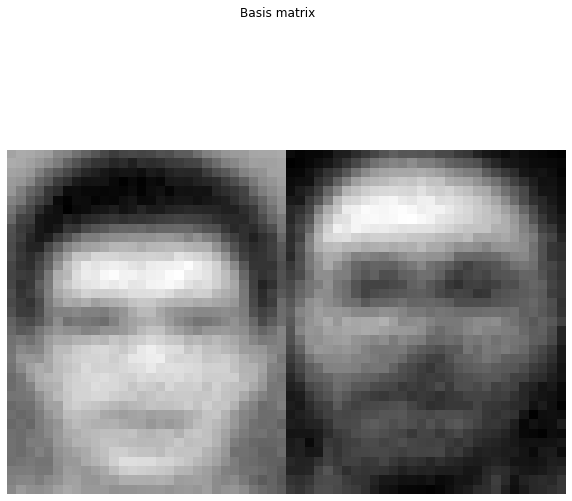

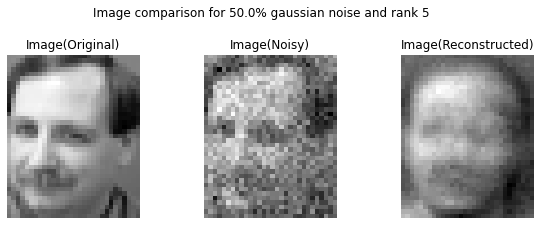

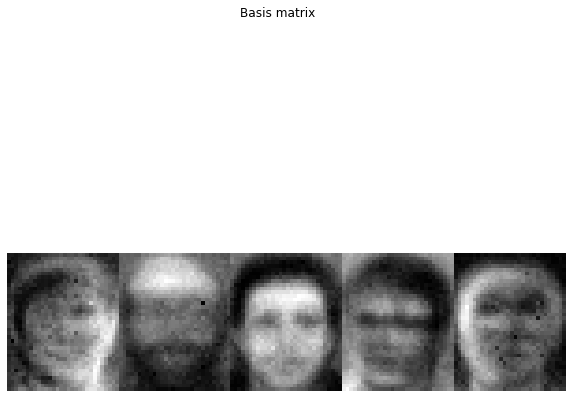

...

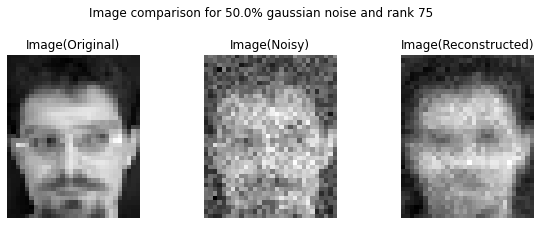

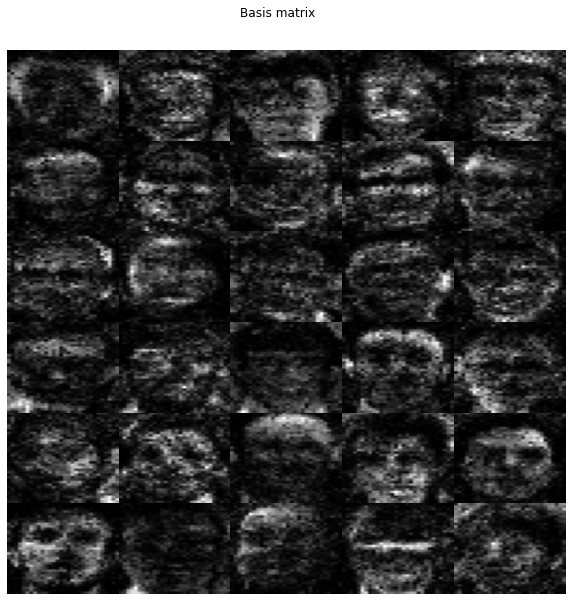

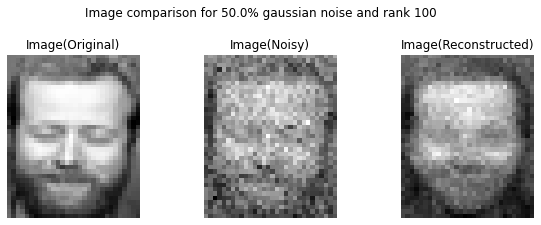

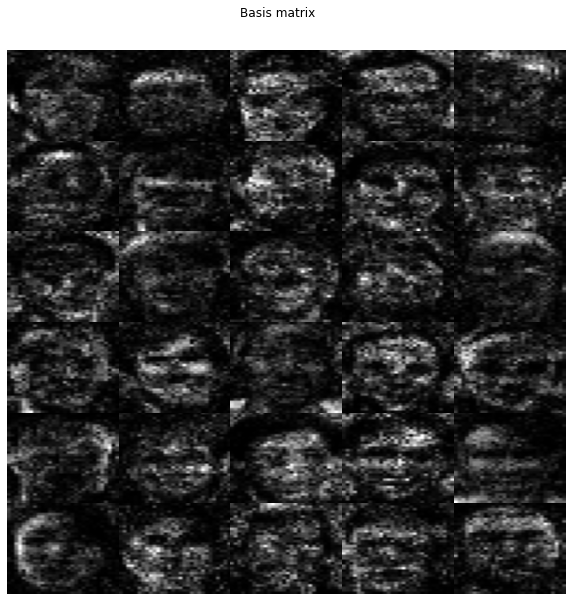

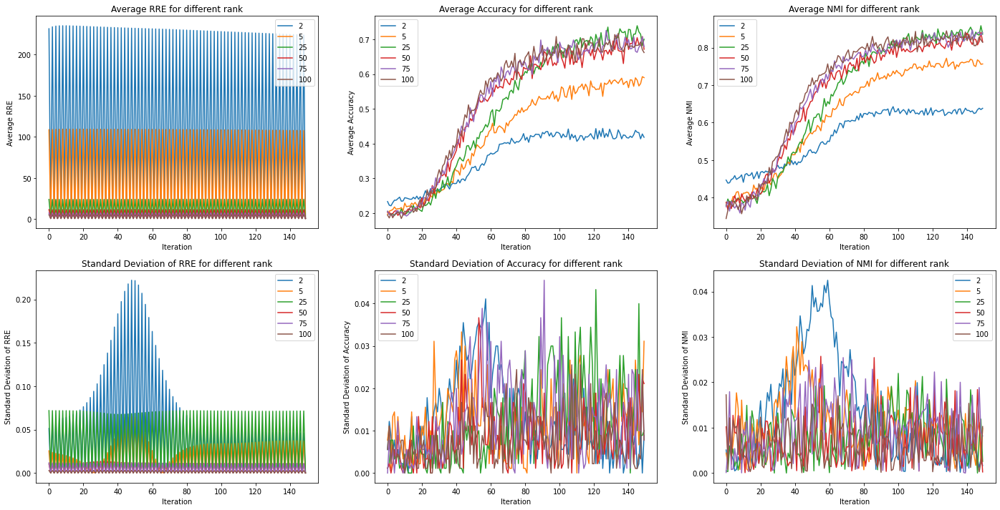

In [420]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "no-scaling"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = [2, 5, 25, 50, 75, 100]
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL

for index, rank in enumerate(RANK): 
    exp_params["key"] = str(rank)
    exp_params["rank"] = rank
    exp_params["image_title"] = "Image comparison for {}% {} noise and rank {}".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["rank"])
    D, R, eval_metrics = execute_experiment(X_ORL, Y_ORL, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/orl_l21_rank_variation.npy", eval_metrics)

plot_result(eval_metrics, "rank")

##### 3.1.2.2 Factor Initialization Variation
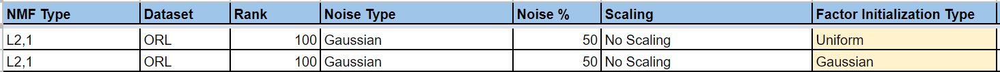

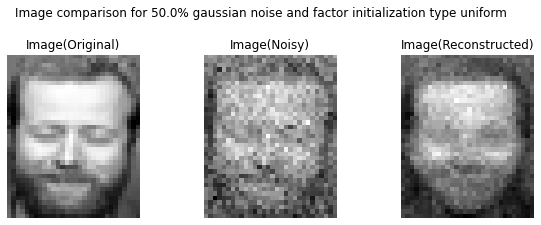

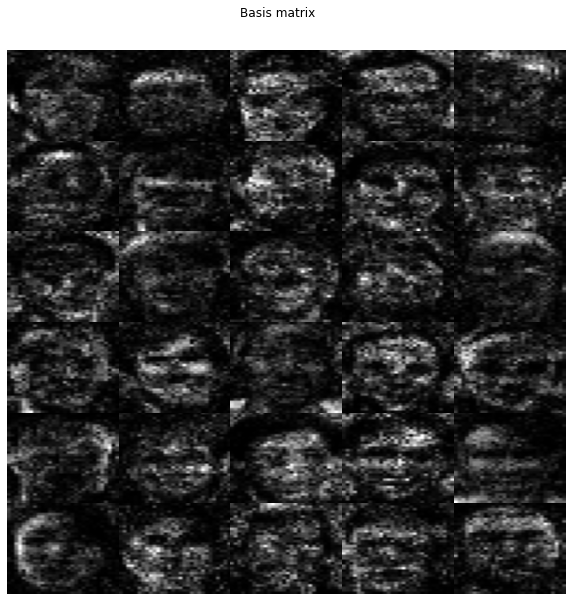

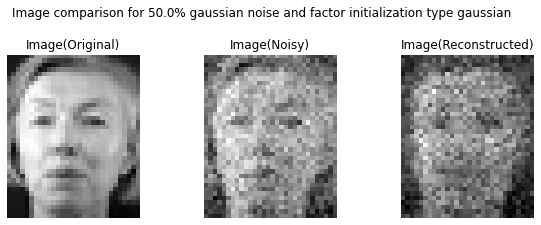

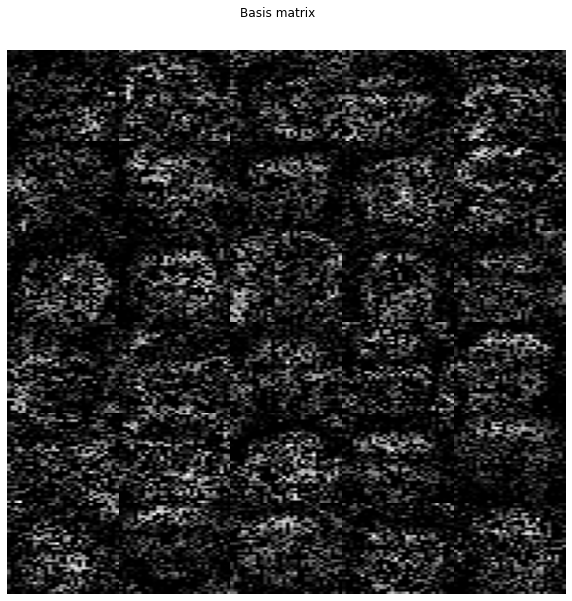

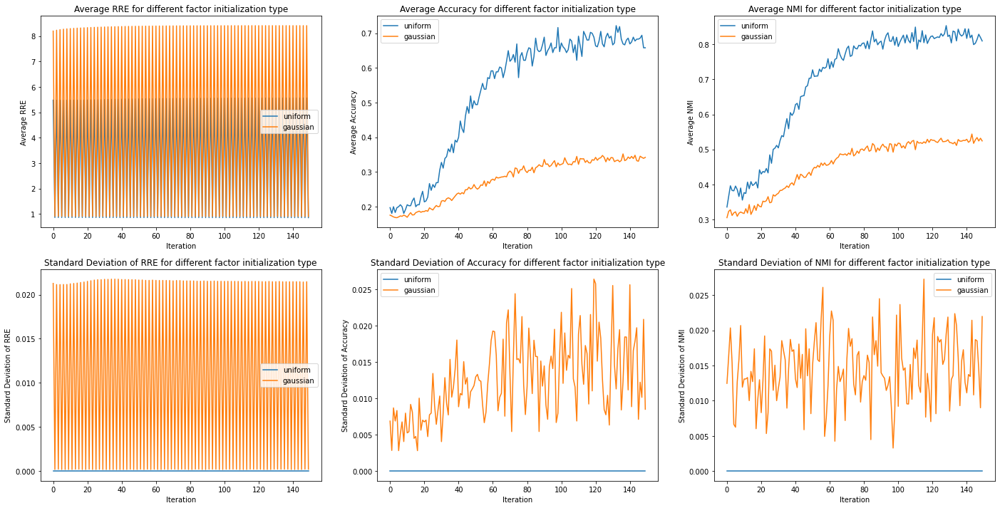

In [421]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = ["uniform", "gaussian"]

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "no-scaling"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 100
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["rank"] = RANK
exp_params["scaling_type"] = SCALING_TYPE
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL

for index, init_type in enumerate(FACTORS_INIT_TYPE): 
    exp_params["key"] = str(init_type)
    exp_params["factors_init_type"] = init_type
    exp_params["image_title"] = "Image comparison for {}% {} noise and factor initialization type {}".format(
                                                                     exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["factors_init_type"])
        
    D, R, eval_metrics = execute_experiment(X_ORL, Y_ORL, REPEAT, exp_params, eval_metrics)          

# Save result for future reference
save_result("result/orl_l21_factor_init.npy", eval_metrics)
plot_result(eval_metrics, "factor initialization type")

##### 3.1.2.3 Scaling Variation
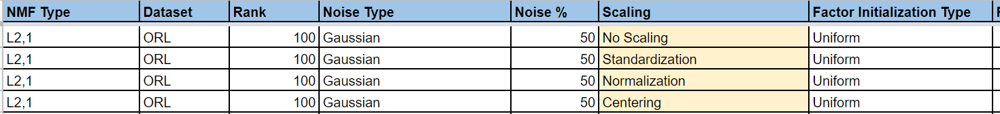

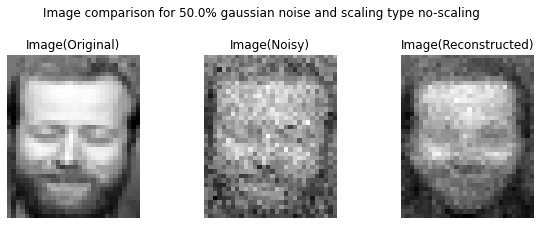

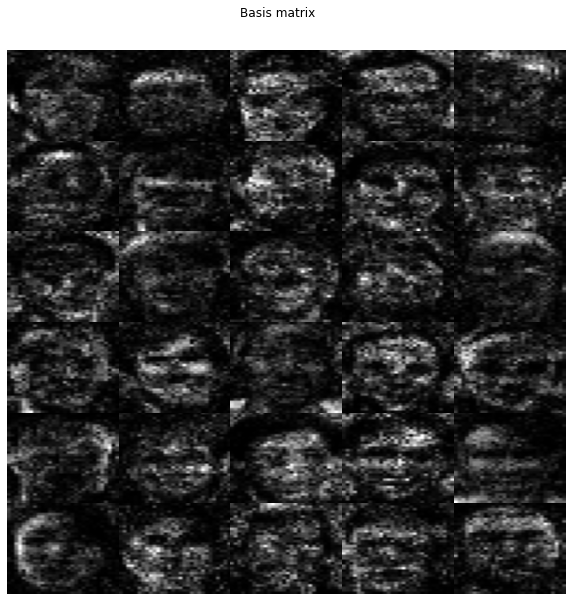

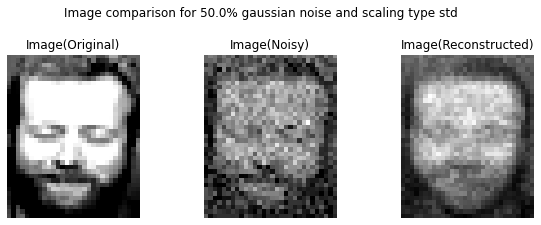

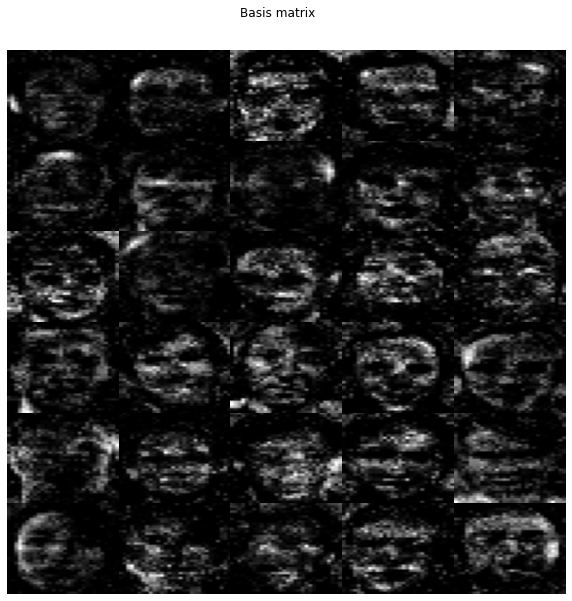

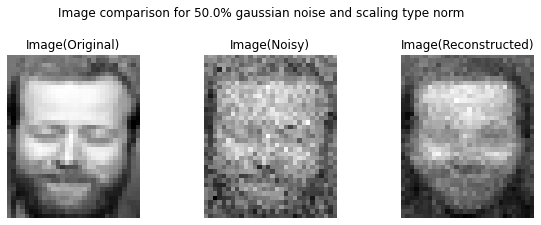

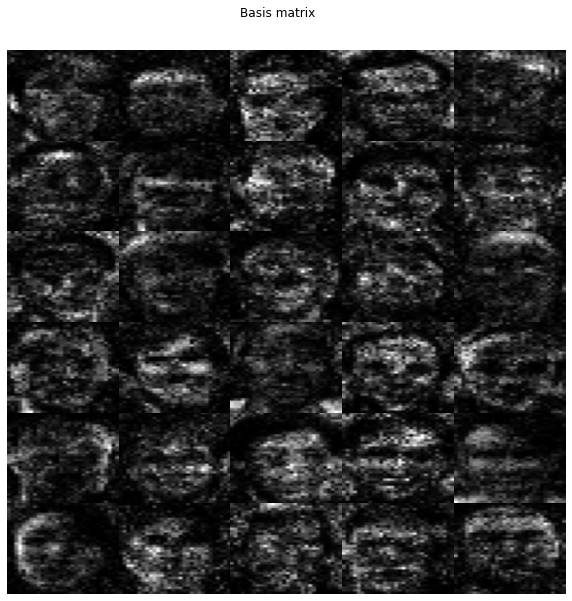

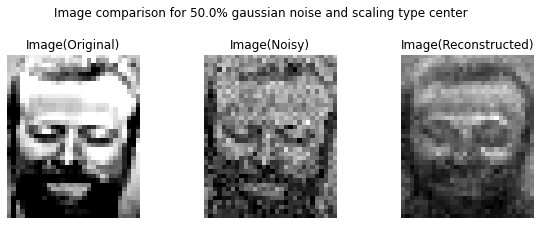

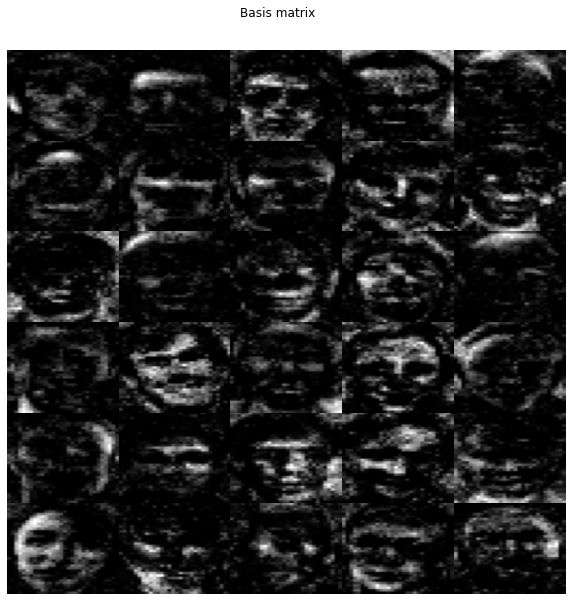

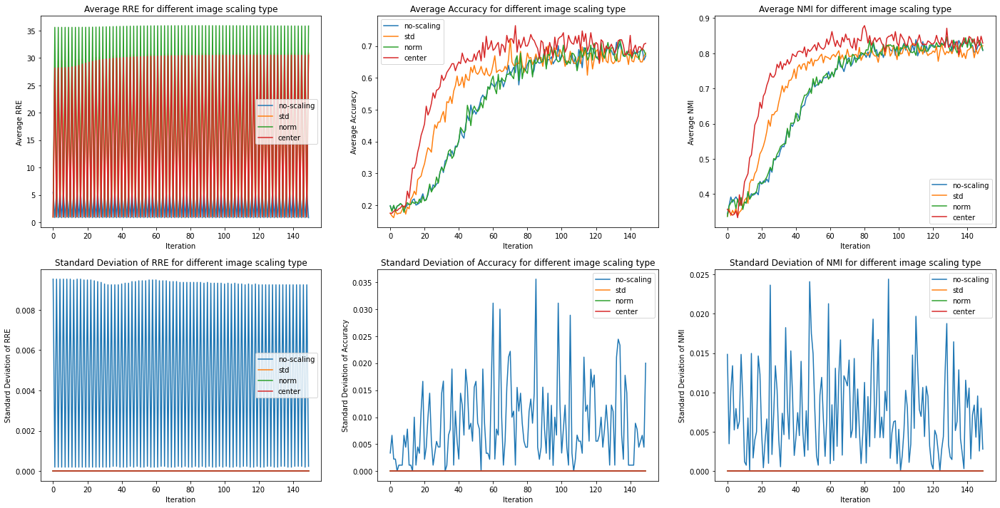

In [422]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = ["no-scaling", "std", "norm", "center"]

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 100
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["rank"] = RANK
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL

for index, scaling_type in enumerate(SCALING_TYPE): 
    exp_params["key"] = str(scaling_type)
    exp_params["scaling_type"] = scaling_type
    exp_params["image_title"] = "Image comparison for {}% {} noise and scaling type {}".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["scaling_type"])
    if scaling_type == "std":
        D, R, eval_metrics = execute_experiment(X_ORL_Std, Y_ORL, REPEAT, exp_params, eval_metrics)   
    elif scaling_type == "norm":
        D, R, eval_metrics = execute_experiment(X_ORL_Norm, Y_ORL, REPEAT, exp_params, eval_metrics)    
    elif scaling_type == "center":
        D, R, eval_metrics = execute_experiment(X_ORL_Center, Y_ORL, REPEAT, exp_params, eval_metrics)    
    else:
        D, R, eval_metrics = execute_experiment(X_ORL, Y_ORL, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/orl_l21_scaling_type.npy", eval_metrics)
plot_result(eval_metrics, "image scaling type")

##### 3.1.2.4 Noise Type Variation
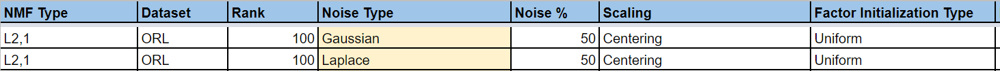

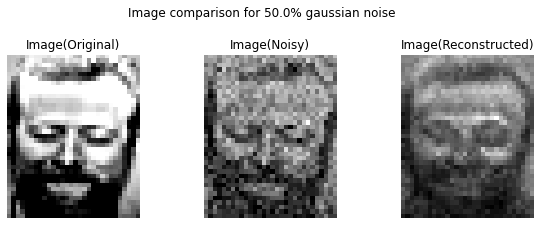

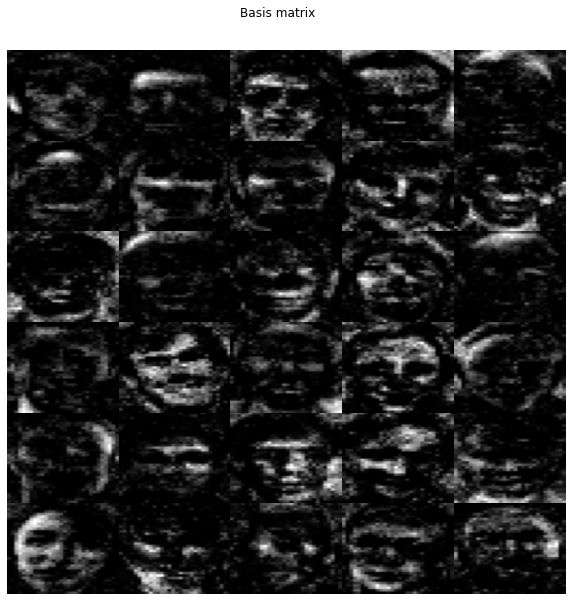

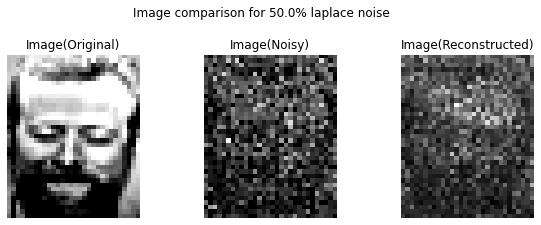

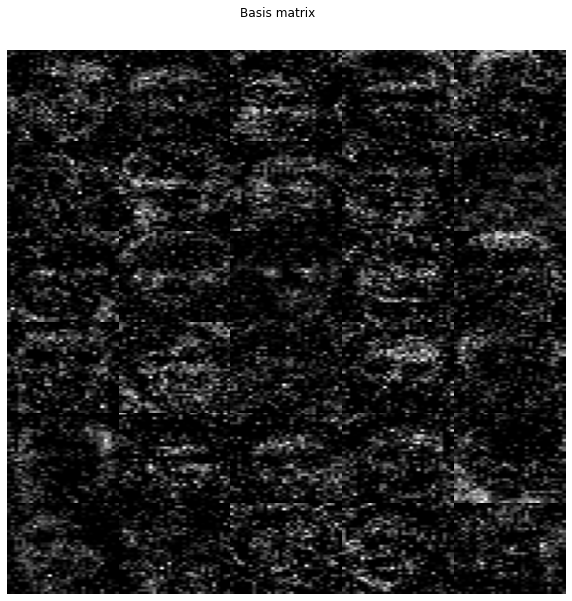

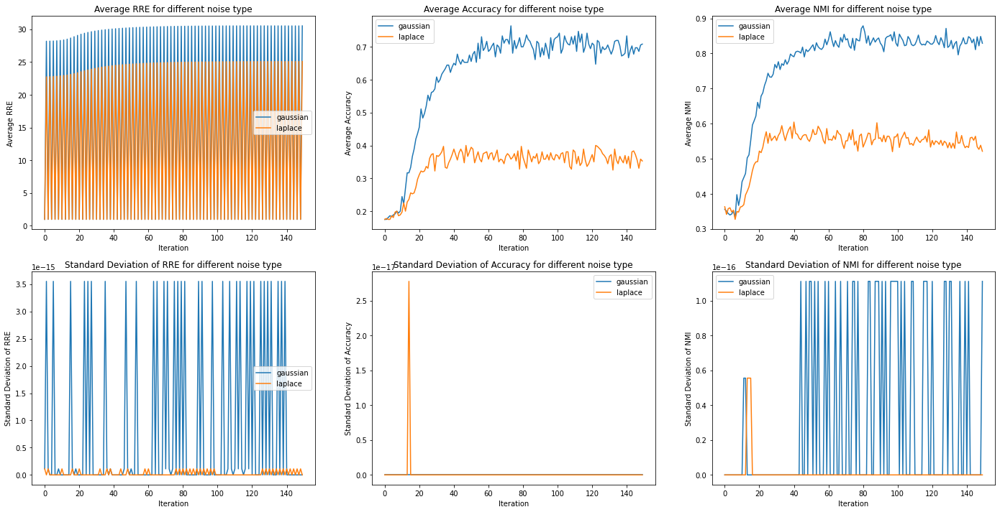

In [423]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = ["gaussian", "laplace"]

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "center"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 100
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["rank"] = RANK
exp_params["scaling_type"] = SCALING_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL

for index, noise_type in enumerate(NOISE_TYPE): 
    exp_params["key"] = str(noise_type)
    exp_params["noise_type"] = noise_type
    exp_params["image_title"] = "Image comparison for {}% {} noise".format(
                                                                     exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"])
        
    D, R, eval_metrics = execute_experiment(X_ORL_Center, Y_ORL, REPEAT, exp_params, eval_metrics)     

# Save result for future reference
save_result("result/orl_l21_noise_type.npy", eval_metrics)
plot_result(eval_metrics, "noise type")

##### 3.1.2.5 Noise Variation
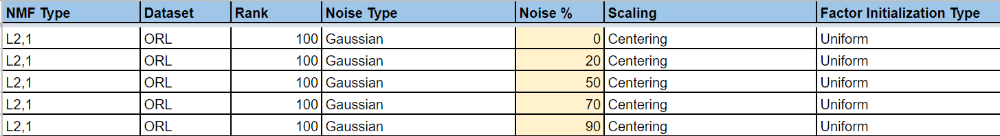

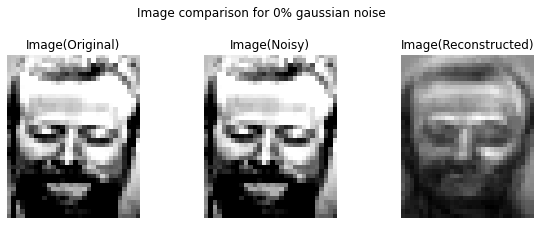

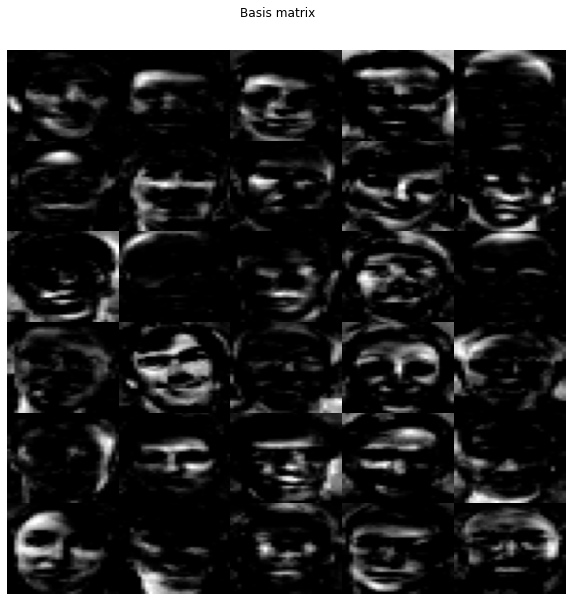

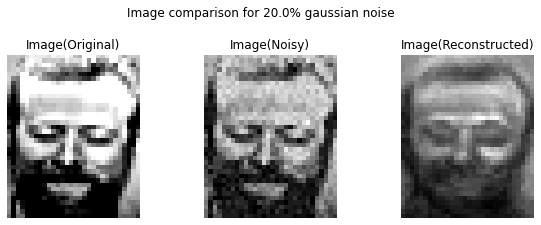

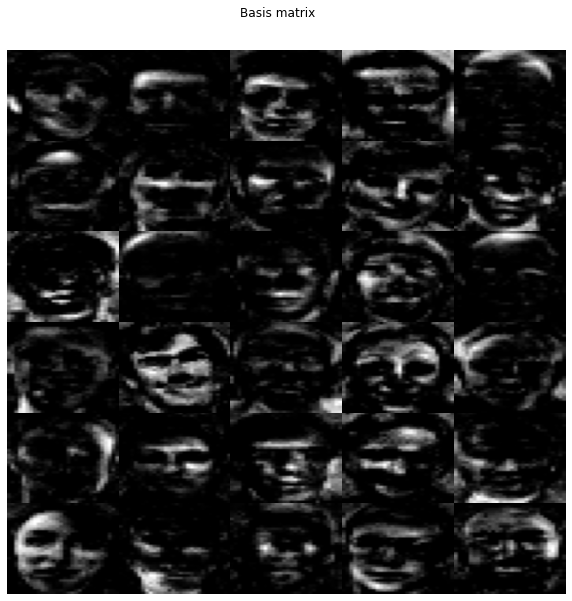

...

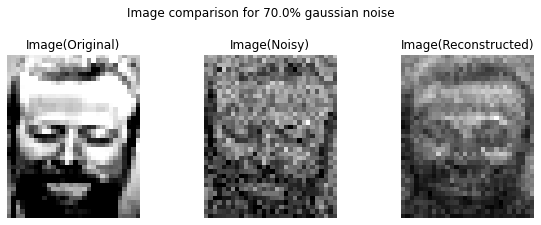

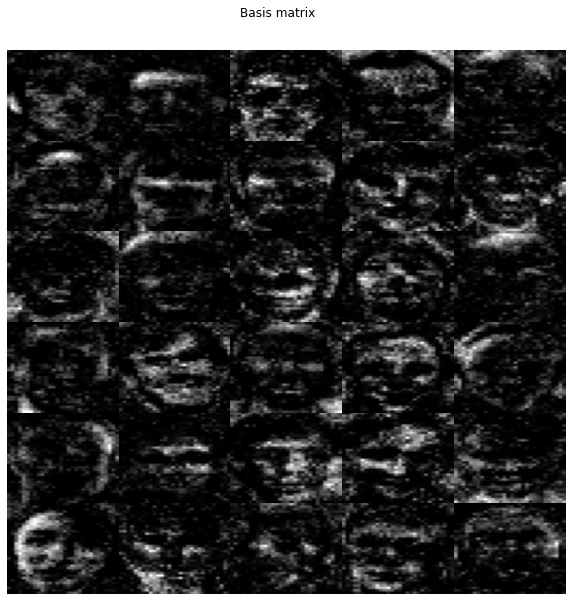

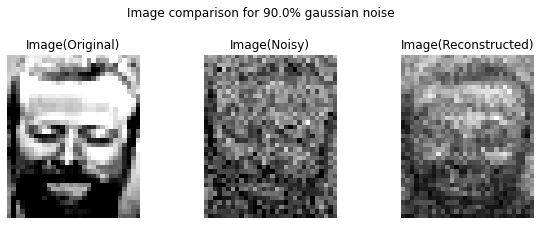

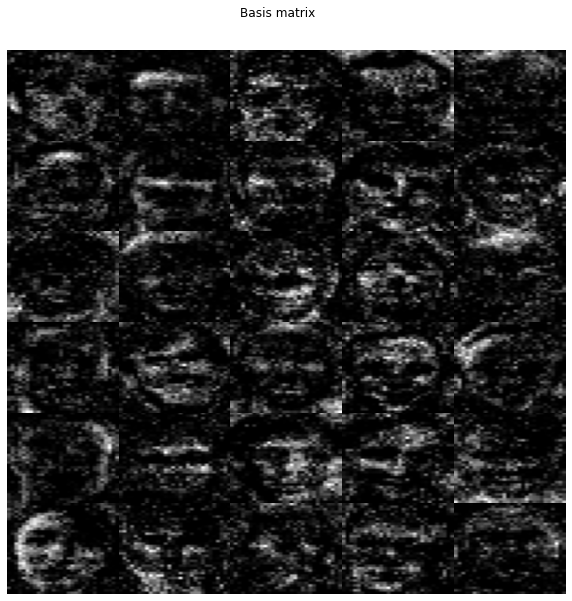

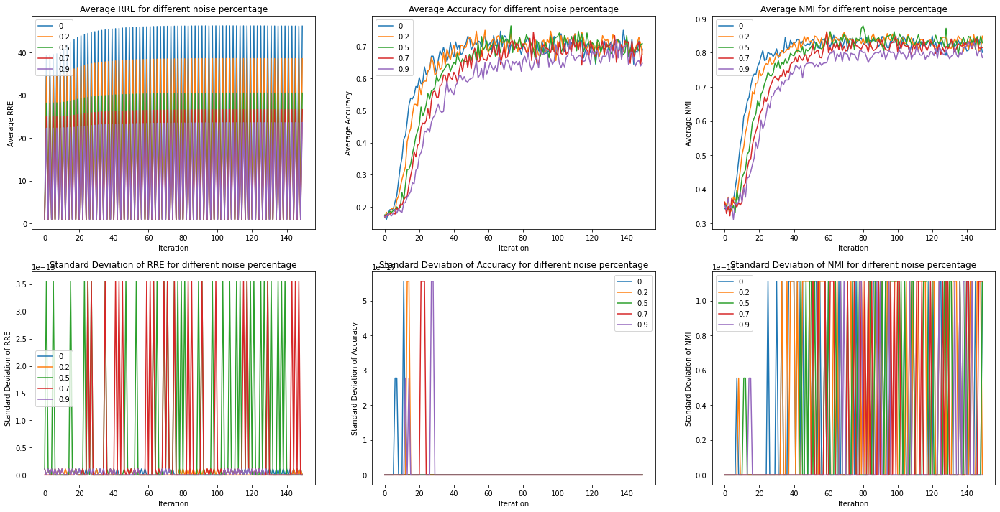

In [424]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "center"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = [0, 0.20, 0.50, 0.70, 0.90]
RANK = 100
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["rank"] = RANK
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL

for index, noise in enumerate(NOISE_PERCENTAGE):  
    exp_params["key"] = str(noise)
    exp_params["noise"] = noise
    exp_params["image_title"] = "Image comparison for {}% {} noise".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"])
    D, R, eval_metrics = execute_experiment(X_ORL_Center, Y_ORL, REPEAT, exp_params, eval_metrics)   
    
# Save result for future reference
save_result("result/orl_l21_noise.npy", eval_metrics)
plot_result(eval_metrics, "noise percentage")

### 3.2 YaleB Dataset

#### 3.2.1 Frobenius Norm NMF

##### 3.2.1.1 Rank Variation
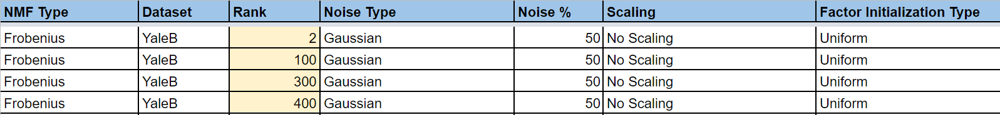

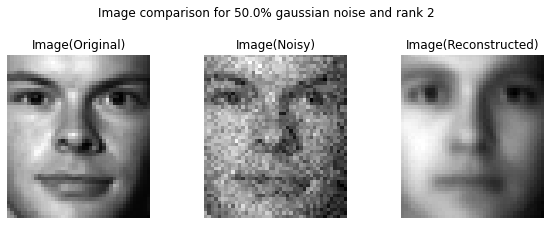

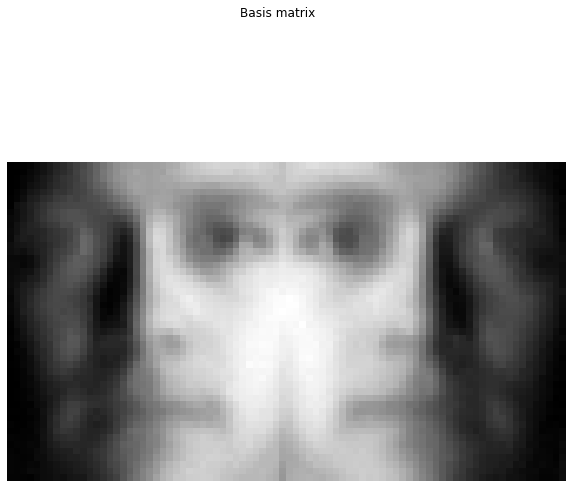

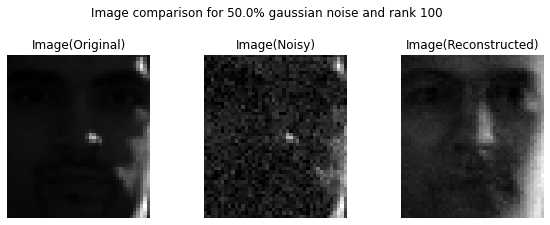

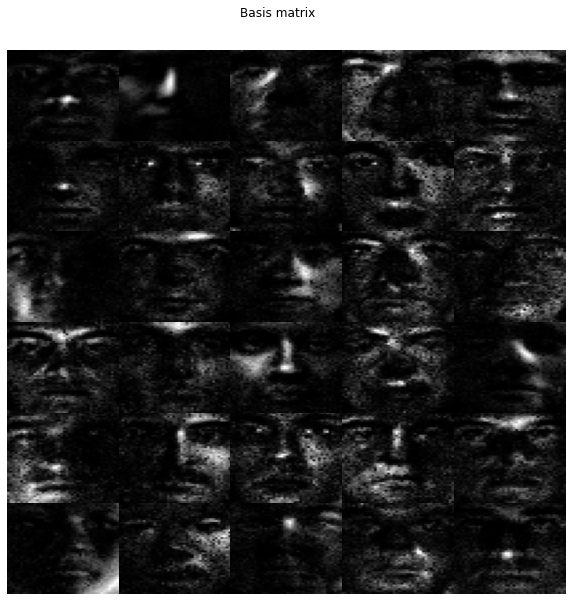

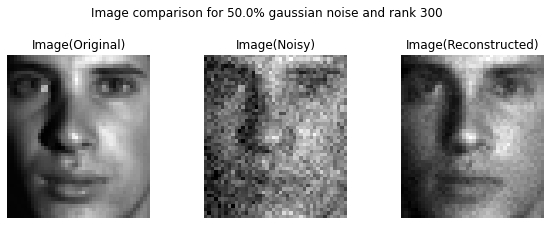

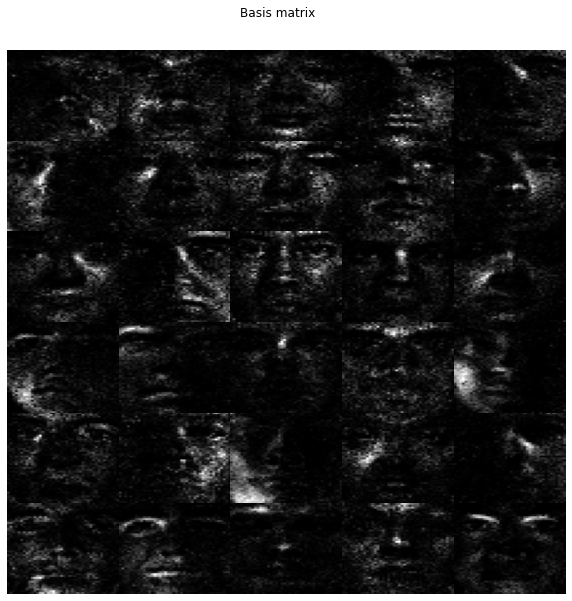

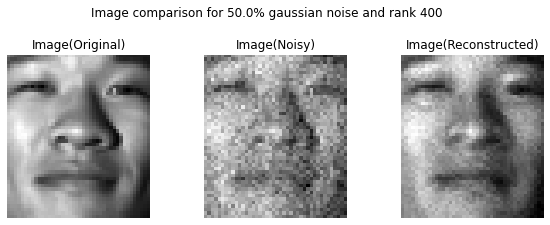

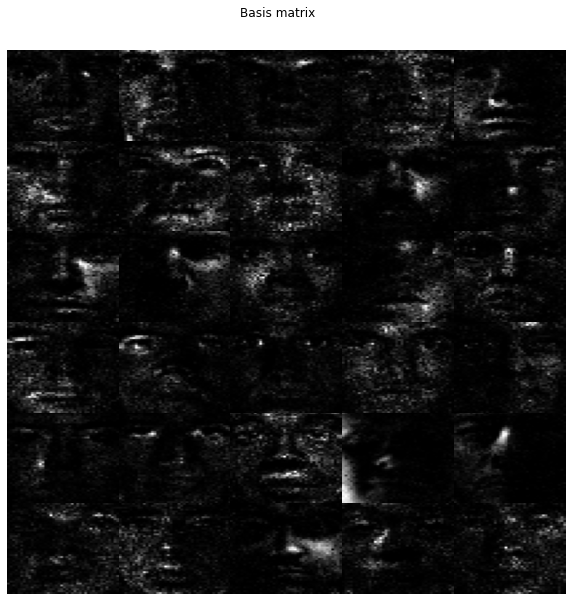

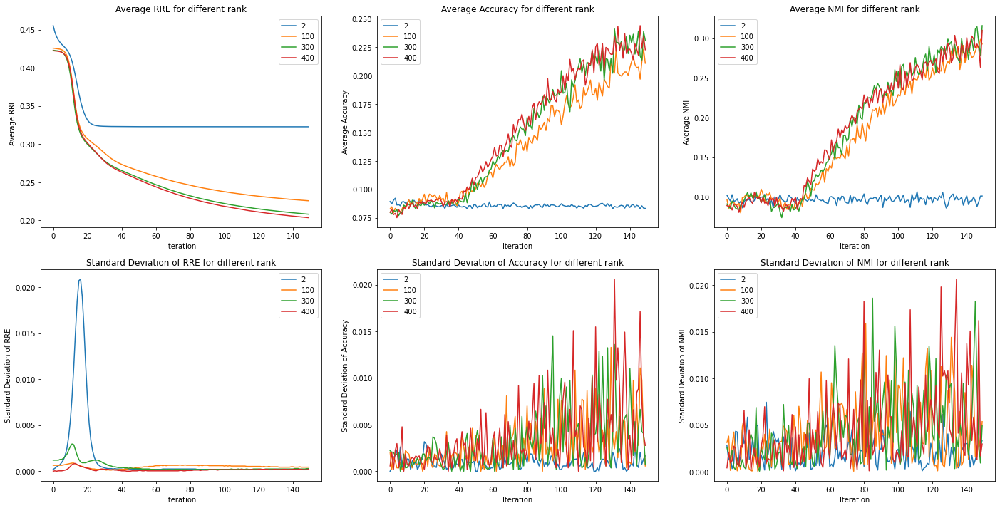

In [386]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "no-scaling"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = [2, 100, 300, 400]
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB

for index, rank in enumerate(RANK): 
    exp_params["key"] = str(rank)
    exp_params["rank"] = rank
    exp_params["image_title"] = "Image comparison for {}% {} noise and rank {}".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["rank"])
    D, R, eval_metrics = execute_experiment(X_YaleB, Y_YaleB, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/yaleb_fro_rank_variation.npy", eval_metrics)
plot_result(eval_metrics, "rank")

##### 3.2.1.2 Factor Initialization Variation
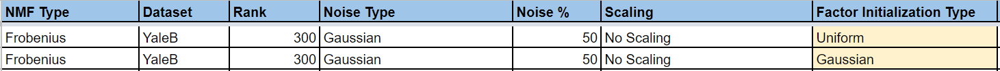

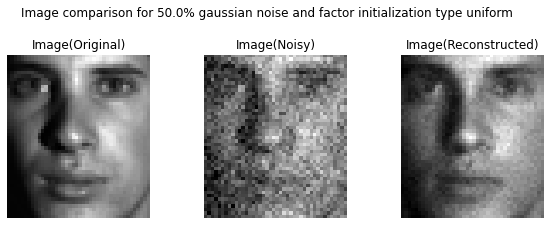

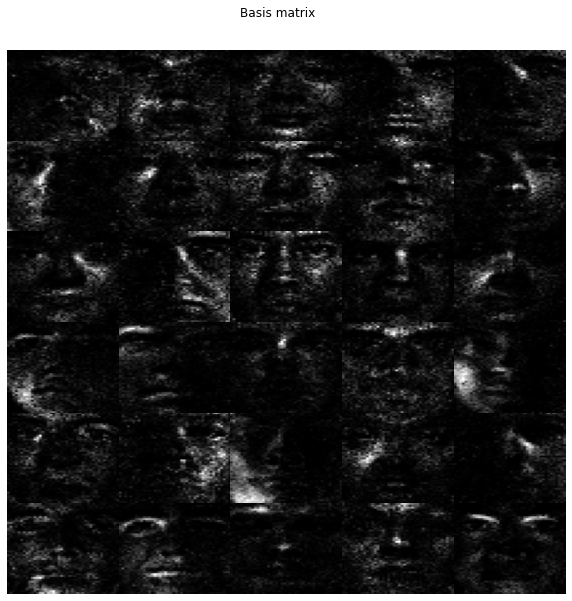

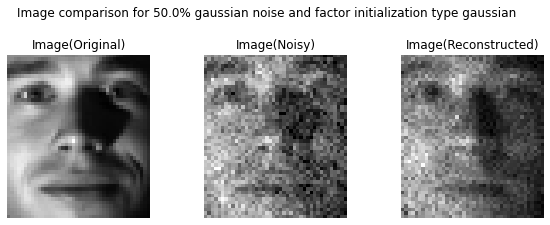

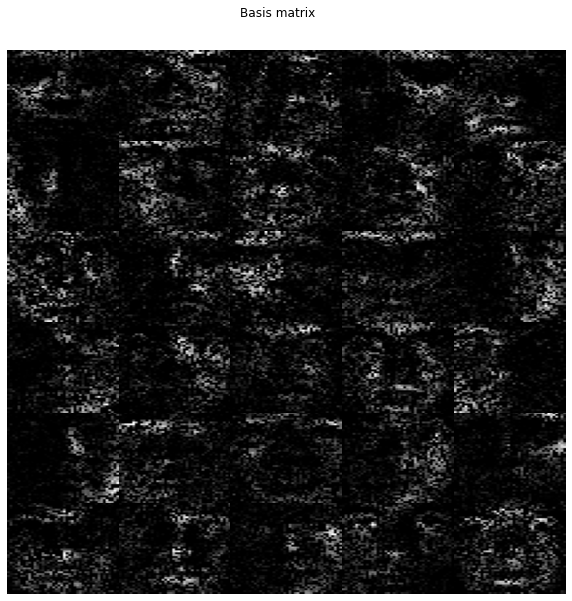

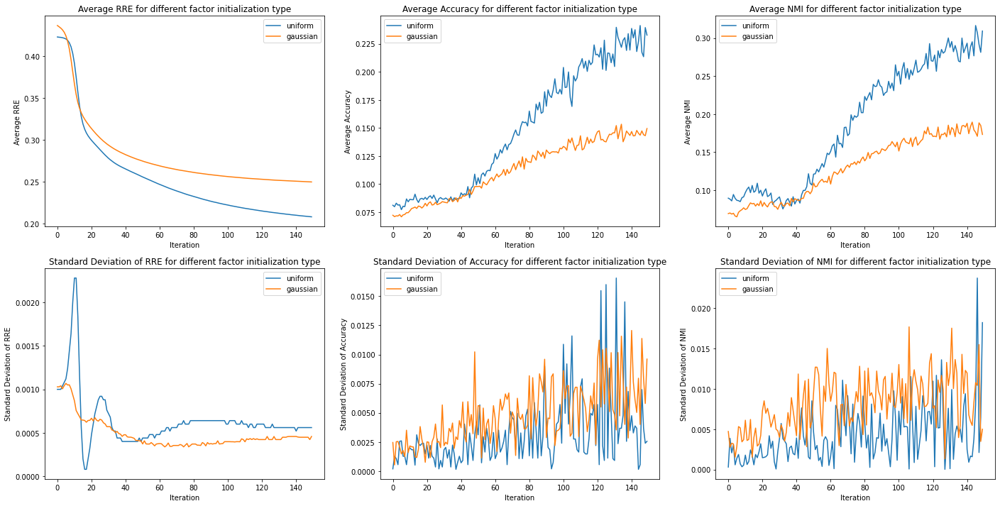

In [396]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = ["uniform", "gaussian"]

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "no-scaling"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 300
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["rank"] = RANK
exp_params["scaling_type"] = SCALING_TYPE
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB

for index, init_type in enumerate(FACTORS_INIT_TYPE): 
    exp_params["key"] = str(init_type)
    exp_params["factors_init_type"] = init_type
    exp_params["image_title"] = "Image comparison for {}% {} noise and factor initialization type {}".format(
                                                                     exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["factors_init_type"])
        
    D, R, eval_metrics = execute_experiment(X_YaleB, Y_YaleB, REPEAT, exp_params, eval_metrics)          

# Save result for future reference
save_result("result/yaleb_fro_factor_init.npy", eval_metrics)
plot_result(eval_metrics, "factor initialization type")

##### 3.2.1.3 Scaling Variation
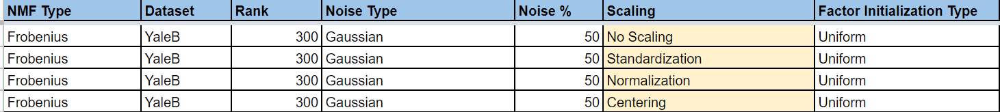

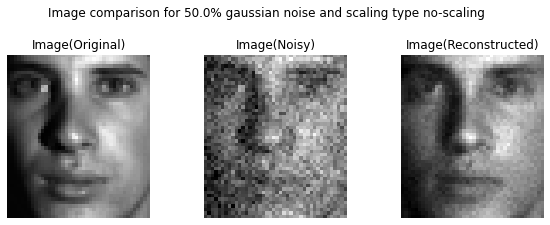

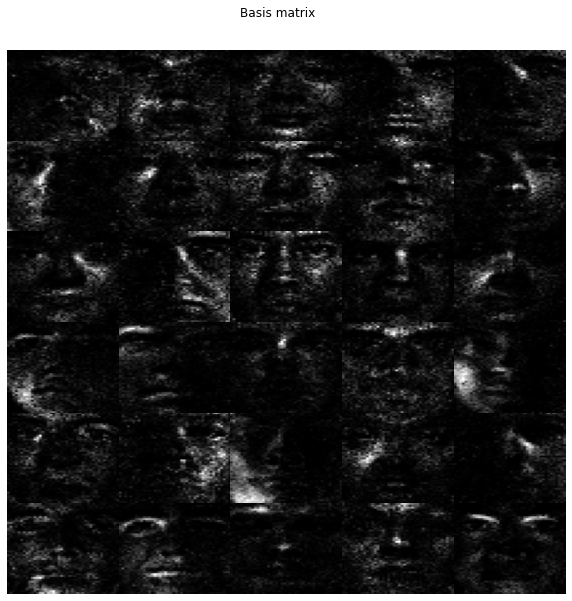

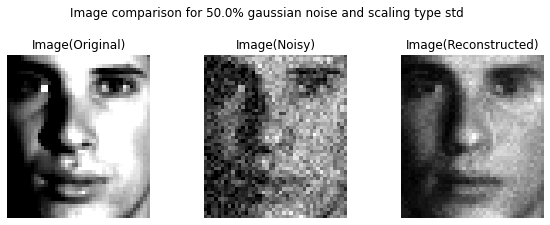

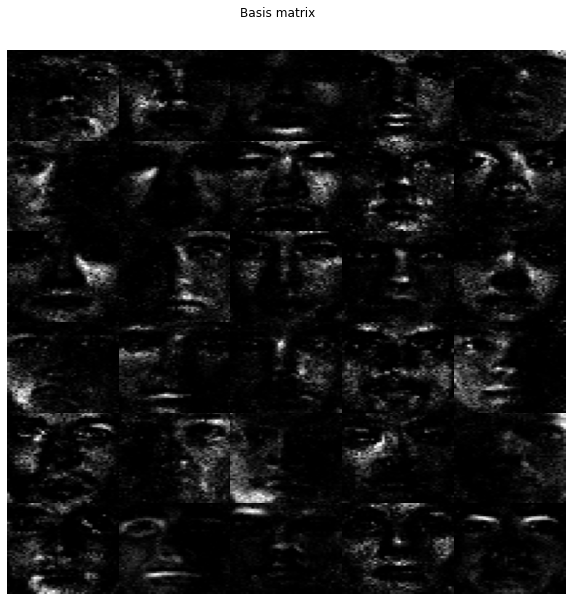

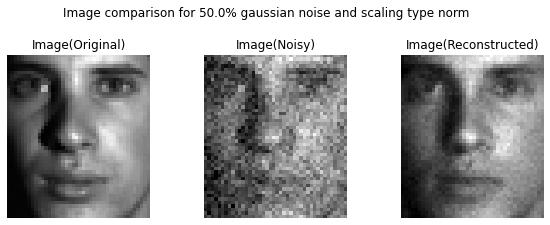

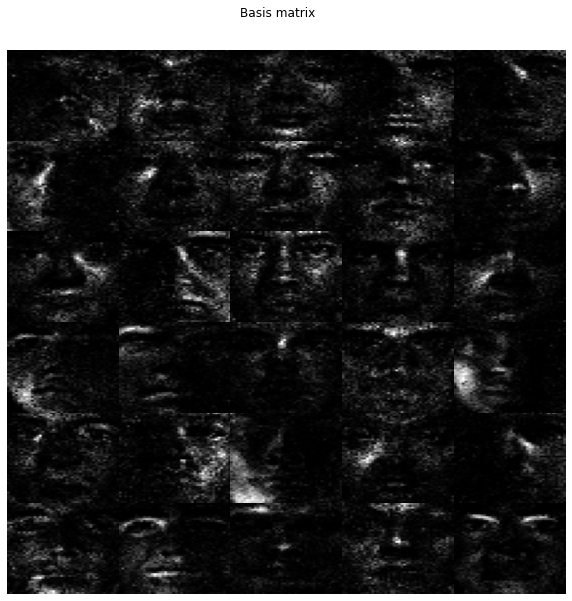

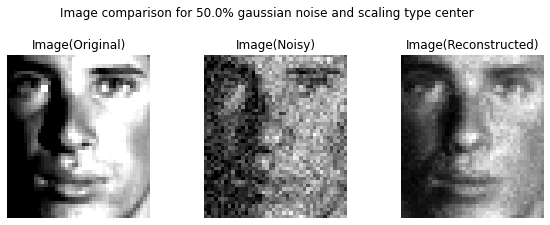

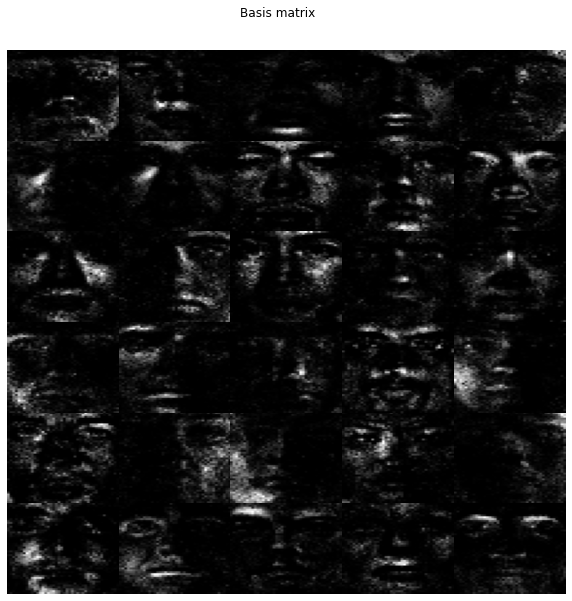

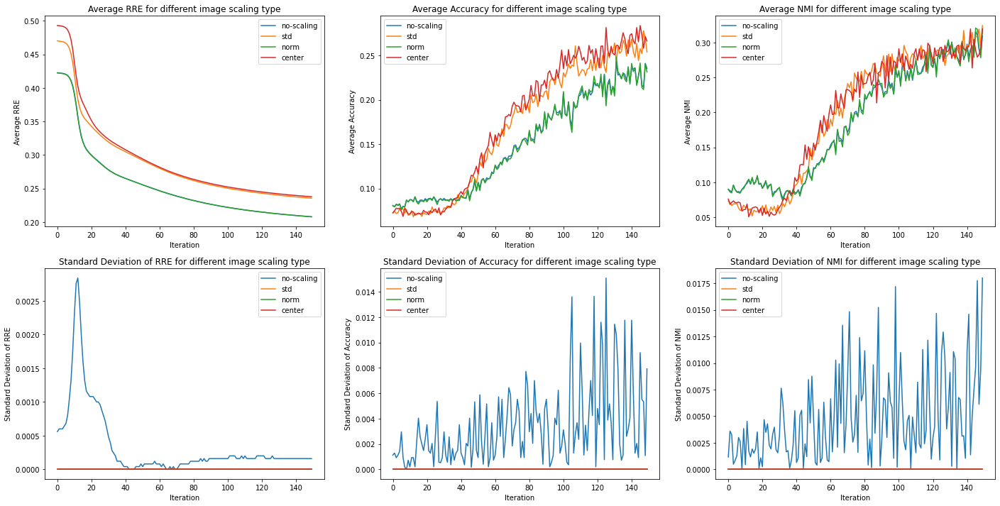

In [397]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = ["no-scaling", "std", "norm", "center"]

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 300
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["rank"] = RANK
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB

for index, scaling_type in enumerate(SCALING_TYPE): 
    exp_params["key"] = str(scaling_type)
    exp_params["scaling_type"] = scaling_type
    exp_params["image_title"] = "Image comparison for {}% {} noise and scaling type {}".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["scaling_type"])
    if scaling_type == "std":
        D, R, eval_metrics = execute_experiment(X_YaleB_Std, Y_YaleB, REPEAT, exp_params, eval_metrics)   
    elif scaling_type == "norm":
        D, R, eval_metrics = execute_experiment(X_YaleB_Norm, Y_YaleB, REPEAT, exp_params, eval_metrics)    
    elif scaling_type == "center":
        D, R, eval_metrics = execute_experiment(X_YaleB_Center, Y_YaleB, REPEAT, exp_params, eval_metrics)    
    else:
        D, R, eval_metrics = execute_experiment(X_YaleB, Y_YaleB, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/yaleb_fro_scaling_type.npy", eval_metrics)
plot_result(eval_metrics, "image scaling type")

##### 3.2.1.4 Noise Type Variation
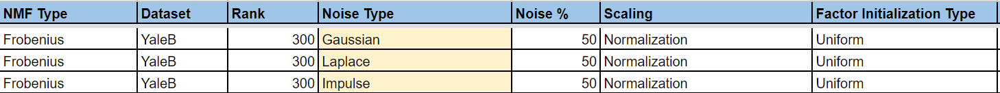

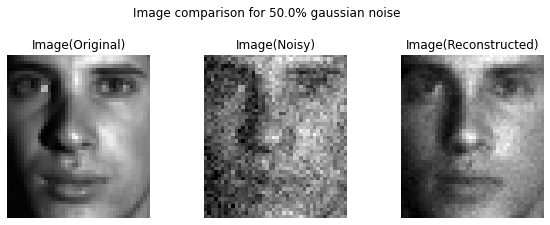

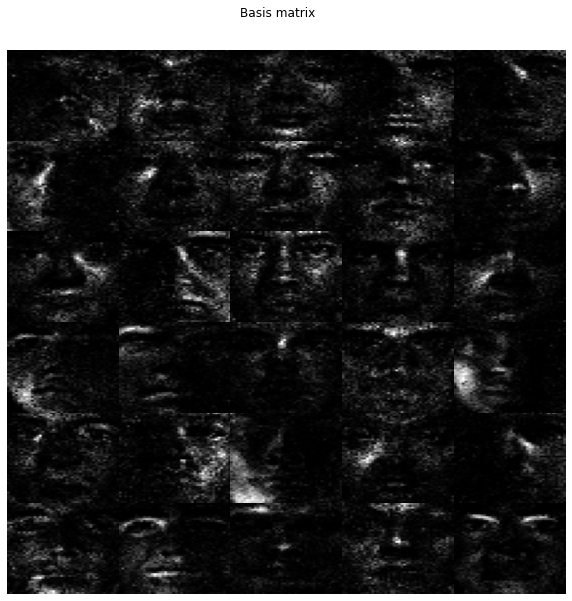

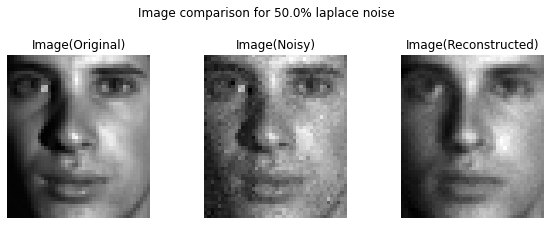

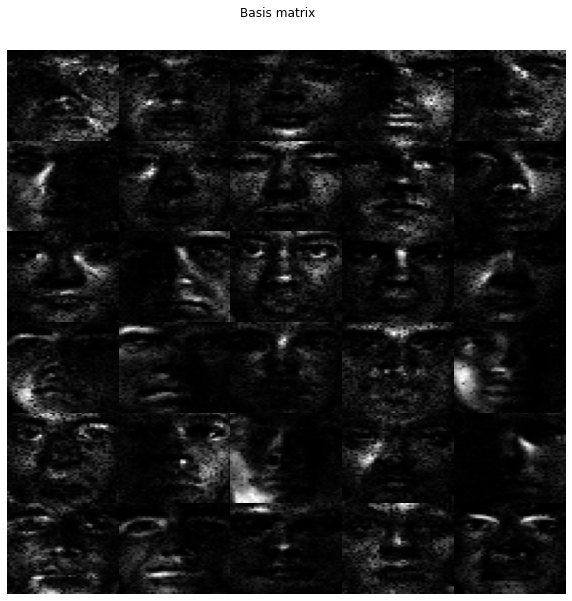

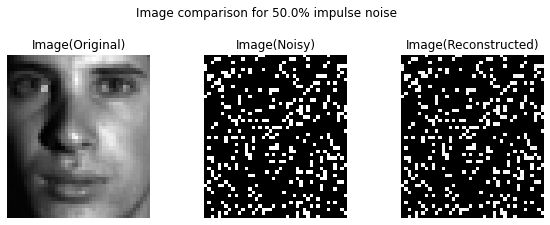

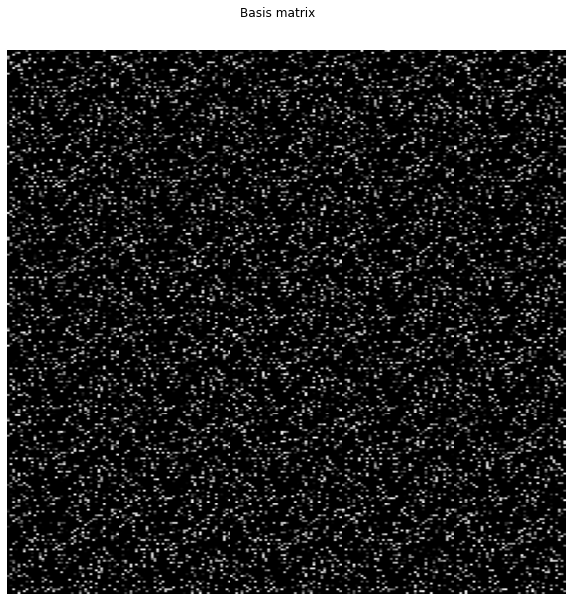

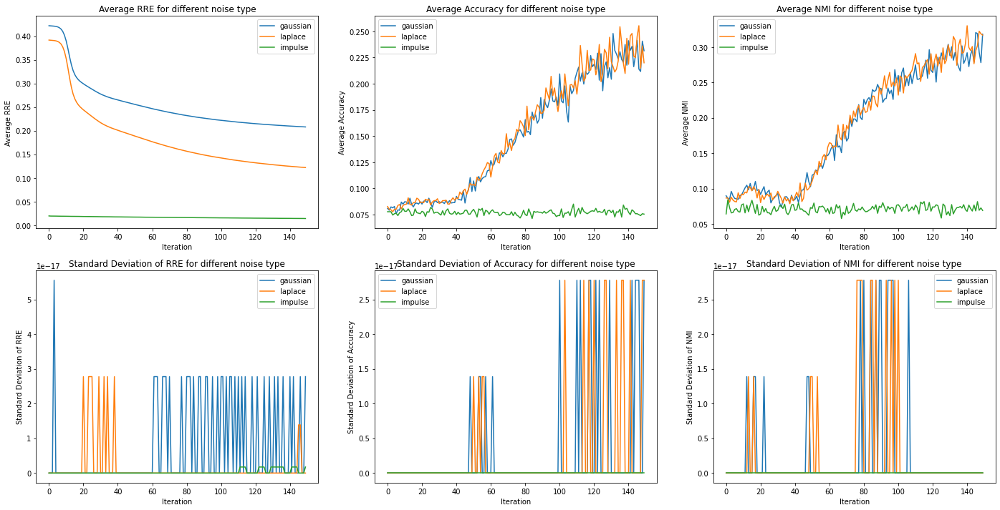

In [398]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = ["gaussian", "laplace", "impulse"]

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "norm"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 300
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["rank"] = RANK
exp_params["scaling_type"] = SCALING_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB

for index, noise_type in enumerate(NOISE_TYPE): 
    exp_params["key"] = str(noise_type)
    exp_params["noise_type"] = noise_type
    exp_params["image_title"] = "Image comparison for {}% {} noise".format(
                                                                     exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"])
        
    D, R, eval_metrics = execute_experiment(X_YaleB_Norm, Y_YaleB, REPEAT, exp_params, eval_metrics)    
    
# Save result for future reference
save_result("result/yaleb_fro_noise_type.npy", eval_metrics)
plot_result(eval_metrics, "noise type")

##### 3.2.1.5 Noise Variation
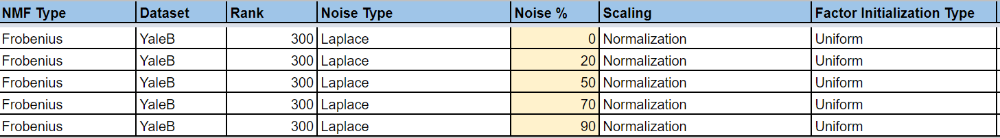

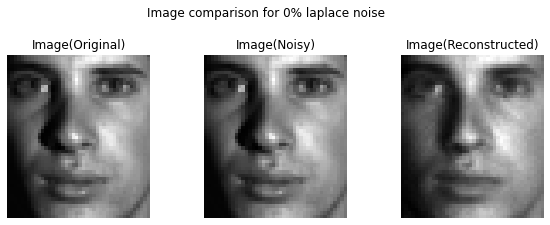

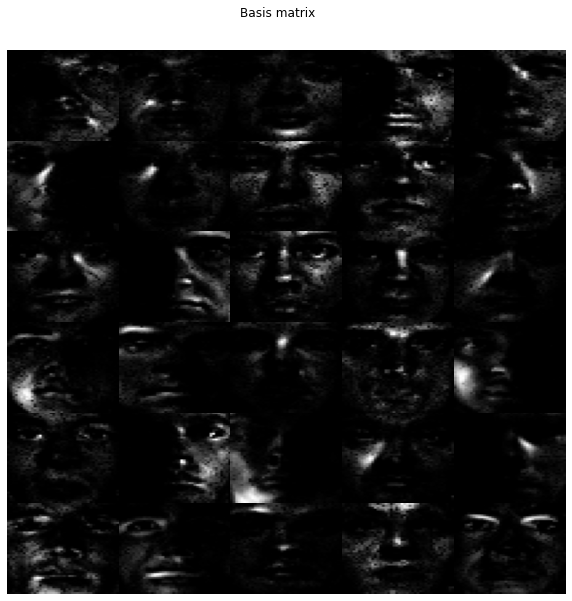

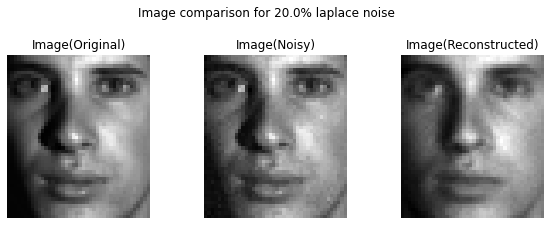

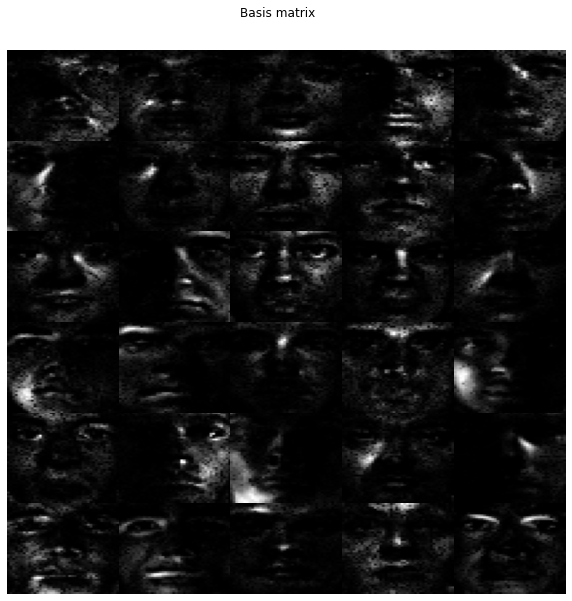

...

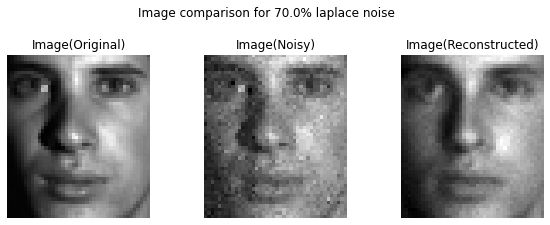

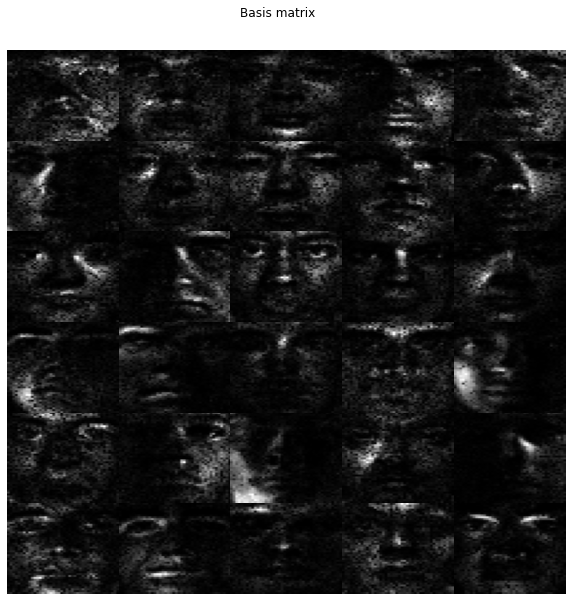

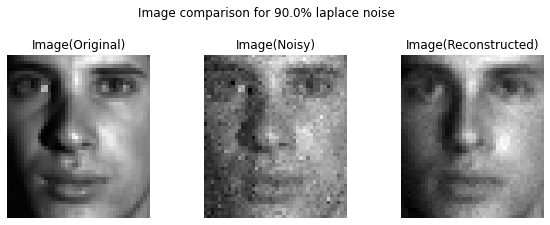

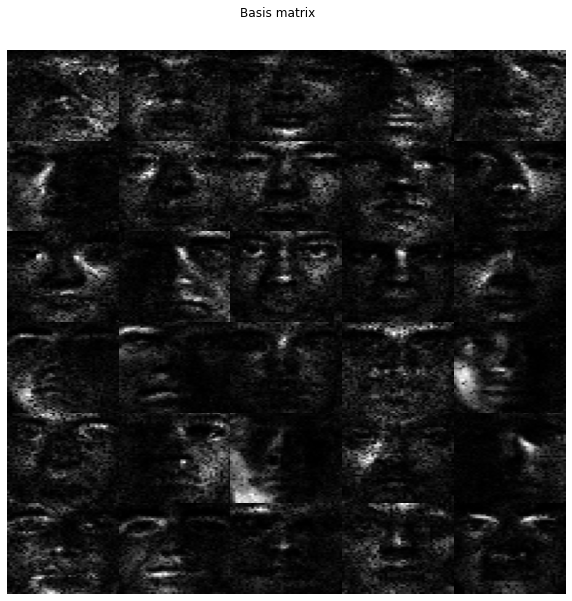

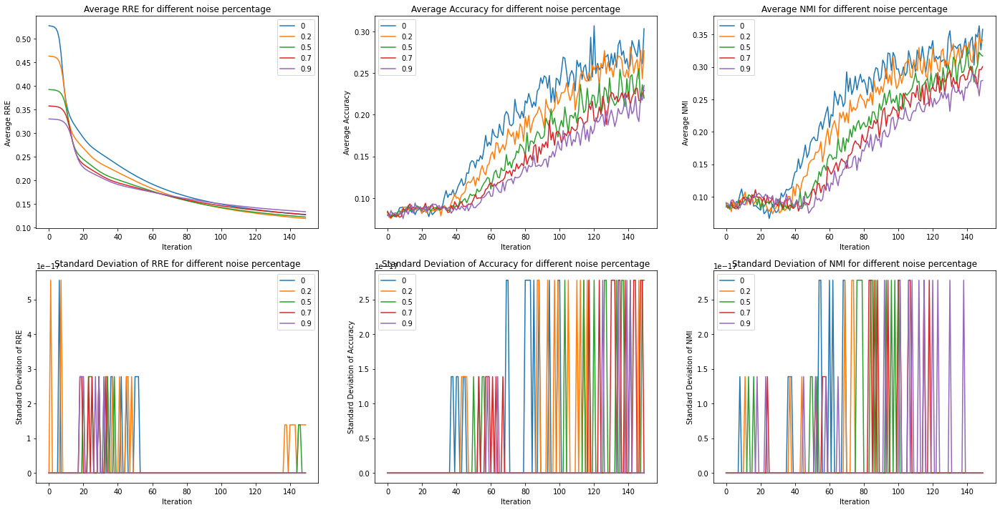

In [399]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "frobenius"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "laplace"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "norm"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = [0, 0.20, 0.50, 0.70, 0.90]
RANK = 300
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["rank"] = RANK
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB
for index, noise in enumerate(NOISE_PERCENTAGE):  
    exp_params["key"] = str(noise)
    exp_params["noise"] = noise
    exp_params["image_title"] = "Image comparison for {}% {} noise".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"])
    D, R, eval_metrics = execute_experiment(X_YaleB_Norm, Y_YaleB, REPEAT, exp_params, eval_metrics)    
    
# Save result for future reference
save_result("result/yaleb_fro_noise.npy", eval_metrics)
plot_result(eval_metrics, "noise percentage")

#### 3.2.2 L2,1 Norm NMF

##### 3.2.2.1 Rank Variation
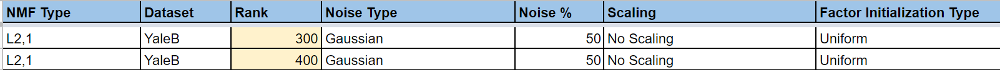

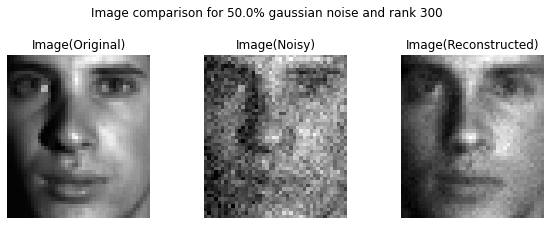

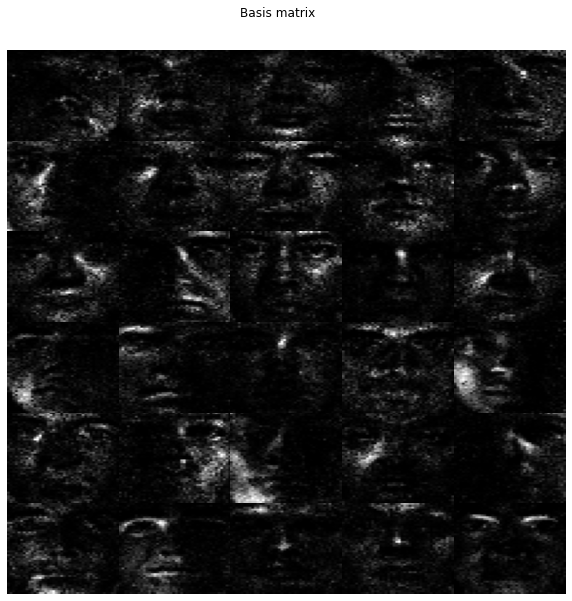

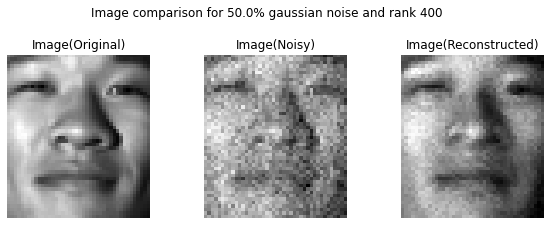

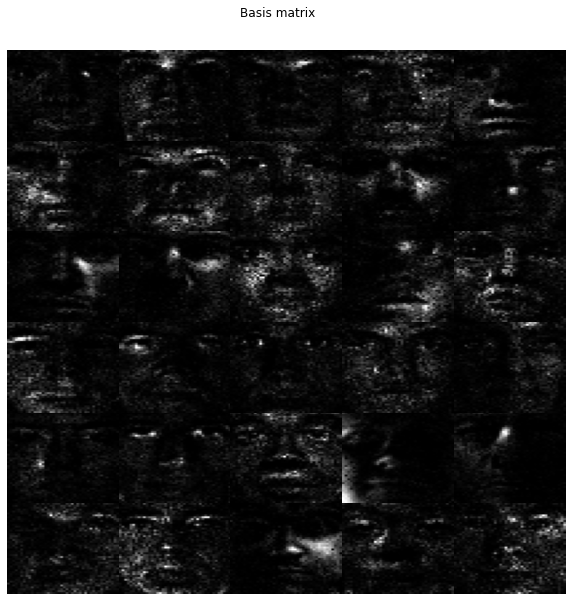

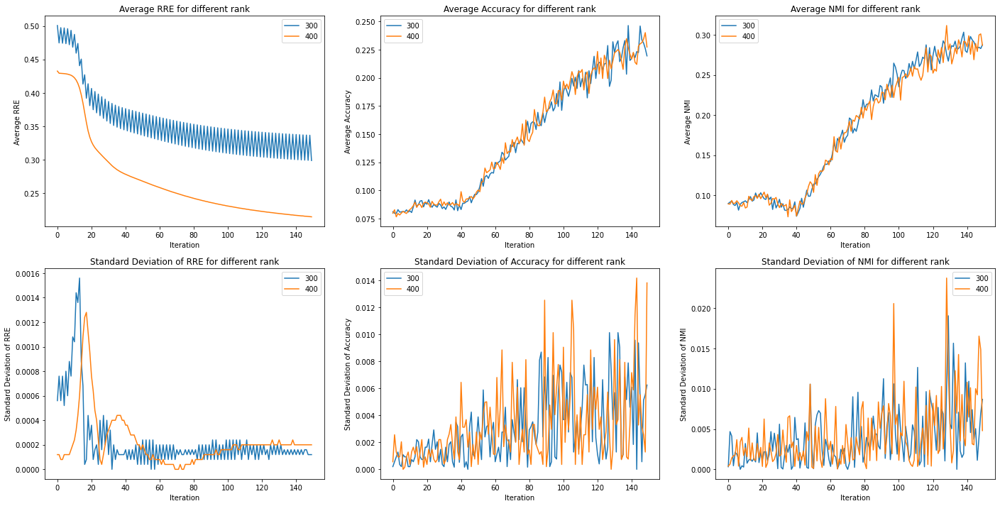

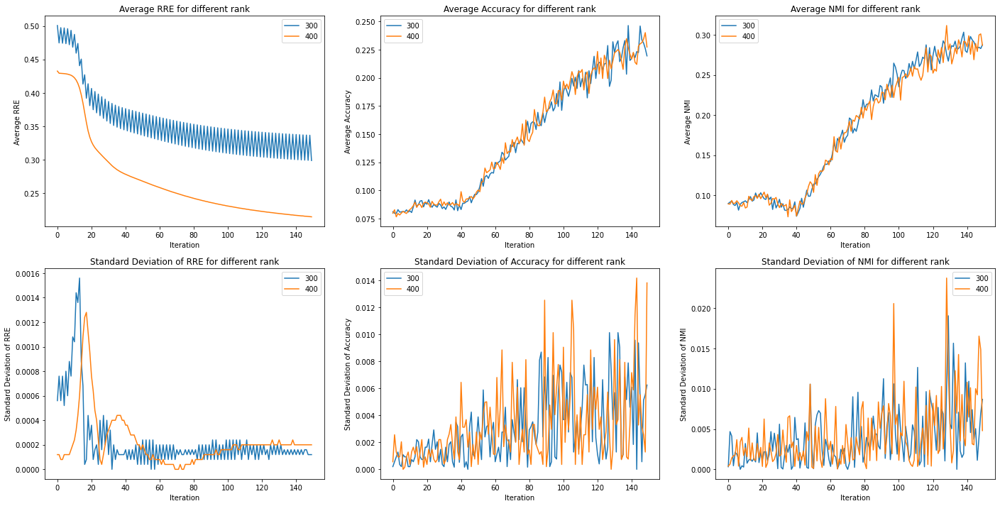

In [425]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "no-scaling"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = [300, 400]
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB

for index, rank in enumerate(RANK): 
    exp_params["key"] = str(rank)
    exp_params["rank"] = rank
    exp_params["image_title"] = "Image comparison for {}% {} noise and rank {}".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["rank"])
    D, R, eval_metrics = execute_experiment(X_YaleB, Y_YaleB, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/yaleb_l21_rank_variation.npy", eval_metrics)
plot_result(eval_metrics, "rank")
plot_result(eval_metrics, "rank")

##### 3.2.2.2 Factor Initialization Variation
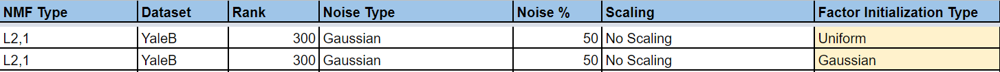

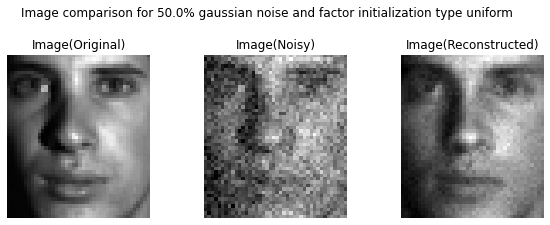

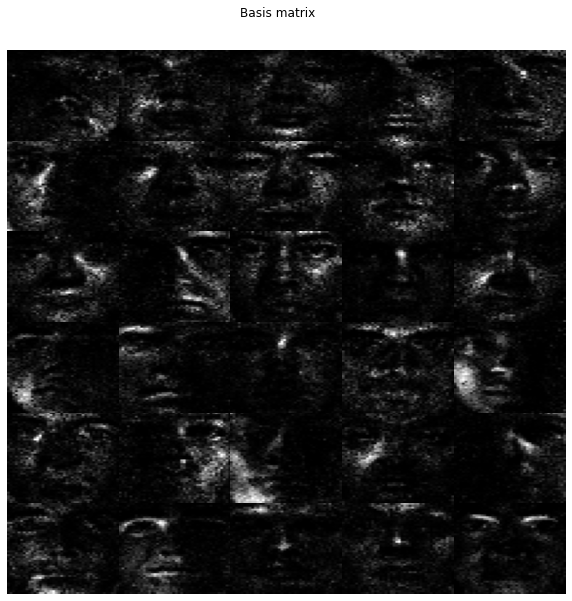

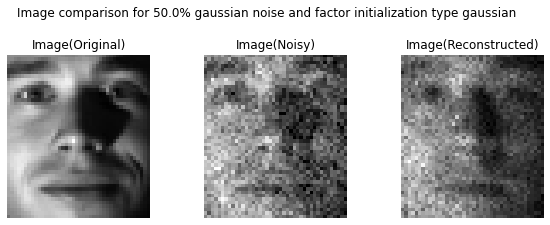

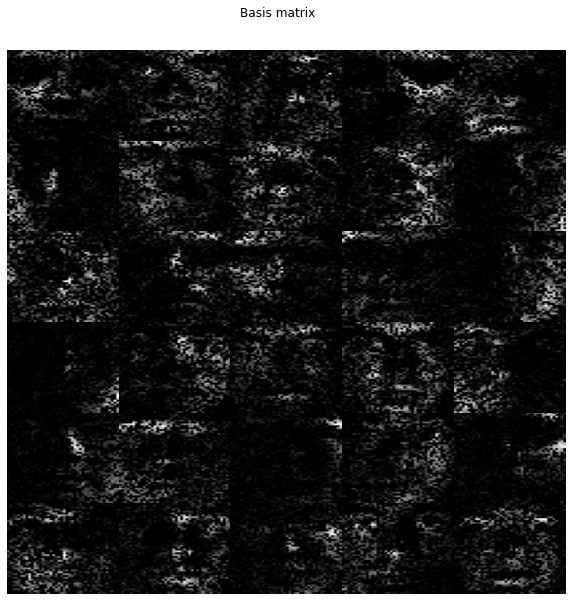

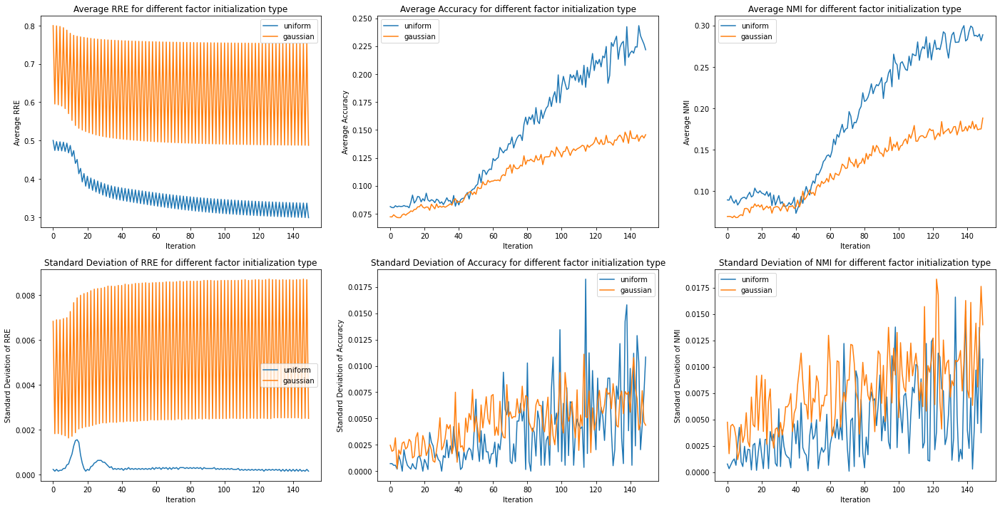

In [426]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = ["uniform", "gaussian"]

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "no-scaling"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 300
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["rank"] = RANK
exp_params["scaling_type"] = SCALING_TYPE
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB

for index, init_type in enumerate(FACTORS_INIT_TYPE): 
    exp_params["key"] = str(init_type)
    exp_params["factors_init_type"] = init_type
    exp_params["image_title"] = "Image comparison for {}% {} noise and factor initialization type {}".format(
                                                                     exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["factors_init_type"])
        
    D, R, eval_metrics = execute_experiment(X_YaleB, Y_YaleB, REPEAT, exp_params, eval_metrics)          

# Save result for future reference
save_result("result/yaleb_l21_factor_init.npy", eval_metrics)
plot_result(eval_metrics, "factor initialization type")

##### 3.2.2.3 Scaling Variation
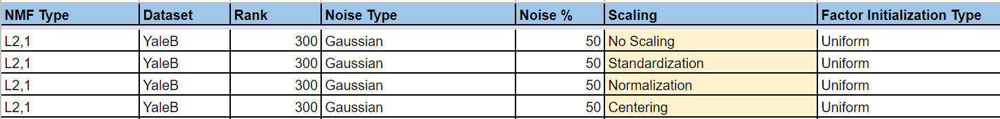

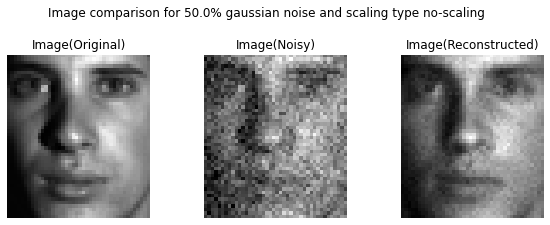

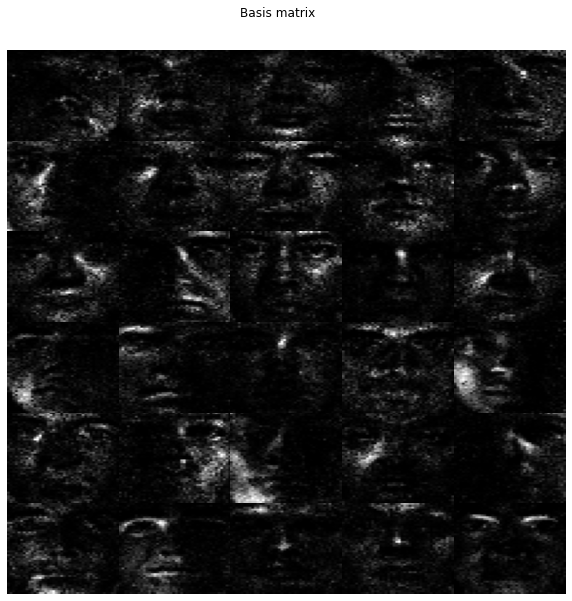

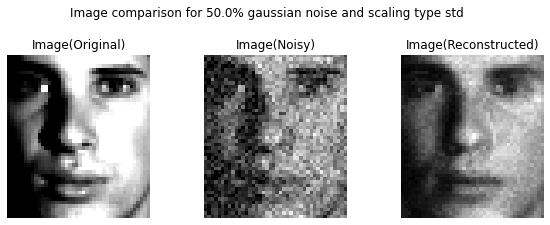

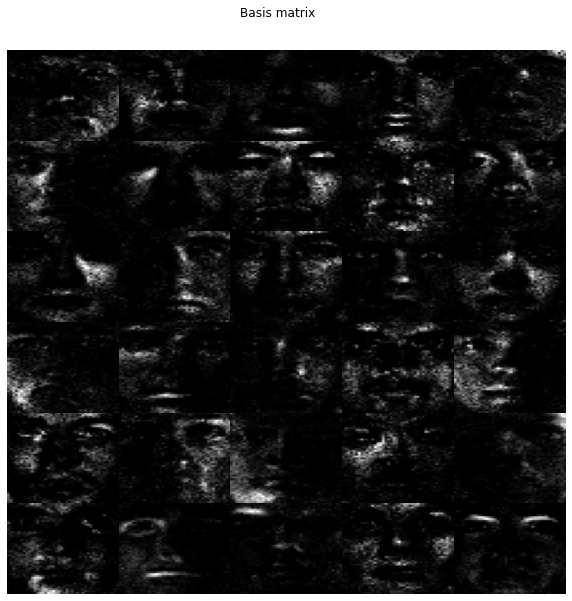

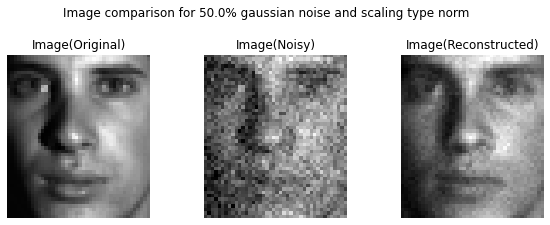

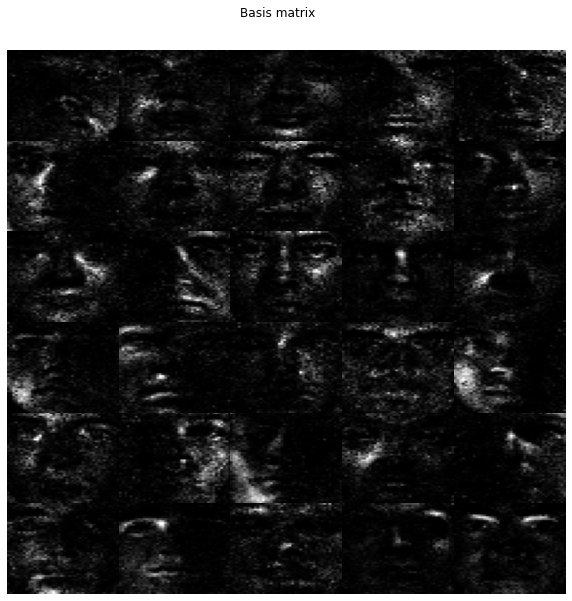

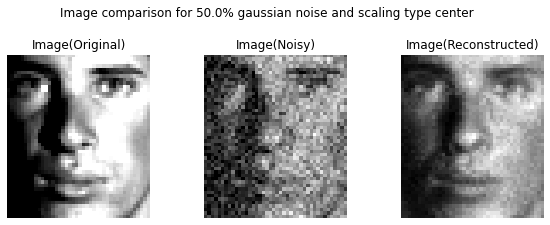

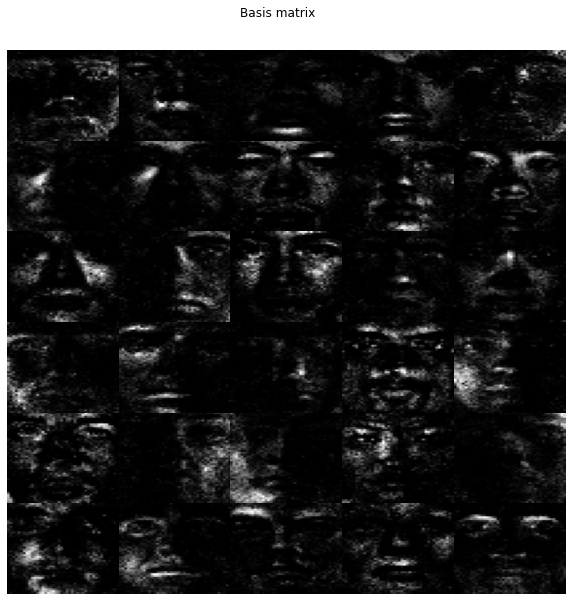

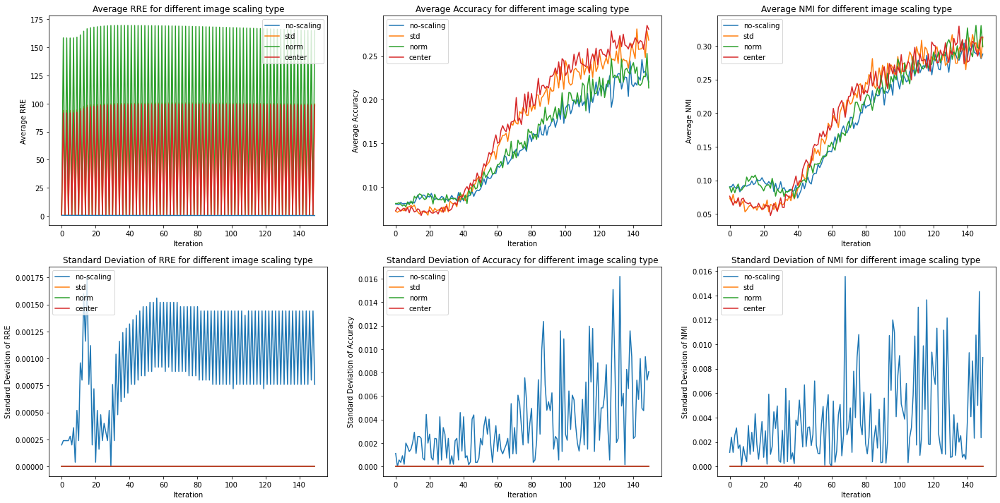

In [427]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = ["no-scaling", "std", "norm", "center"]

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 300
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["rank"] = RANK
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB

for index, scaling_type in enumerate(SCALING_TYPE): 
    exp_params["key"] = str(scaling_type)
    exp_params["scaling_type"] = scaling_type
    exp_params["image_title"] = "Image comparison for {}% {} noise and scaling type {}".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"],
                                                                     exp_params["scaling_type"])
    if scaling_type == "std":
        D, R, eval_metrics = execute_experiment(X_YaleB_Std, Y_YaleB, REPEAT, exp_params, eval_metrics)   
    elif scaling_type == "norm":
        D, R, eval_metrics = execute_experiment(X_YaleB_Norm, Y_YaleB, REPEAT, exp_params, eval_metrics)    
    elif scaling_type == "center":
        D, R, eval_metrics = execute_experiment(X_YaleB_Center, Y_YaleB, REPEAT, exp_params, eval_metrics)    
    else:
        D, R, eval_metrics = execute_experiment(X_YaleB, Y_YaleB, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/yaleb_l21_scaling_type.npy", eval_metrics)
plot_result(eval_metrics, "image scaling type")

##### 3.2.2.4 Noise Type Variation
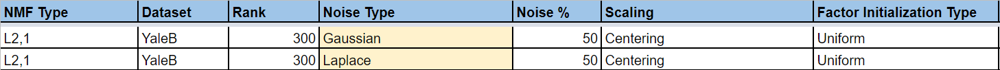

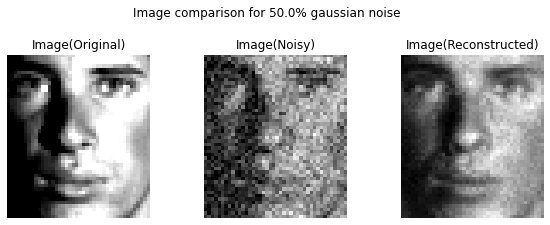

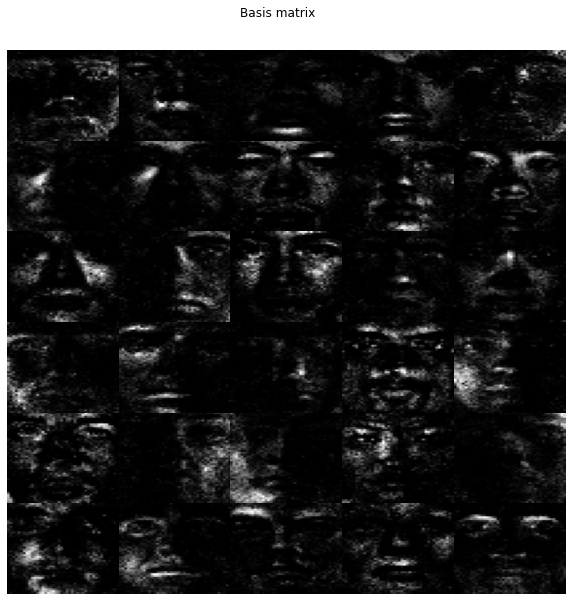

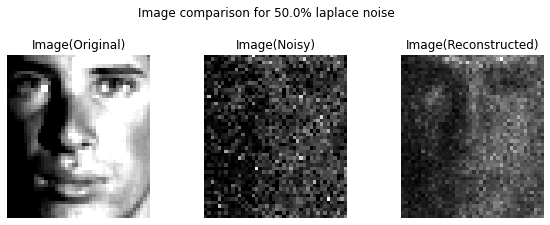

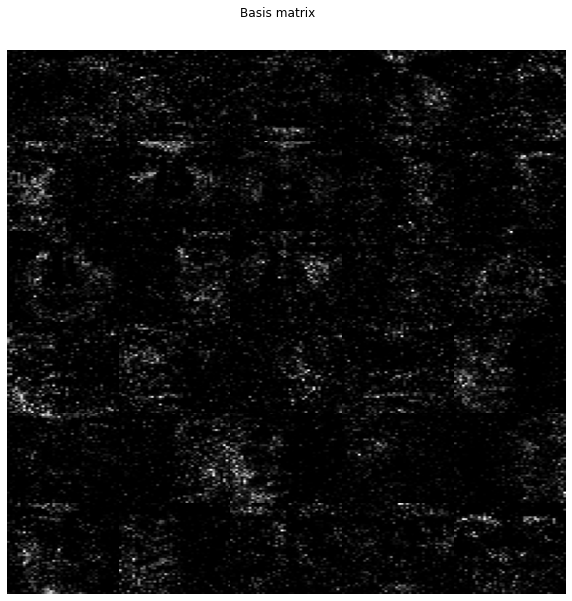

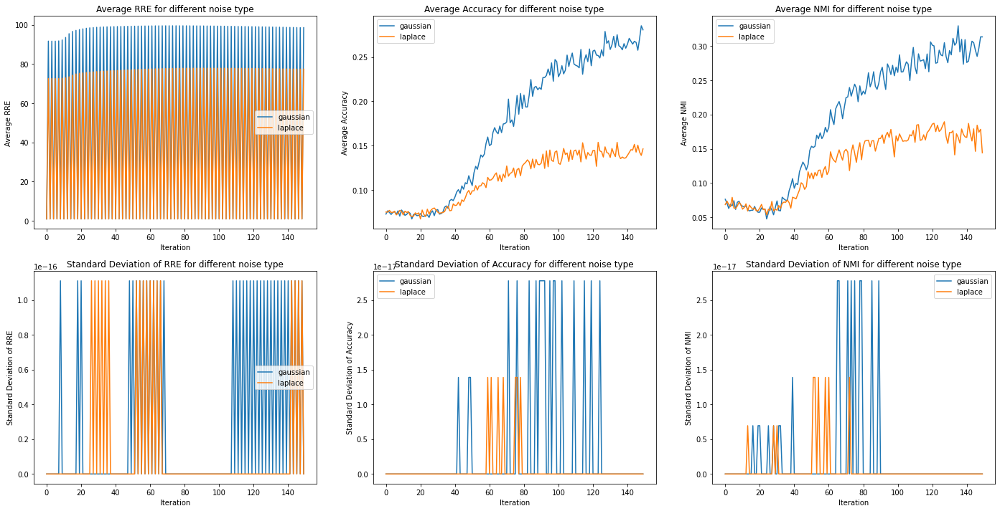

In [428]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = ["gaussian", "laplace"]

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "center"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = 0.50
RANK = 300
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise"] = NOISE_PERCENTAGE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["rank"] = RANK
exp_params["scaling_type"] = SCALING_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB

for index, noise_type in enumerate(NOISE_TYPE): 
    exp_params["key"] = str(noise_type)
    exp_params["noise_type"] = noise_type
    exp_params["image_title"] = "Image comparison for {}% {} noise".format(
                                                                     exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"])
        
    D, R, eval_metrics = execute_experiment(X_YaleB_Center, Y_YaleB, REPEAT, exp_params, eval_metrics)     
    
# Save result for future reference
save_result("result/yaleb_l21_noise_type.npy", eval_metrics)
plot_result(eval_metrics, "noise type")

##### 3.2.2.5 Noise Variation
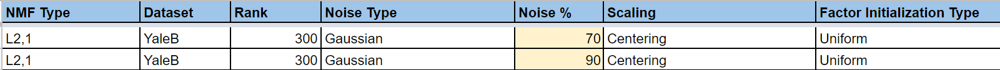

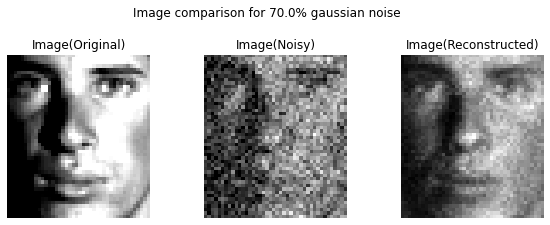

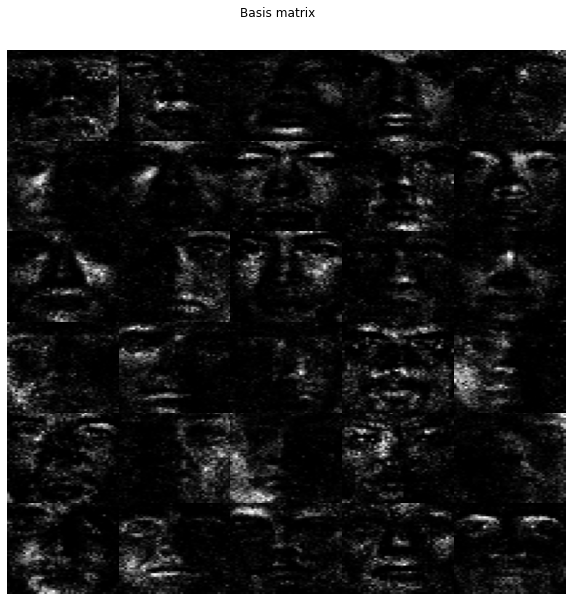

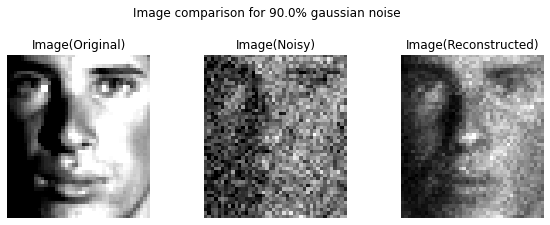

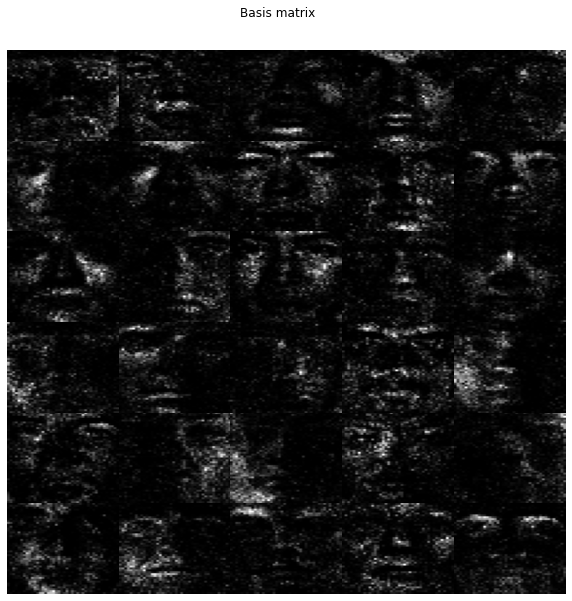

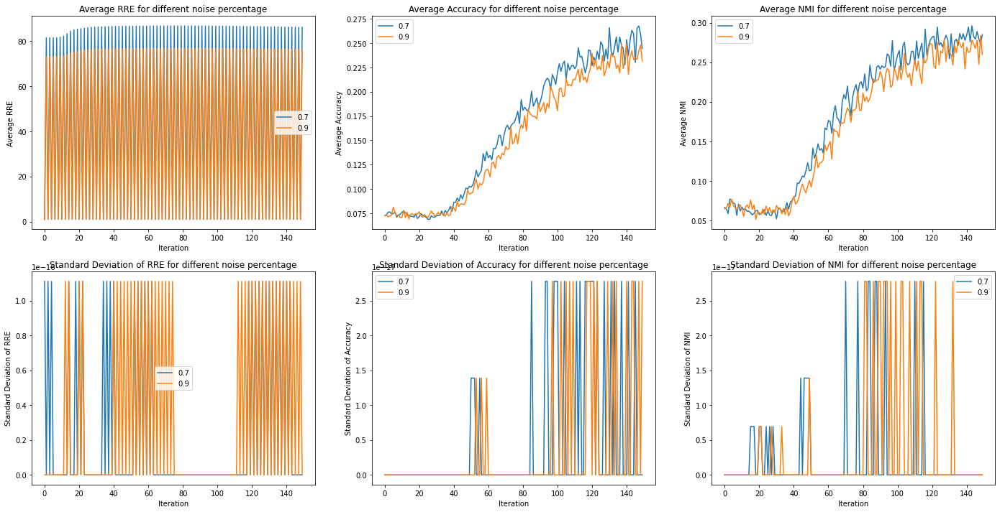

In [429]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = "l21"

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "center"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = [0.70, 0.90]
RANK = 300
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["rank"] = RANK
exp_params["nmf_type"] = NMF_TYPE
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB

for index, noise in enumerate(NOISE_PERCENTAGE):  
    exp_params["key"] = str(noise)
    exp_params["noise"] = noise
    exp_params["image_title"] = "Image comparison for {}% {} noise".format(exp_params["noise"] * 100, 
                                                                     exp_params["noise_type"])
    D, R, eval_metrics = execute_experiment(X_YaleB_Center, Y_YaleB, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/yaleb_l21_noise.npy", eval_metrics)
plot_result(eval_metrics, "noise percentage")

## 5. Additional Tests and Plots

### 5.1 ORL dataset Frobenius Vs L21 norm NMF

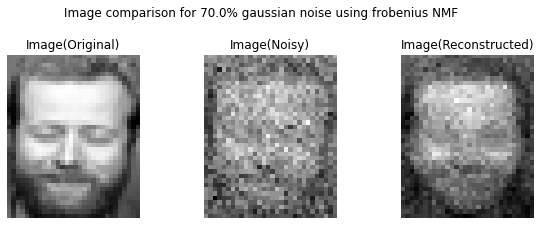

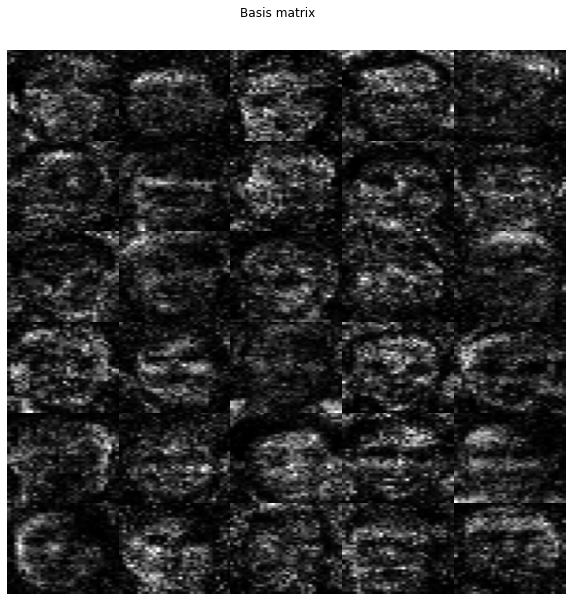

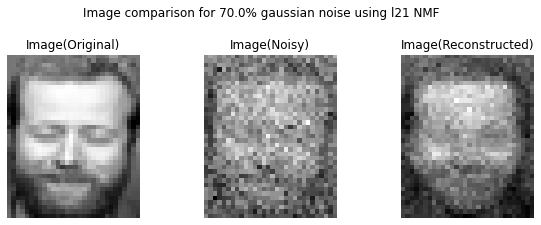

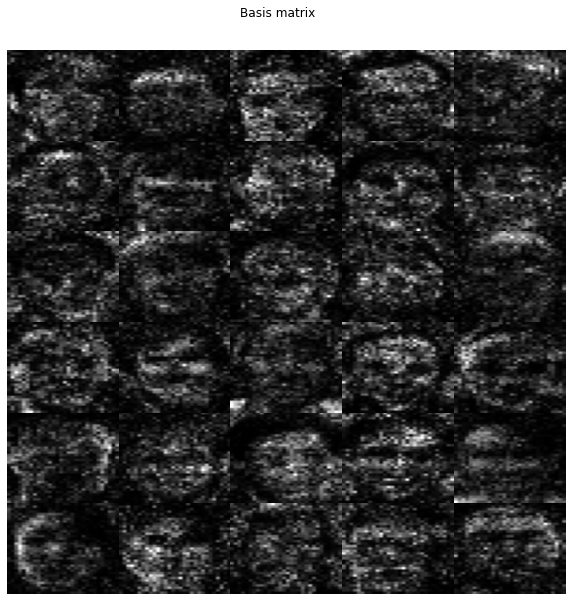

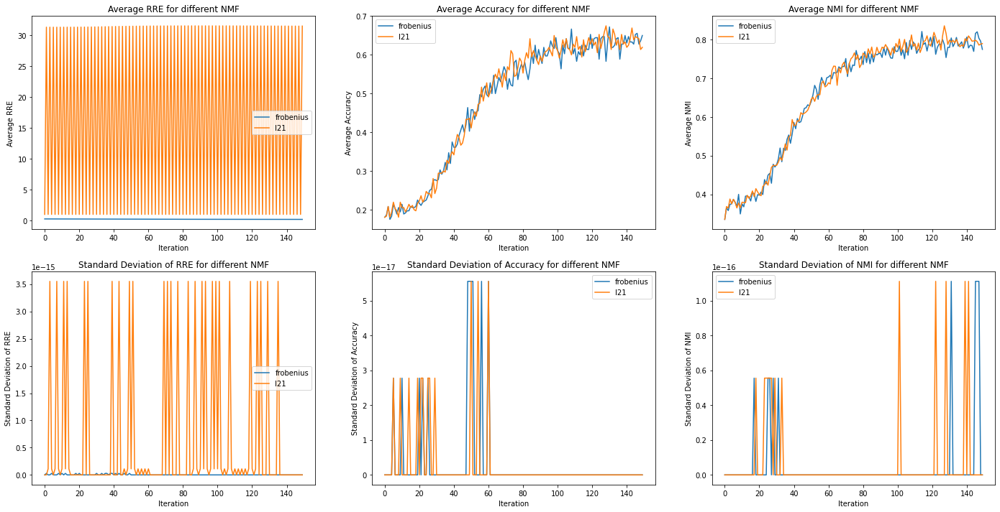

In [45]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = ["frobenius", "l21"]

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "norm"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = .70
RANK = 100
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["rank"] = RANK
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_ORL
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_ORL
exp_params["noise"] = NOISE_PERCENTAGE
for index, nmf_type in enumerate(NMF_TYPE):    
    exp_params["key"] = nmf_type
    exp_params["nmf_type"] = nmf_type
    exp_params["image_title"] = "Image comparison for {}% {} noise using {} NMF".format(exp_params["noise"] * 100, 
                                                                                        exp_params["noise_type"], 
                                                                                        exp_params["nmf_type"])
    D, R, eval_metrics = execute_experiment(X_ORL_Norm, Y_ORL, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/ORL_fro_l21.npy", eval_metrics)
plot_result(eval_metrics, "NMF")

### 5.2 YaleB dataset Frobenius Vs L21 norm NMF

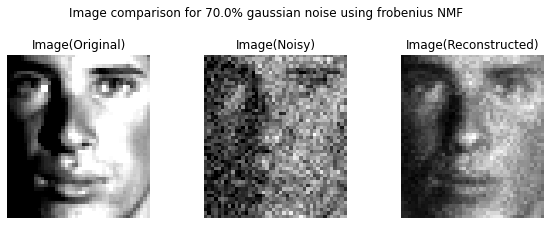

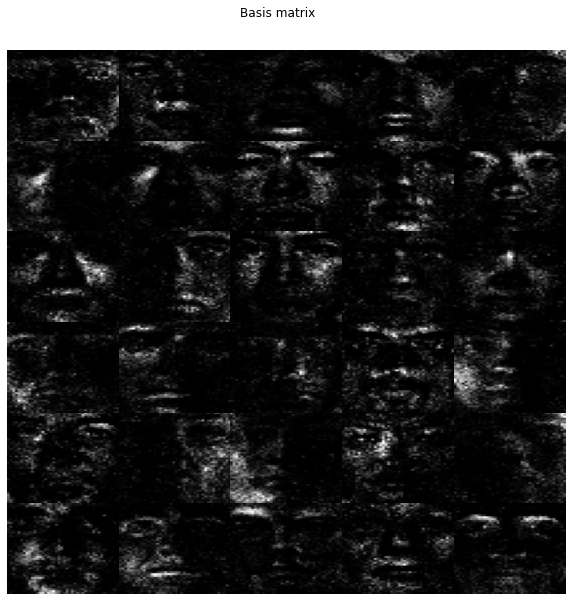

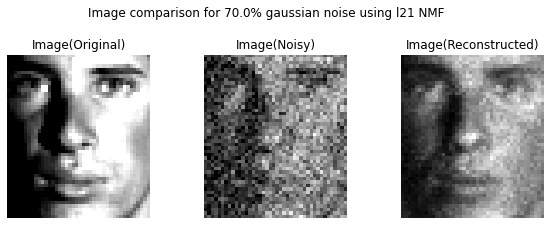

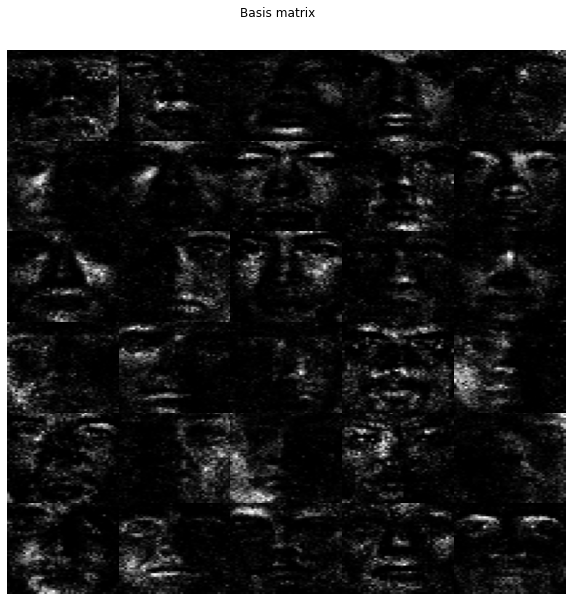

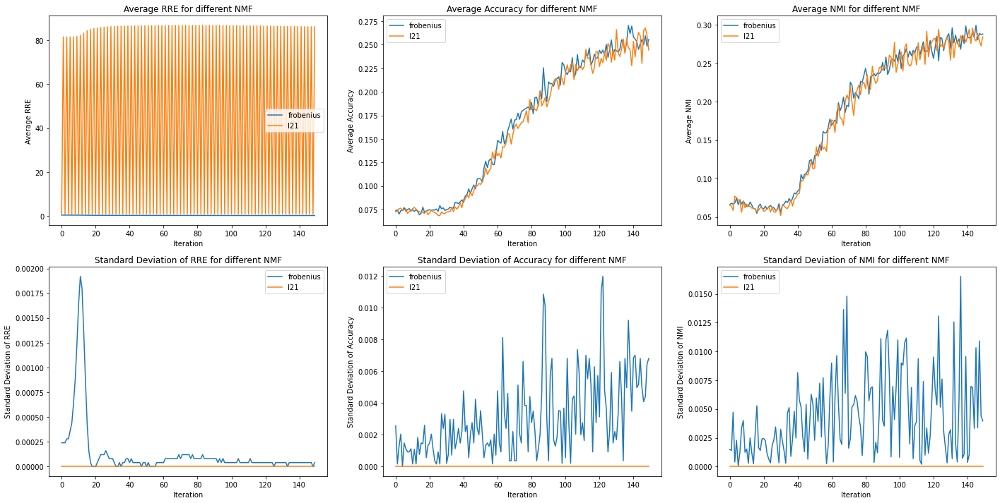

In [46]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = ["frobenius", "l21"]

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 150

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "center"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = .70
RANK = 300
REPEAT = 5

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["rank"] = RANK
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB
exp_params["noise"] = NOISE_PERCENTAGE
for index, nmf_type in enumerate(NMF_TYPE):    
    exp_params["key"] = nmf_type
    exp_params["nmf_type"] = nmf_type
    exp_params["image_title"] = "Image comparison for {}% {} noise using {} NMF".format(exp_params["noise"] * 100, 
                                                                                        exp_params["noise_type"], 
                                                                                        exp_params["nmf_type"])
    D, R, eval_metrics = execute_experiment(X_YaleB_Center, Y_YaleB, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
save_result("result/YaleB_fro_l21.npy", eval_metrics)
plot_result(eval_metrics, "NMF")

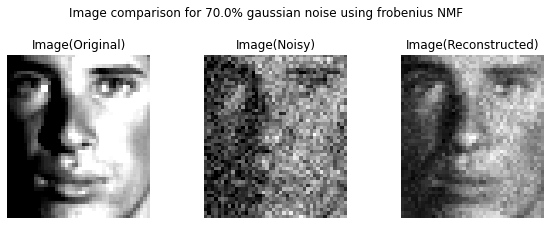

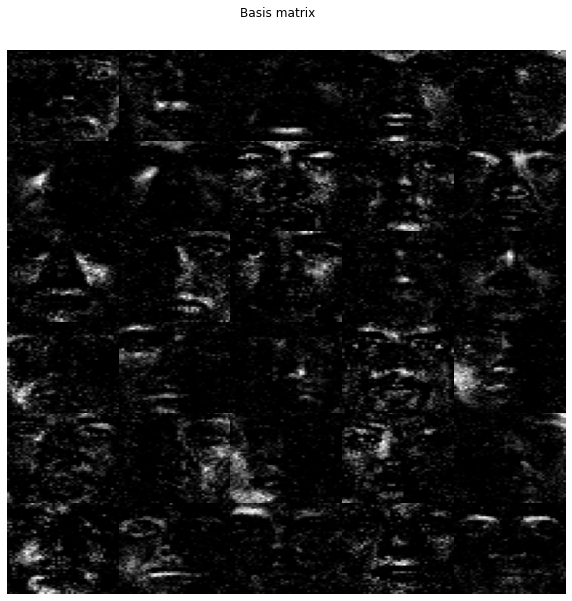

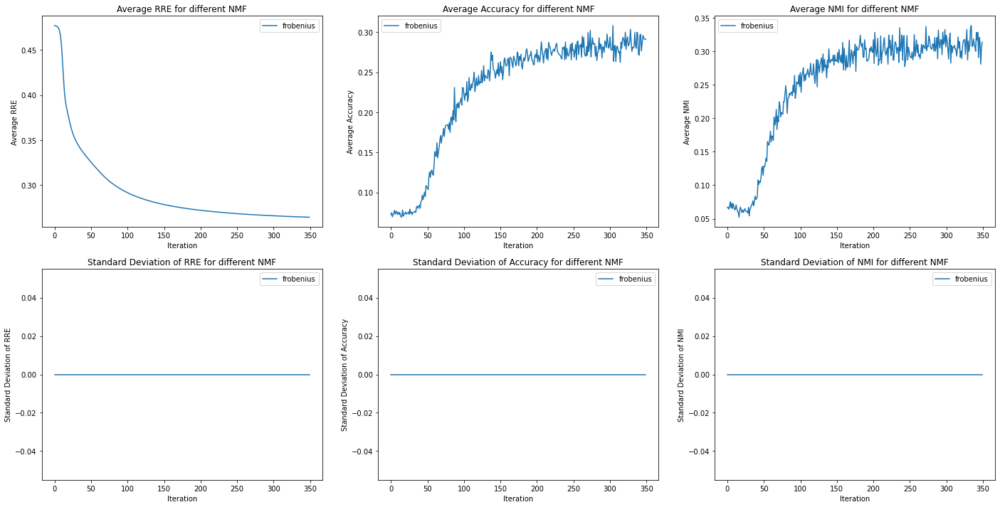

In [47]:
# Setup Parameters
# Possible values for NMF_TYPE are "frobenius" and "l21"
NMF_TYPE = ["frobenius"]

# Possible values for NOISE_TYPE are "gaussian", "laplace" and "impulse"
NOISE_TYPE = "gaussian"

# Possible values for FACTORS_INIT_TYPE are "gaussian" and "uniform"
FACTORS_INIT_TYPE = "uniform"

#TODO: Update it to a higher number after test runs
MAX_ITERATION = 350

# Possible values for FACTORS_INIT_TYPE are "no-scaling", "std", "norm", "center"
SCALING_TYPE = "center"

# Noise percentage = 0 means no noise and 1 means 100% noise in the image.
NOISE_PERCENTAGE = .70
RANK = 300
REPEAT = 1

eval_metrics = {}
exp_params = {}
exp_params["max_iteration"] = MAX_ITERATION
exp_params["rank"] = RANK
exp_params["noise_type"] = NOISE_TYPE
exp_params["factors_init_type"] = FACTORS_INIT_TYPE
exp_params["scaling_type"] = SCALING_TYPE
exp_params["reduced_image_size"] = REDUCED_IMAGE_SIZE_YALEB
exp_params["coeff_image_size"] = COEFFICIENT_SIZE_YALEB
exp_params["noise"] = NOISE_PERCENTAGE
for index, nmf_type in enumerate(NMF_TYPE):    
    exp_params["key"] = nmf_type
    exp_params["nmf_type"] = nmf_type
    exp_params["image_title"] = "Image comparison for {}% {} noise using {} NMF".format(exp_params["noise"] * 100, 
                                                                                        exp_params["noise_type"], 
                                                                                        exp_params["nmf_type"])
    D, R, eval_metrics = execute_experiment(X_YaleB_Center, Y_YaleB, REPEAT, exp_params, eval_metrics)    

# Save result for future reference
#save_result("result/YaleB_fro_l21.npy", eval_metrics)
plot_result(eval_metrics, "NMF")

### 5.3 Load data from previous section's experiments for further analysis

In [48]:
#load all results from the various experiments to plot more comparative graphs and analyse the result
# DONOT Execute the code as the result files have not been provided in the submission. It can be provided if needed.

orl_fro_rank_variation = load_result("result/orl_fro_rank_variation.npy")
orl_fro_factor_init = load_result("result/orl_fro_factor_init.npy")
orl_fro_scaling_type = load_result("result/orl_fro_scaling_type.npy")
orl_fro_noise_type = load_result("result/orl_fro_noise_type.npy")
orl_fro_noise = load_result("result/orl_fro_noise.npy")

orl_l21_rank_variation = load_result("result/orl_l21_rank_variation.npy")
orl_l21_factor_init = load_result("result/orl_l21_factor_init.npy")
orl_l21_scaling_type = load_result("result/orl_l21_scaling_type.npy")
orl_l21_noise_type = load_result("result/orl_l21_noise_type.npy")
orl_l21_noise = load_result("result/orl_l21_noise.npy")

yaleb_fro_rank_variation = load_result("result/yaleb_fro_rank_variation.npy")
yaleb_fro_factor_init = load_result("result/yaleb_fro_factor_init.npy")
yaleb_fro_scaling_type = load_result("result/yaleb_fro_scaling_type.npy")
yaleb_fro_noise_type = load_result("result/yaleb_fro_noise_type.npy")
yaleb_fro_noise = load_result("result/yaleb_fro_noise.npy")

yaleb_l21_rank_variation = load_result("result/yaleb_l21_rank_variation.npy")
yaleb_l21_factor_init = load_result("result/yaleb_l21_factor_init.npy")
yaleb_l21_scaling_type = load_result("result/yaleb_l21_scaling_type.npy")
yaleb_l21_noise_type = load_result("result/yaleb_l21_noise_type.npy")
yaleb_l21_noise = load_result("result/yaleb_l21_noise.npy")

orl_fro_l21 = load_result("result/ORL_fro_l21.npy")
yaleB_fro_l21 = load_result("result/YaleB_fro_l21.npy")

In [55]:
orl_frobenius_mean_rre = np.array(orl_fro_l21["frobenius_mean_rre"])
orl_frobenius_mean_acc = np.array(orl_fro_l21["frobenius_mean_avg_acc"])
orl_frobenius_mean_nmi = np.array(orl_fro_l21["frobenius_mean_nmi"])

orl_l21_mean_rre = np.array(orl_fro_l21["l21_mean_rre"])
orl_l21_mean_acc = np.array(orl_fro_l21["l21_mean_avg_acc"])
orl_l21_mean_nmi = np.array(orl_fro_l21["l21_mean_nmi"])

print(np.max(orl_frobenius_mean_rre))
print(np.min(orl_frobenius_mean_rre))

print(np.max(orl_frobenius_mean_acc))
print(np.min(orl_frobenius_mean_acc))

print(np.max(orl_frobenius_mean_nmi))
print(np.min(orl_frobenius_mean_nmi))

print(np.max(orl_l21_mean_rre))
print(np.min(orl_l21_mean_rre))

print(np.max(orl_l21_mean_acc))
print(np.min(orl_l21_mean_acc))

print(np.max(orl_l21_mean_nmi))
print(np.min(orl_l21_mean_nmi))

0.2374
0.1634
0.6722
0.175
0.8205
0.3355
31.500700000000002
0.9704
0.675
0.1806
0.8351
0.3355


In [56]:
yaleB_frobenius_mean_rre = np.array(yaleB_fro_l21["frobenius_mean_rre"])
yaleB_frobenius_mean_acc = np.array(yaleB_fro_l21["frobenius_mean_avg_acc"])
yaleB_frobenius_mean_nmi = np.array(yaleB_fro_l21["frobenius_mean_nmi"])

yaleB_l21_mean_rre = np.array(yaleB_fro_l21["l21_mean_rre"])
yaleB_l21_mean_acc = np.array(yaleB_fro_l21["l21_mean_avg_acc"])
yaleB_l21_mean_nmi = np.array(yaleB_fro_l21["l21_mean_nmi"])

print(np.max(yaleB_frobenius_mean_rre))
print(np.min(yaleB_frobenius_mean_rre))

print(np.max(yaleB_frobenius_mean_acc))
print(np.min(yaleB_frobenius_mean_acc))

print(np.max(yaleB_frobenius_mean_nmi))
print(np.min(yaleB_frobenius_mean_nmi))

print(np.max(yaleB_l21_mean_rre))
print(np.min(yaleB_l21_mean_rre))

print(np.max(yaleB_l21_mean_acc))
print(np.min(yaleB_l21_mean_acc))

print(np.max(yaleB_l21_mean_nmi))
print(np.min(yaleB_l21_mean_nmi))

0.47732
0.27842
0.27059999999999995
0.06938000000000001
0.29956
0.05484
86.7607
0.9898
0.2678
0.0686
0.296
0.0519


## References

https://www.geeksforgeeks.org/how-to-print-exception-stack-trace-in-python/
https://numpy.org/doc/stable/reference/generated/numpy.unique.html
https://matplotlib.org/stable/gallery/lines_bars_and_markers/bar_label_demo.html
https://stackoverflow.com/questions/7526625/matplotlib-global-legend-and-title-aside-subplots
https://stackoverflow.com/questions/7526625/matplotlib-global-legend-and-title-aside-subplots
https://stackoverflow.com/questions/37973674/matplotlib-pyplot-imshow-tight-spacing-between-images
https://machinelearningmastery.com/how-to-manually-scale-image-pixel-data-for-deep-learning/
https://numpy.org/doc/stable/reference/random/generated/numpy.random.choice.html
https://arxiv.org/ftp/arxiv/papers/1505/1505.03489.pdf
https://numpy.org/doc/stable/reference/random/generated/numpy.random.Generator.normal.html#numpy.random.Generator.normal
https://numpy.org/doc/stable/reference/random/generated/numpy.random.Generator.laplace.html#numpy.random.Generator.laplace
https://numpy.org/doc/stable/reference/random/generator.html#numpy.random.default_rng
https://stackoverflow.com/questions/64074698/how-to-add-5-gaussian-noise-to-the-signal-data
https://arxiv.org/pdf/1711.02037.pdf
https://dl-acm-org.ezproxy.library.sydney.edu.au/doi/pdf/10.1145/2063576.2063676
https://stackoverflow.com/questions/19201290/how-to-save-a-dictionary-to-a-file/32216025
